# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [5]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting .\MNIST\raw\train-images-idx3-ubyte.gz to .\MNIST\raw


Extracting .\MNIST\raw\train-labels-idx1-ubyte.gz to .\MNIST\raw


Extracting .\MNIST\raw\t10k-images-idx3-ubyte.gz to .\MNIST\raw


Extracting .\MNIST\raw\t10k-labels-idx1-ubyte.gz to .\MNIST\raw
Processing...
Done!


..\torch\csrc\utils\tensor_numpy.cpp:141: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program.


Then, you can initialize your generator, critic, and optimizers.

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [9]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [10]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [13]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)*(gradient_norm - 1)) # or torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [14]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [23]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = torch.neg(torch.mean(crit_fake_pred))
    #### END CODE HERE ####
    return gen_loss

In [24]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)),
    torch.tensor(-1.0)
)
print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [33]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [34]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](https://drive.google.com/uc?id=1Tct8CPqVM5nUrHvA864ntv76XHZKqKUK&export=view)

Step 50: Generator loss: 0.006875299485400319, critic loss: 1.576175030767917


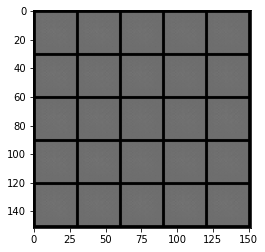

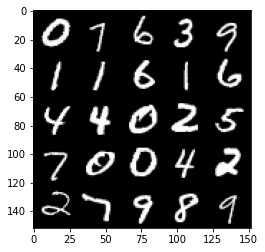

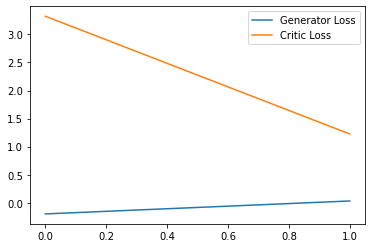

Step 100: Generator loss: 2.879578961133957, critic loss: -5.934837502241135


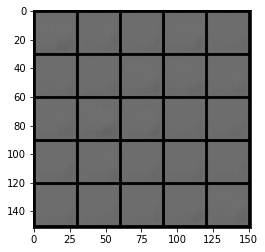

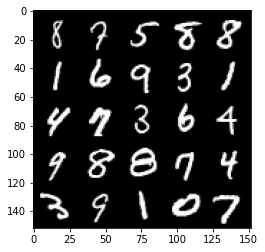

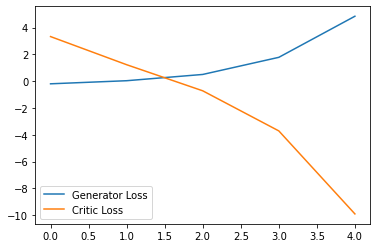

Step 150: Generator loss: 2.5738641905784605, critic loss: -18.120289691925052


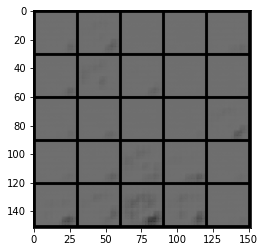

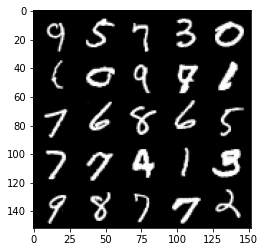

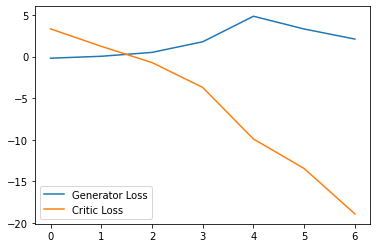

Step 200: Generator loss: 2.65179101228714, critic loss: -39.9533897857666


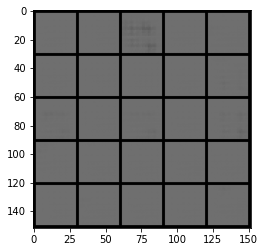

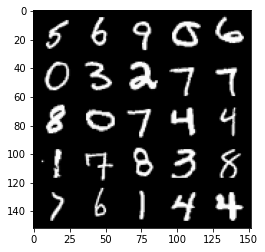

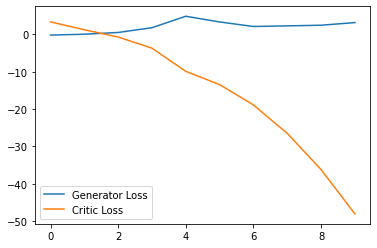

Step 250: Generator loss: 2.74294682264328, critic loss: -72.94198365783691


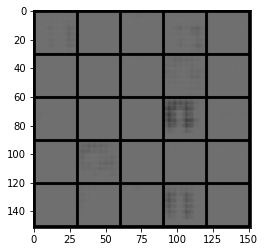

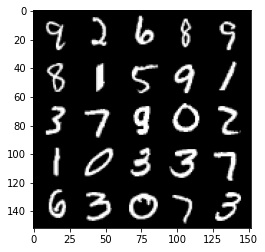

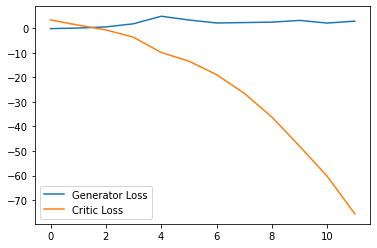

Step 300: Generator loss: 4.749576325416565, critic loss: -117.27713220214844


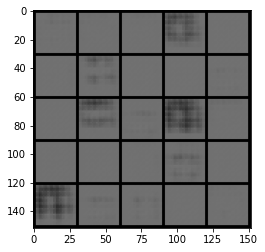

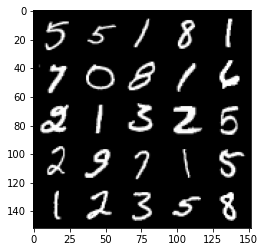

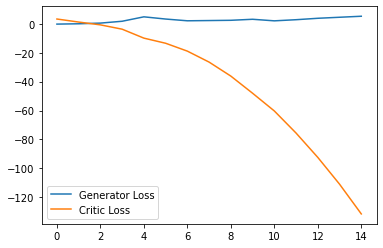

Step 350: Generator loss: 7.187830667495728, critic loss: -167.52203041076663


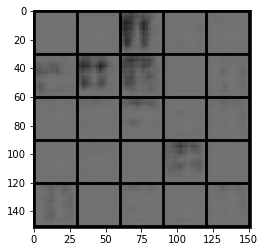

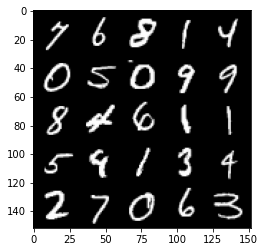

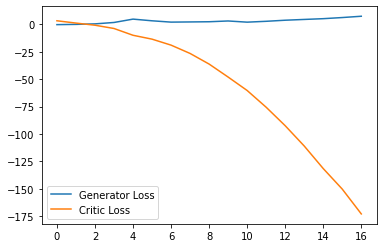

Step 400: Generator loss: 10.328143882751466, critic loss: -226.12703277587892


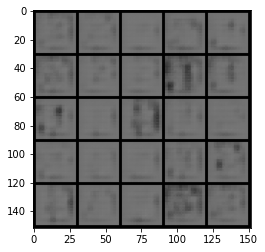

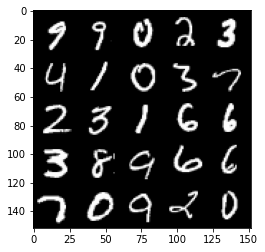

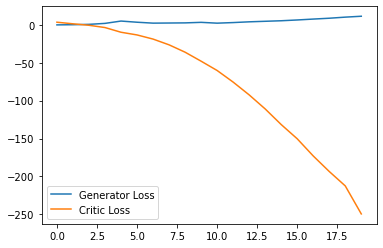

Step 450: Generator loss: 11.881241455078126, critic loss: -270.0305515289307


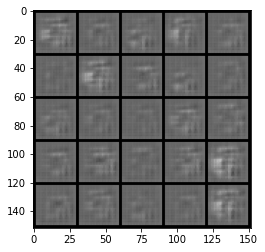

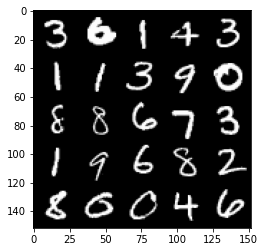

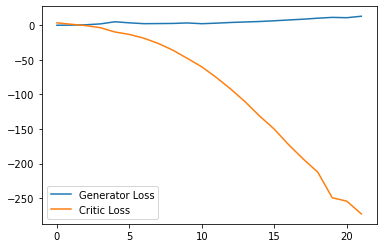

Step 500: Generator loss: 3.1734978953003883, critic loss: -297.13136370849605


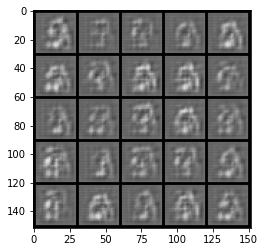

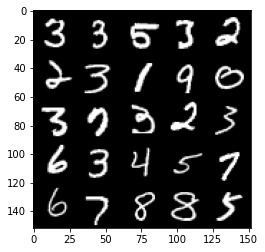

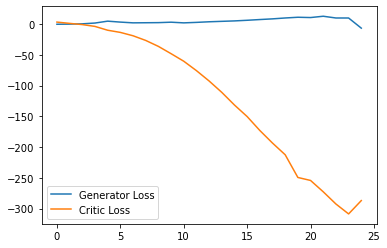

Step 550: Generator loss: 2.6339824390411377, critic loss: -350.6821748046876


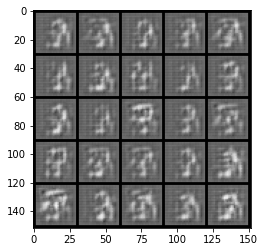

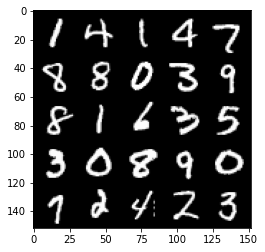

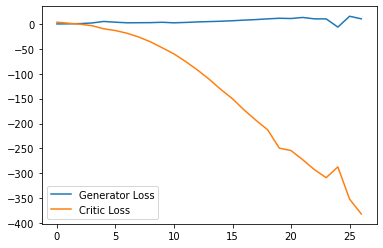

Step 600: Generator loss: -28.936474053859712, critic loss: -276.48051016235354


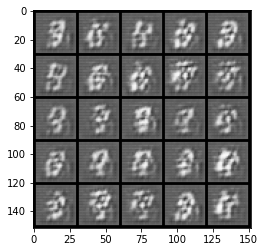

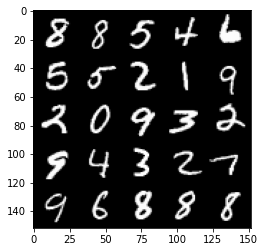

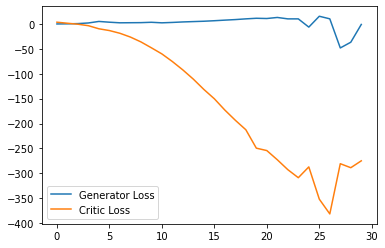

Step 650: Generator loss: -23.690113976299763, critic loss: -250.7433768005372


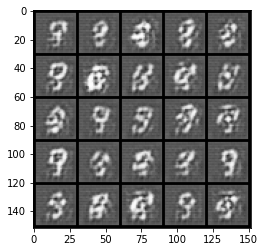

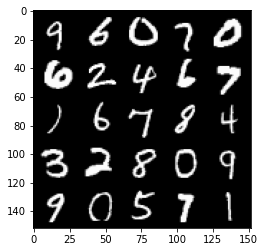

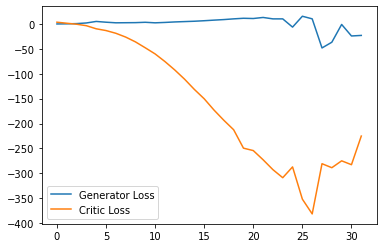

Step 700: Generator loss: -12.800446797609329, critic loss: -224.37523852539064


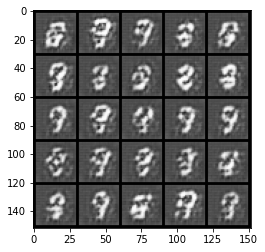

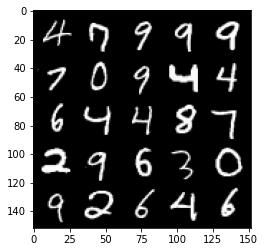

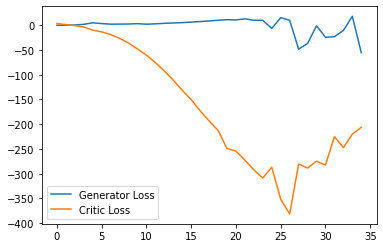

Step 750: Generator loss: -14.321875321865082, critic loss: -242.31254183959965


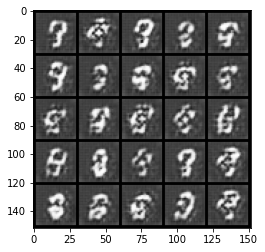

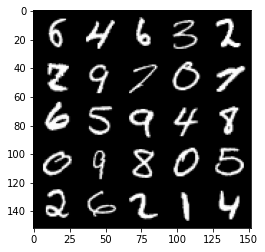

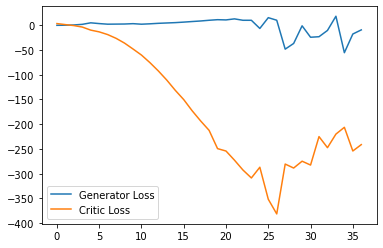

Step 800: Generator loss: 7.654787521362305, critic loss: -7.996728361129767


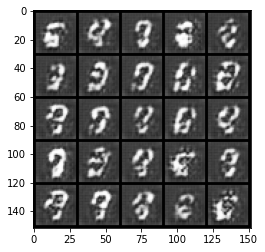

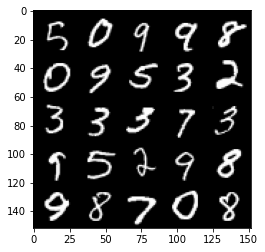

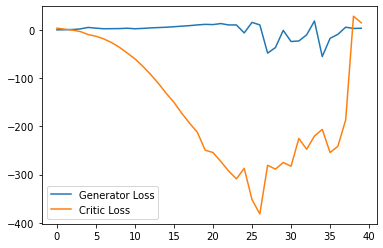

Step 850: Generator loss: 2.6791889345645905, critic loss: 8.333774551391603


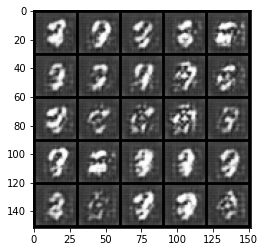

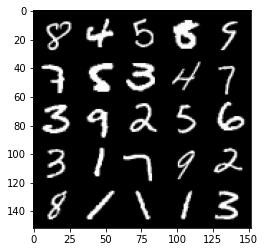

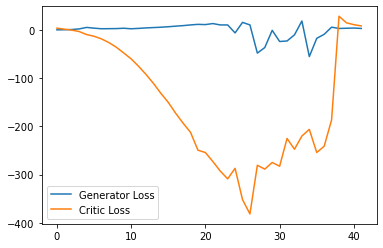

Step 900: Generator loss: -0.965781120955944, critic loss: 3.32324892616272


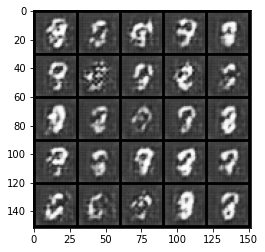

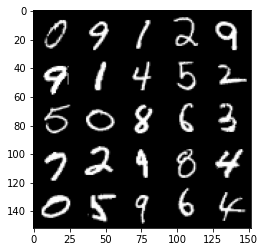

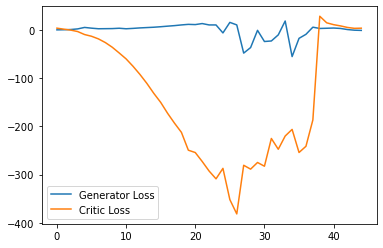

Step 950: Generator loss: -1.2290336291491986, critic loss: 5.565825593948364


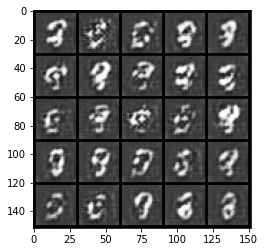

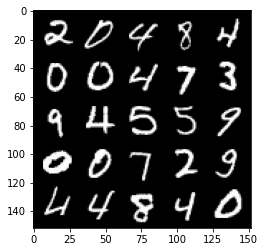

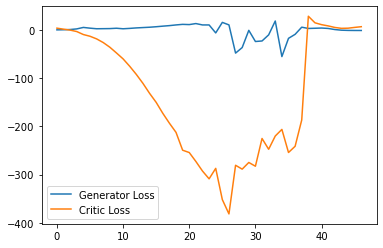

Step 1000: Generator loss: -1.5220969086885452, critic loss: 4.011825744628905


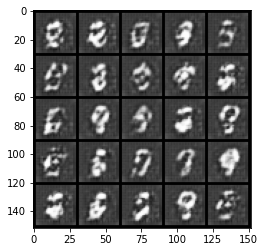

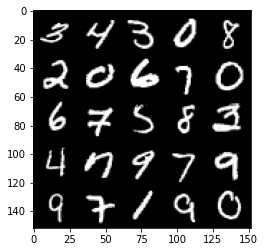

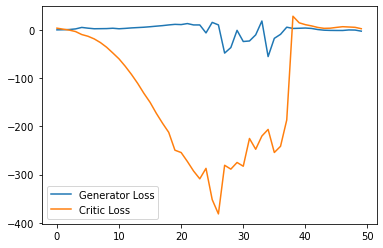

Step 1050: Generator loss: -5.411156396865845, critic loss: -2.0532489280700683


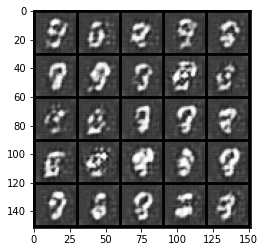

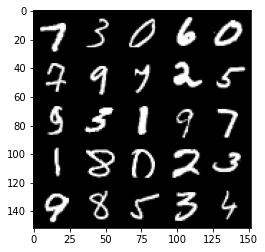

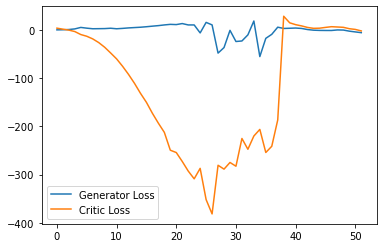

Step 1100: Generator loss: -6.185167371630668, critic loss: -12.646965232849123


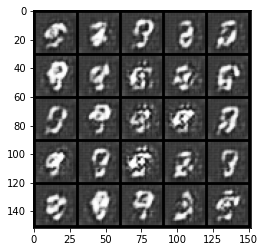

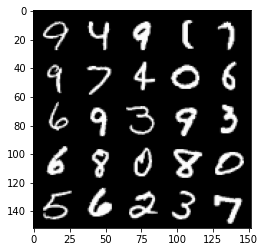

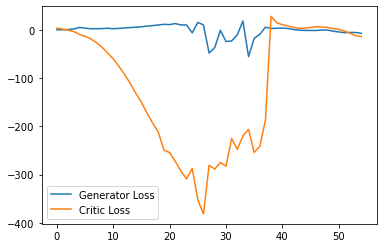

Step 1150: Generator loss: -6.968184809088707, critic loss: -18.071689453125


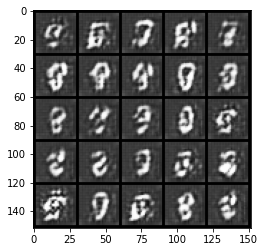

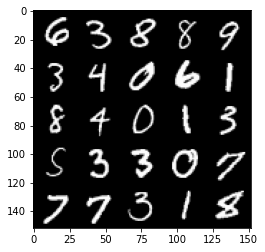

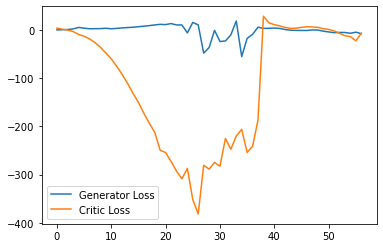

Step 1200: Generator loss: -4.97563874989748, critic loss: -36.815529167175285


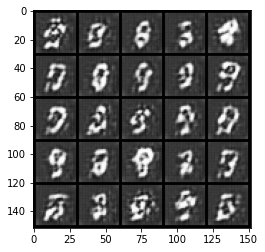

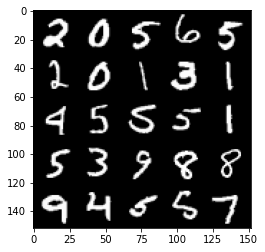

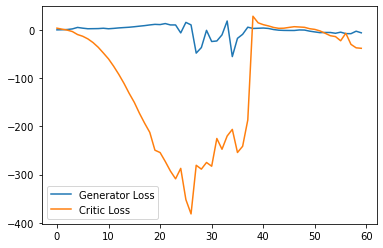

Step 1250: Generator loss: -6.659504275918007, critic loss: -35.331152576446534


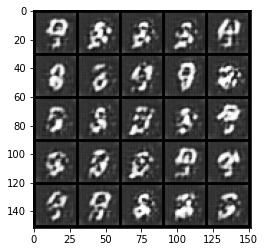

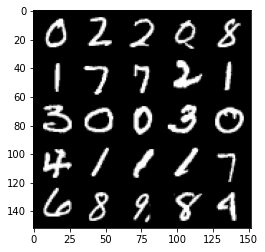

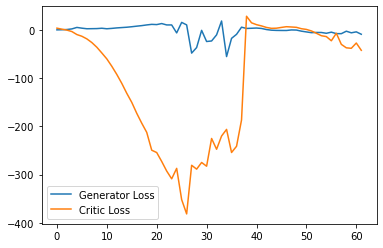

Step 1300: Generator loss: -2.152118462920189, critic loss: -42.62820557403564


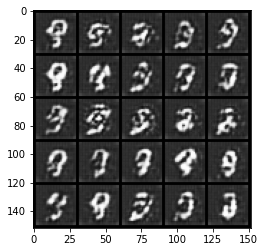

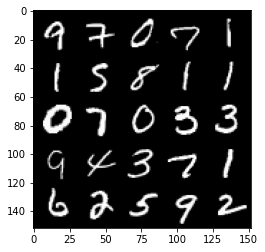

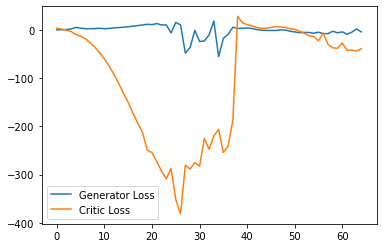

Step 1350: Generator loss: 4.0142209601402286, critic loss: 13.226212814331053


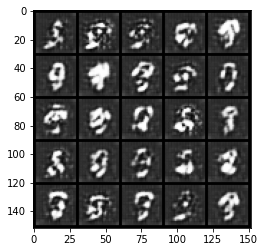

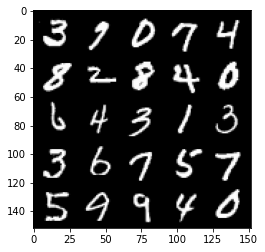

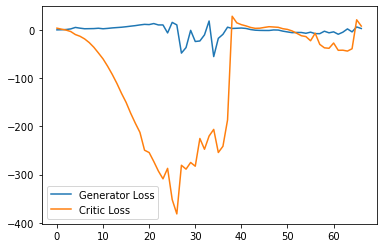

Step 1400: Generator loss: 2.8872747015953064, critic loss: 3.656259178161622


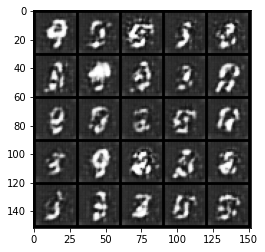

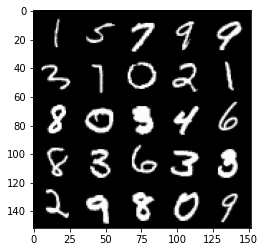

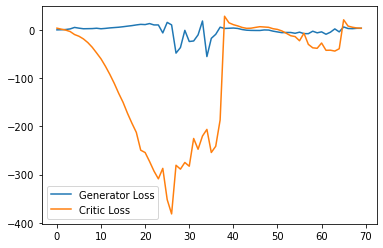

Step 1450: Generator loss: 2.6131232142448426, critic loss: -0.1378201713562011


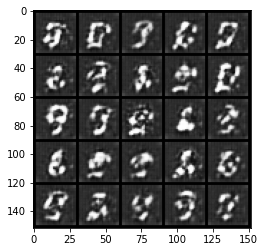

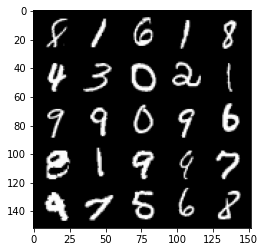

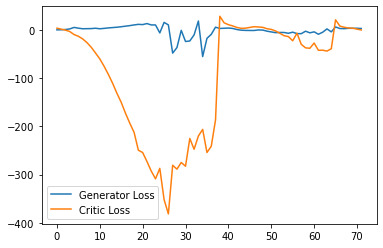

Step 1500: Generator loss: -2.2103439700603484, critic loss: -11.495772949218752


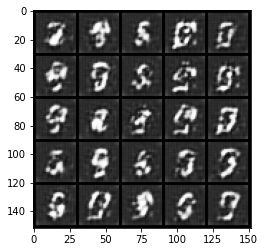

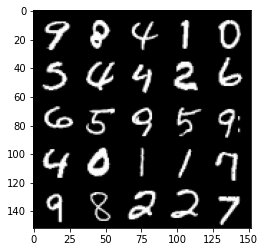

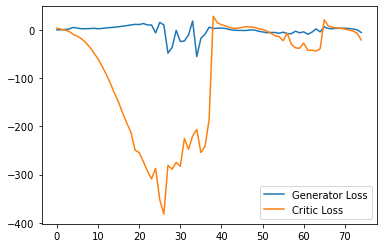

Step 1550: Generator loss: -14.077336192429065, critic loss: -32.917191322326666


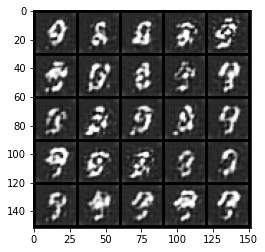

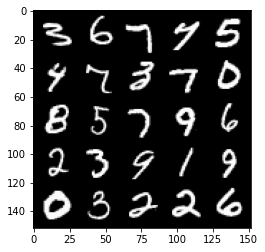

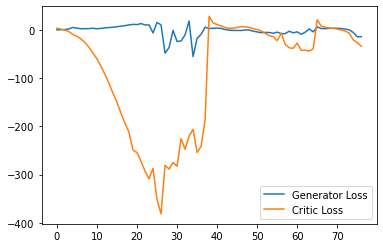

Step 1600: Generator loss: -5.438607453107834, critic loss: -25.78563716506957


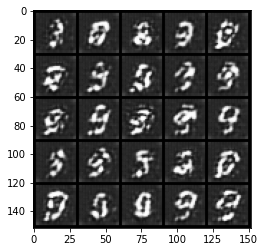

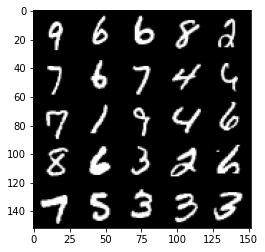

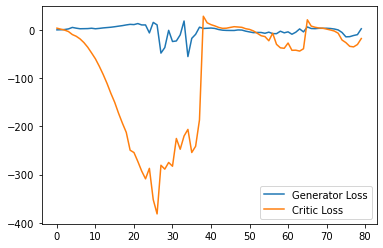

Step 1650: Generator loss: 0.9512471336126328, critic loss: -27.824086013793945


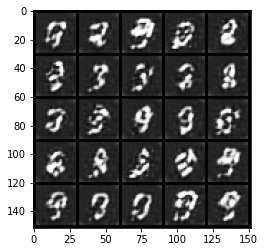

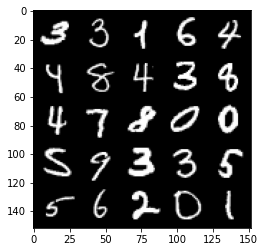

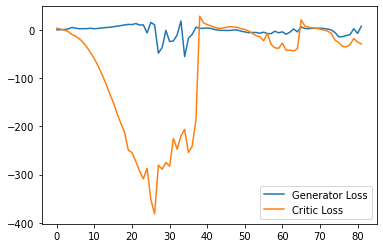

Step 1700: Generator loss: 2.8900625896453858, critic loss: -16.586524850845336


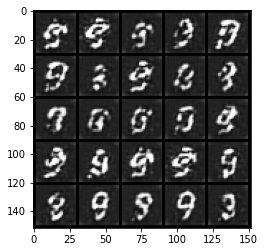

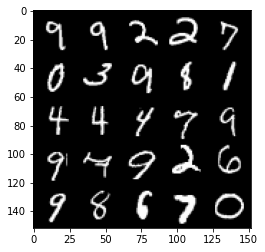

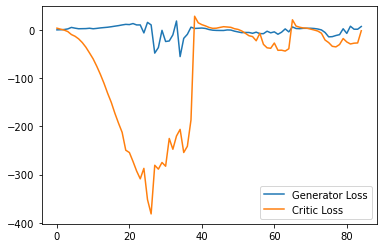

Step 1750: Generator loss: 11.878195133209228, critic loss: 0.7799650192260742


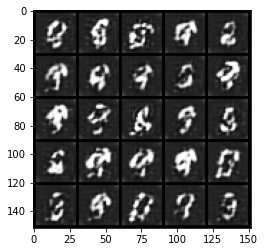

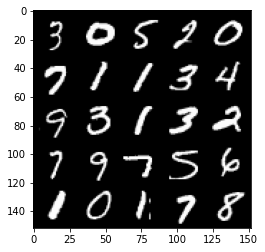

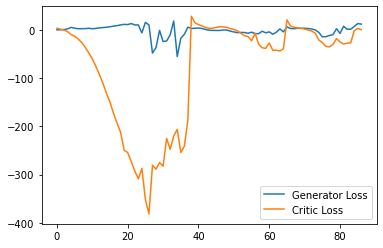

Step 1800: Generator loss: 3.283680739402771, critic loss: -17.26863840675354


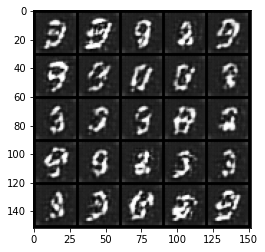

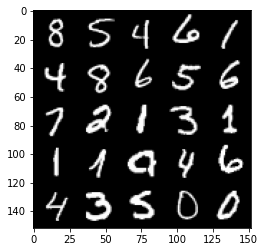

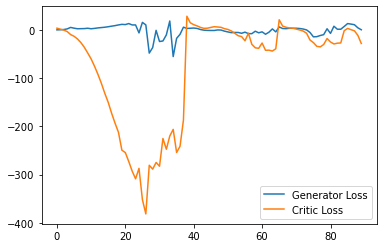

Step 1850: Generator loss: -2.6120152592659, critic loss: -29.020700933456425


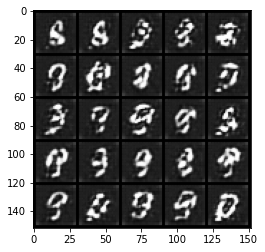

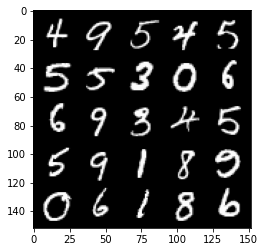

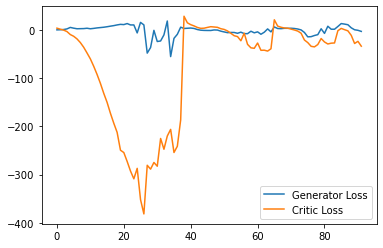

Step 1900: Generator loss: 9.857870216369628, critic loss: -13.20780030822754


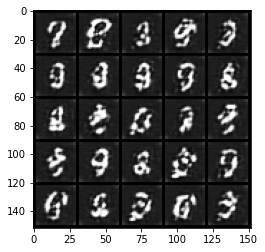

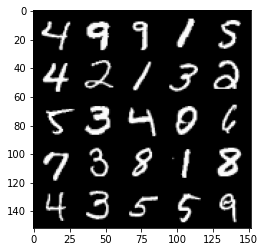

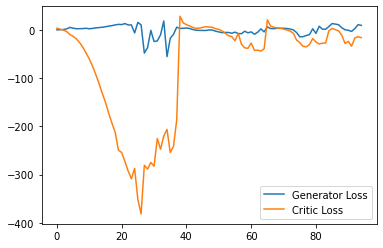

Step 1950: Generator loss: 8.12449153959751, critic loss: -17.816743782043456


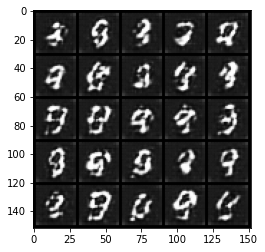

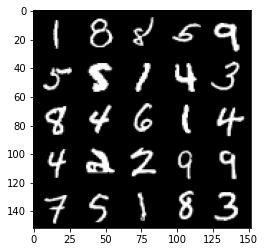

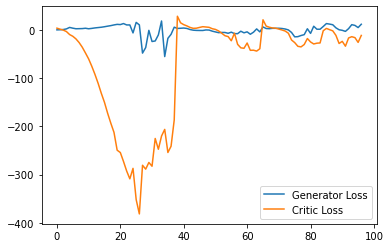

Step 2000: Generator loss: 15.998398036956788, critic loss: 0.6467016210556029


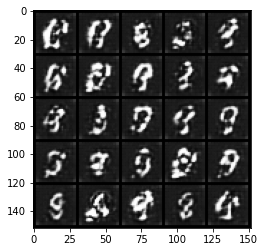

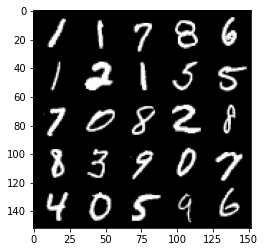

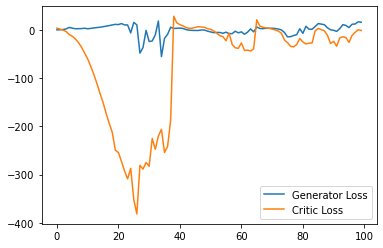

Step 2050: Generator loss: 13.306079826354981, critic loss: -2.9329096479415893


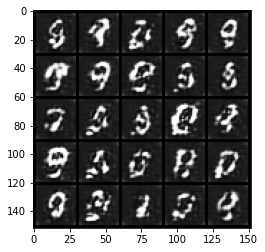

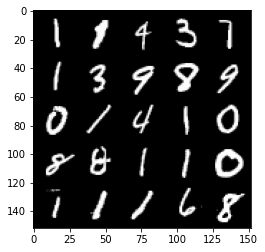

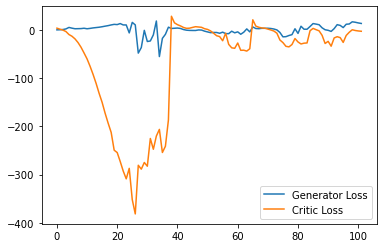

Step 2100: Generator loss: 10.22665391921997, critic loss: -5.049370678901672


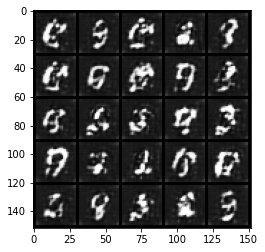

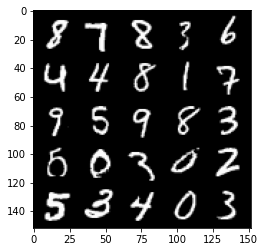

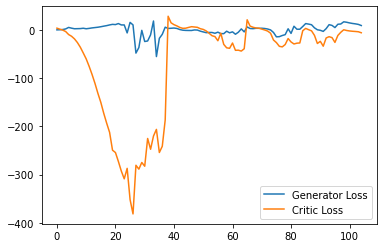

Step 2150: Generator loss: 0.5790348979830742, critic loss: -19.593790040969846


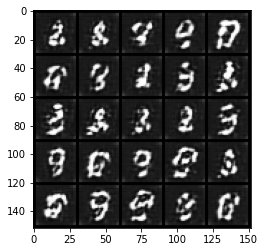

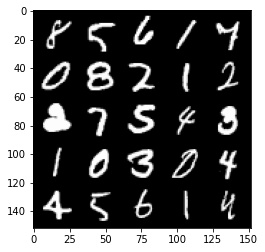

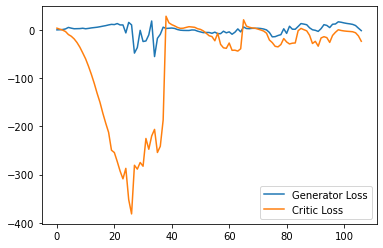

Step 2200: Generator loss: 9.301825004220008, critic loss: -8.12296194076538


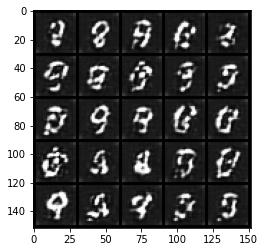

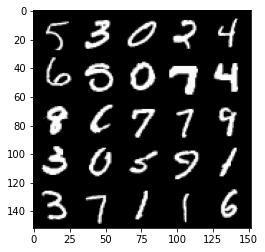

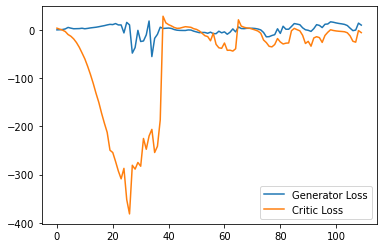

Step 2250: Generator loss: 10.050083932876587, critic loss: -9.781713730812074


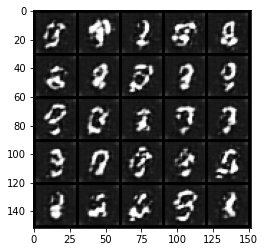

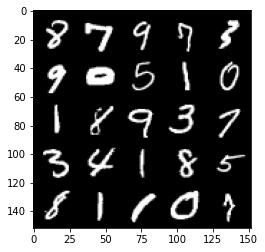

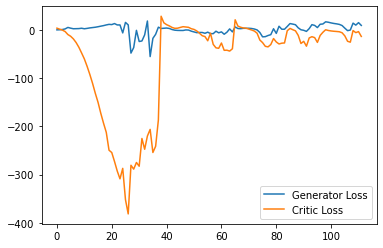

Step 2300: Generator loss: 4.7812717977166175, critic loss: -20.482695248603815


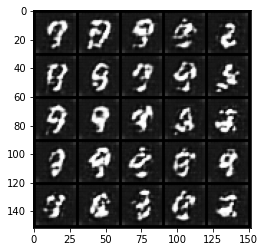

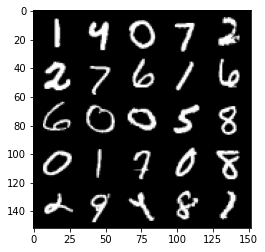

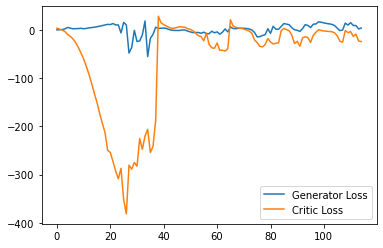

Step 2350: Generator loss: 11.35196830958128, critic loss: -11.834716519355768


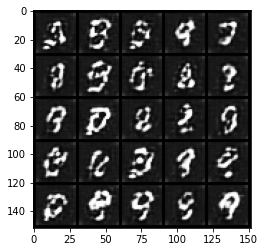

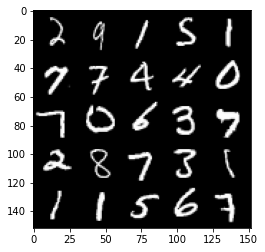

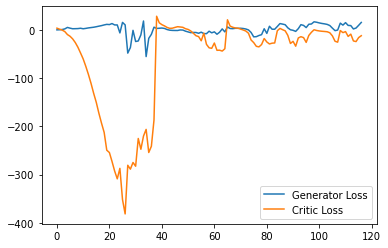

Step 2400: Generator loss: 10.591976572871209, critic loss: -13.109149813652039


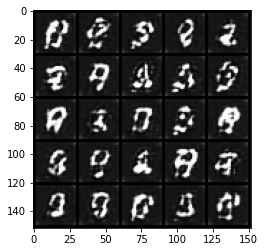

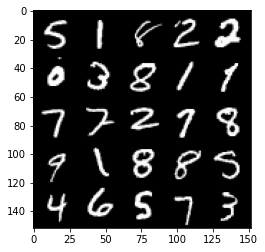

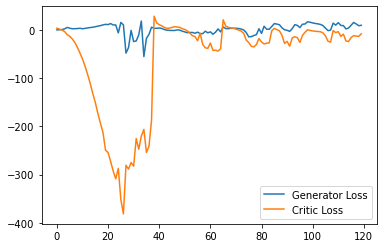

Step 2450: Generator loss: 13.011504266262055, critic loss: -6.61688747024536


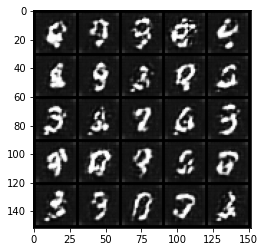

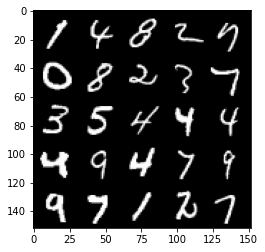

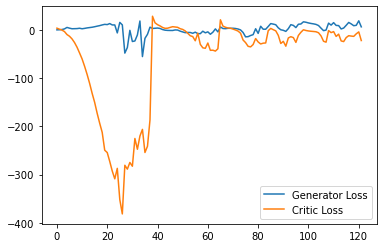

Step 2500: Generator loss: 18.525796451568603, critic loss: -1.59315421295166


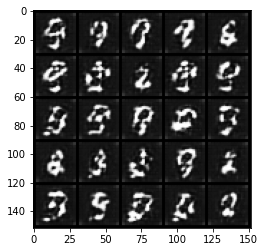

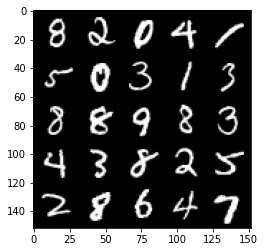

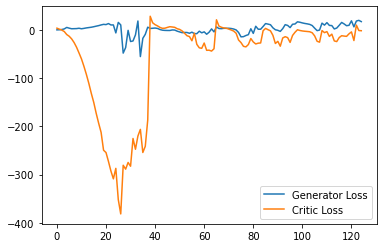

Step 2550: Generator loss: 12.896319618225098, critic loss: -2.1457685542106635


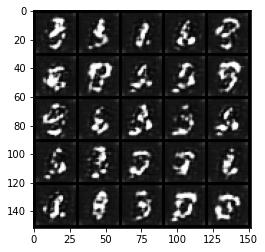

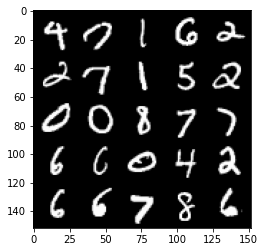

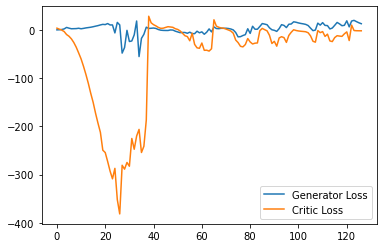

Step 2600: Generator loss: 7.611551446914673, critic loss: -2.3074932971000663


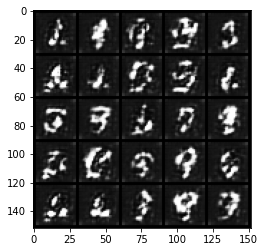

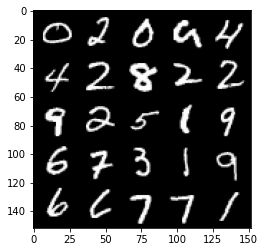

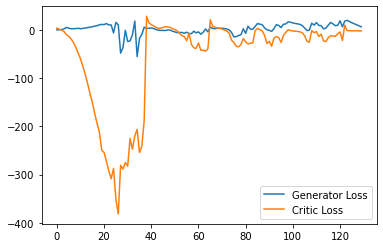

Step 2650: Generator loss: 3.577408928871155, critic loss: -2.5642974600791932


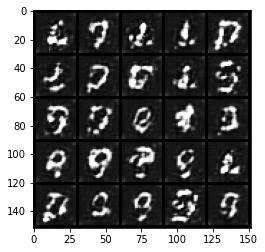

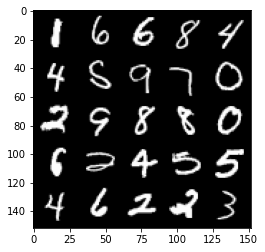

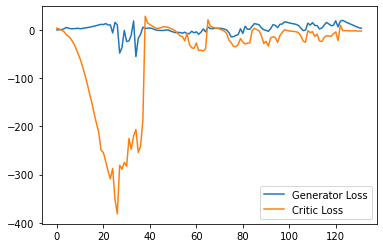

Step 2700: Generator loss: 3.6159913301467896, critic loss: -2.492202114105224


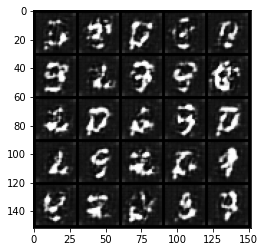

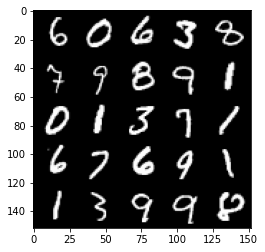

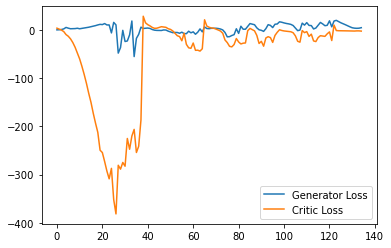

Step 2750: Generator loss: 3.1468568199872973, critic loss: -3.8933207073211684


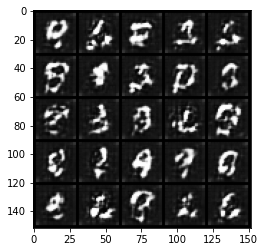

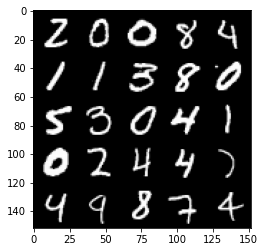

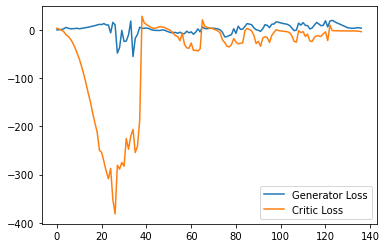

Step 2800: Generator loss: 1.7821066616475583, critic loss: -1.9722984867095934


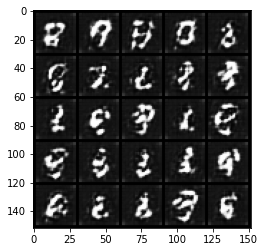

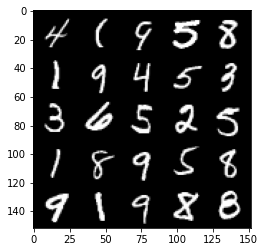

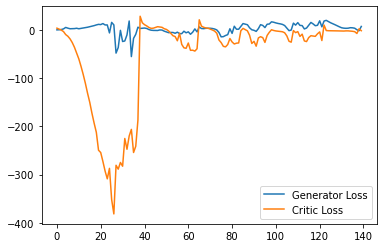

Step 2850: Generator loss: 4.693469896316528, critic loss: -2.093838060855866


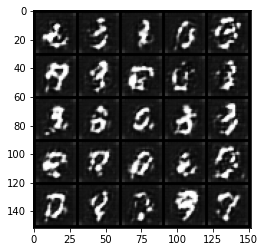

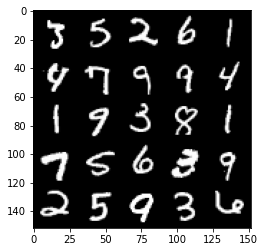

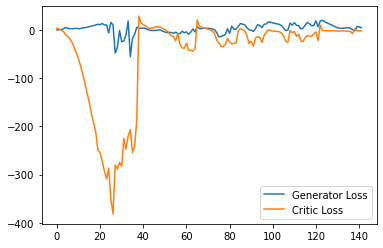

Step 2900: Generator loss: 1.8541322135925293, critic loss: -2.707410385131835


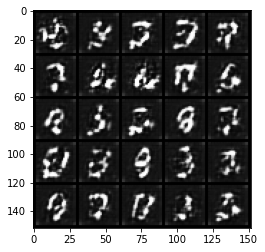

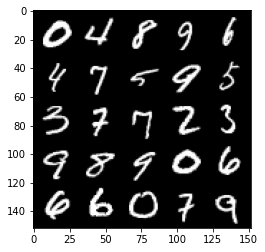

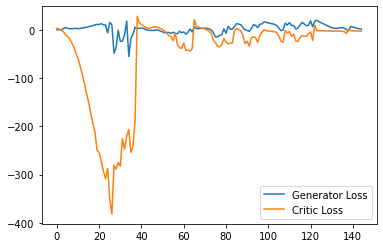

Step 2950: Generator loss: -0.3180630272626877, critic loss: -5.119299813270569


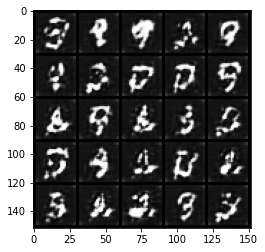

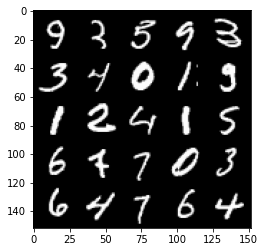

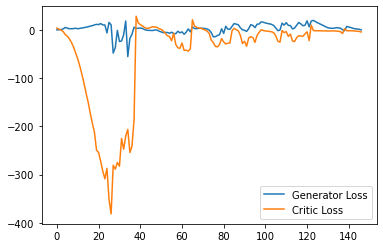

Step 3000: Generator loss: 5.5245629158616065, critic loss: -3.9694972219467166


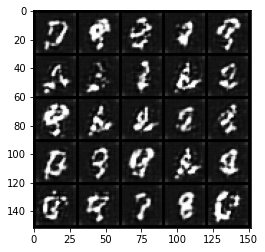

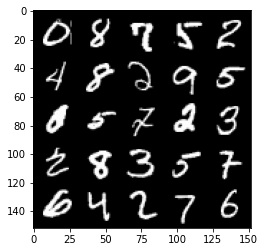

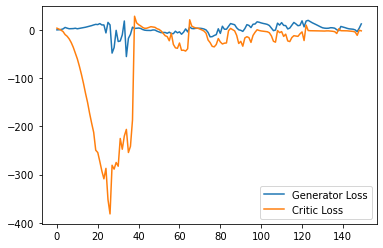

Step 3050: Generator loss: 9.967649841308594, critic loss: -2.463846930503845


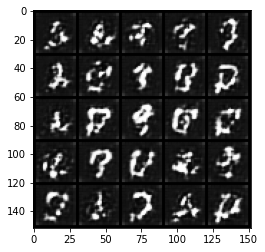

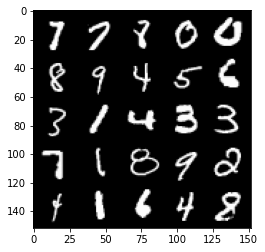

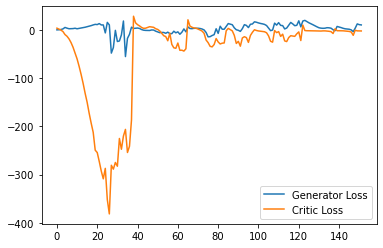

Step 3100: Generator loss: 6.539179520606995, critic loss: -3.3190215883255014


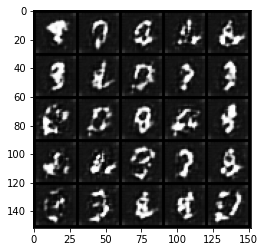

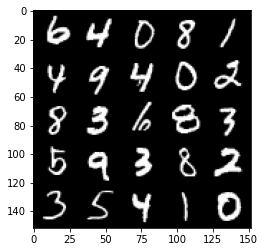

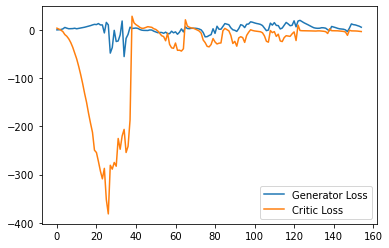

Step 3150: Generator loss: 3.628188197016716, critic loss: -2.2819740624427785


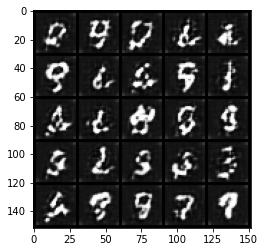

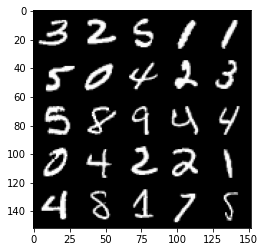

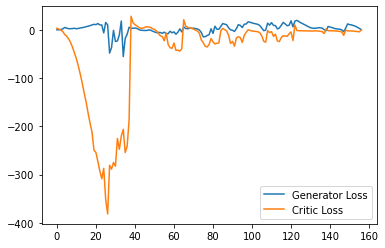

Step 3200: Generator loss: 8.974083824157715, critic loss: -2.308257445812225


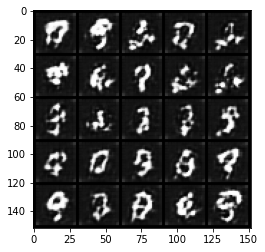

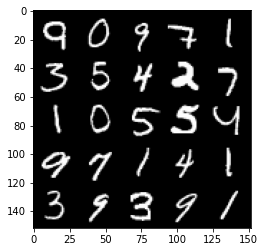

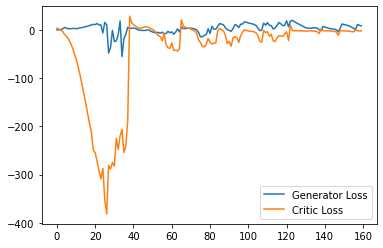

Step 3250: Generator loss: 5.218712391853333, critic loss: -2.944249115943909


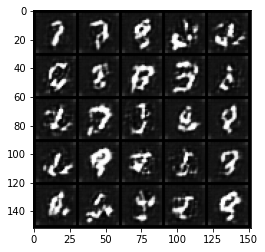

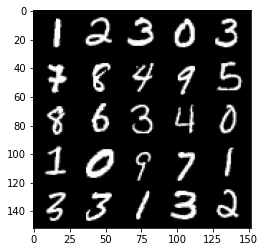

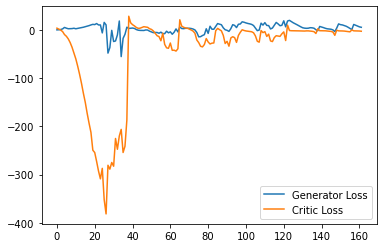

Step 3300: Generator loss: 1.3929499705135822, critic loss: -5.014726409912109


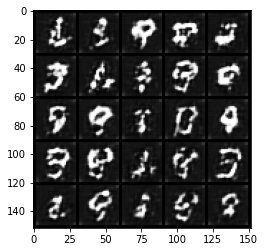

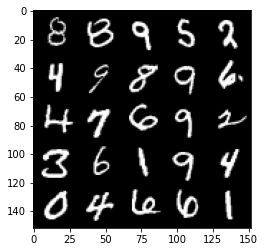

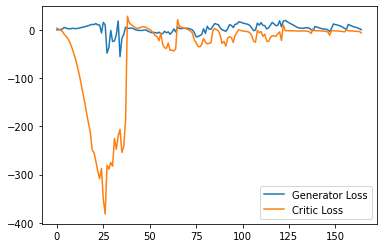

Step 3350: Generator loss: -3.080769898891449, critic loss: -14.174326591491695


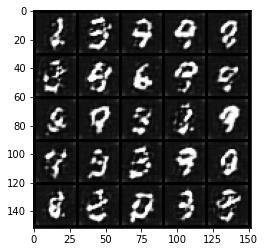

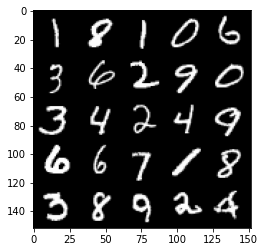

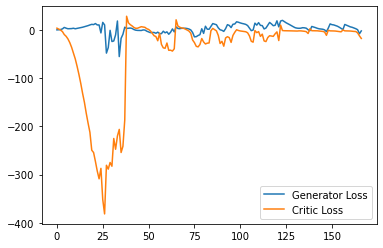

Step 3400: Generator loss: 4.879916061460972, critic loss: -15.969243891716005


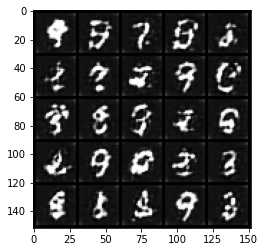

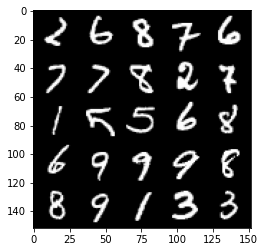

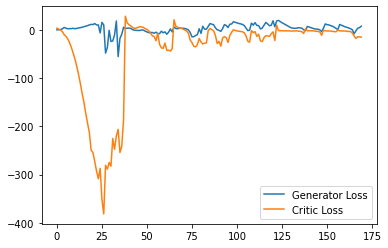

Step 3450: Generator loss: 7.8465787762403485, critic loss: -13.147668127059935


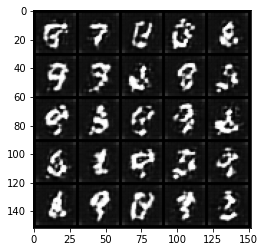

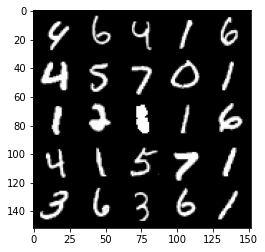

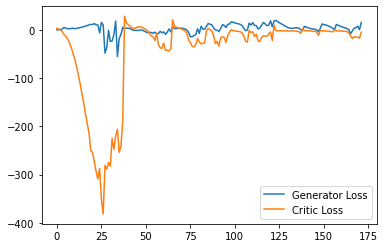

Step 3500: Generator loss: 5.639793781638145, critic loss: -20.516382392883305


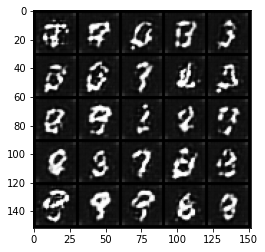

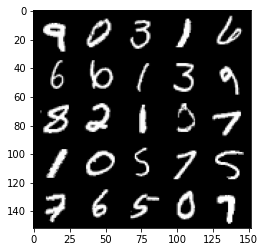

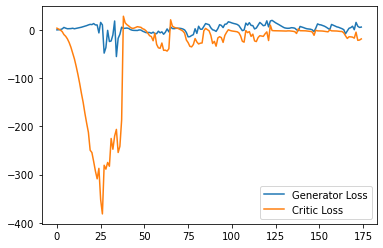

Step 3550: Generator loss: 12.659617300033569, critic loss: -12.691054079055784


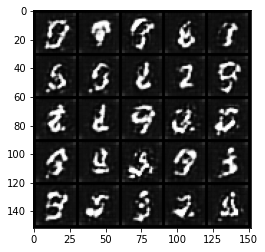

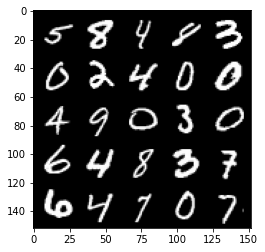

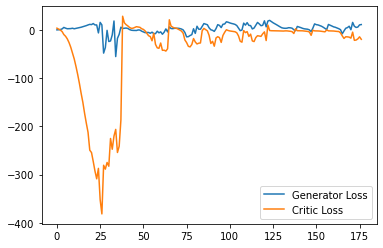

Step 3600: Generator loss: 18.168500046730042, critic loss: -7.860569546699525


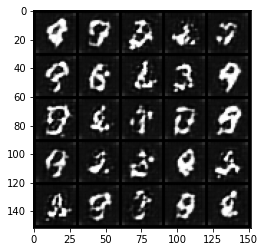

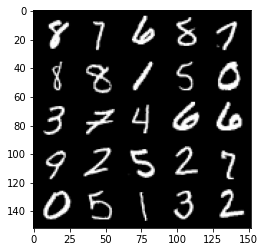

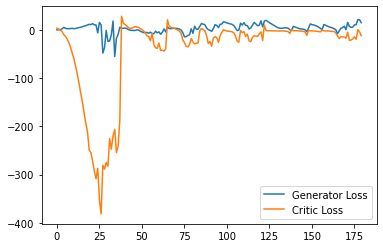

Step 3650: Generator loss: 10.246191351413726, critic loss: -20.100023593902588


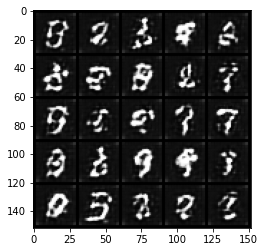

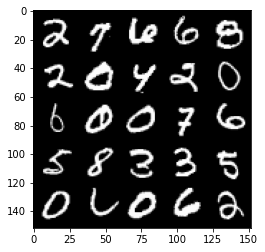

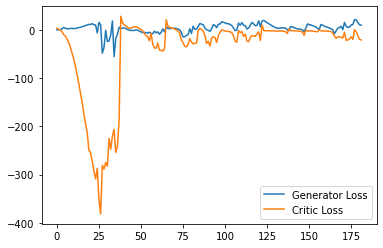

Step 3700: Generator loss: 22.645386219024658, critic loss: 1.629548058986665


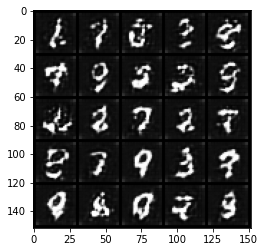

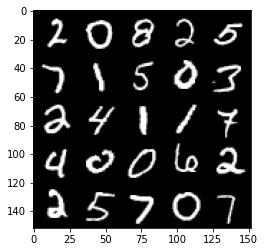

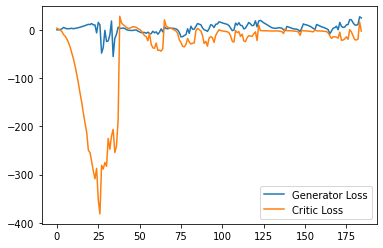

Step 3750: Generator loss: 21.14497188568115, critic loss: -2.6964143695831306


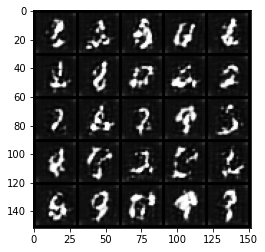

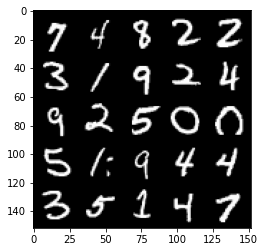

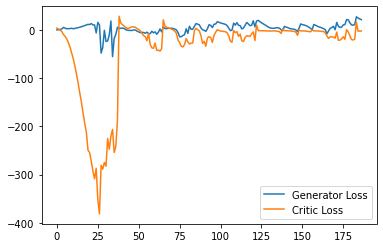

Step 3800: Generator loss: 16.62172281265259, critic loss: -2.984563649177551


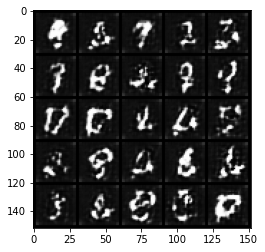

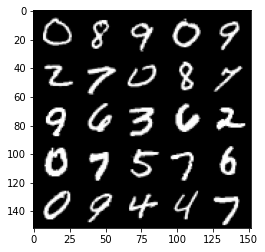

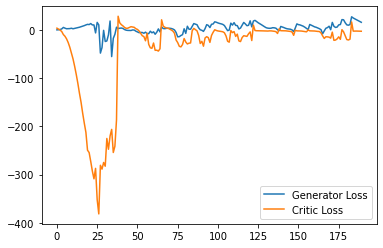

Step 3850: Generator loss: 12.82045171737671, critic loss: -3.385572016716003


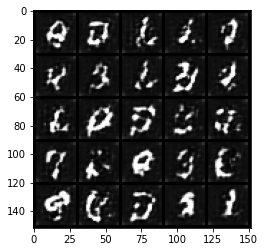

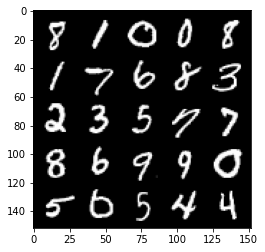

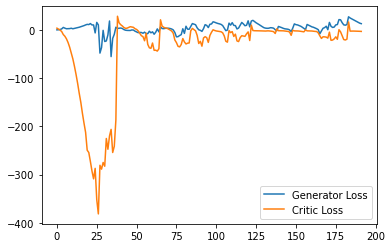

Step 3900: Generator loss: 9.668282979428769, critic loss: -8.310941094398501


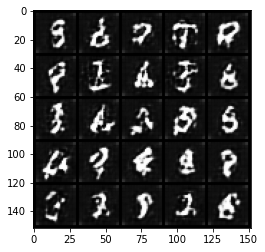

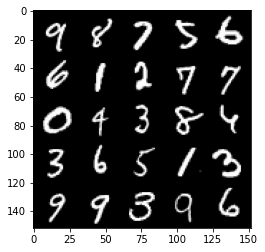

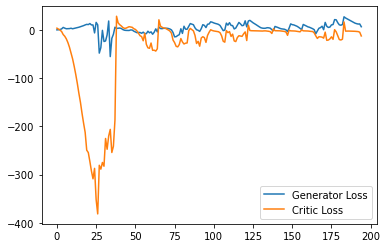

Step 3950: Generator loss: 6.7730903089046475, critic loss: -19.21901230144501


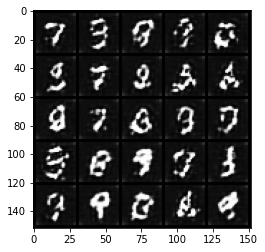

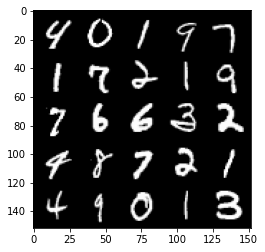

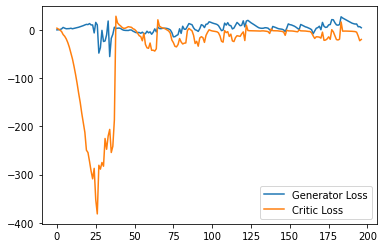

Step 4000: Generator loss: 13.965476938486098, critic loss: -9.46130915737152


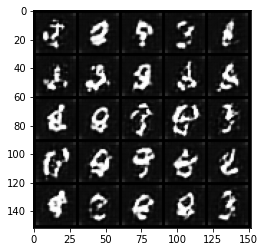

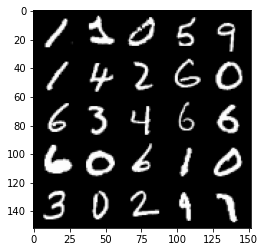

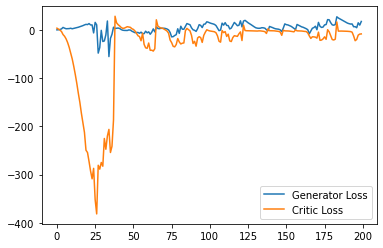

Step 4050: Generator loss: 15.956617422103882, critic loss: -12.087133453369145


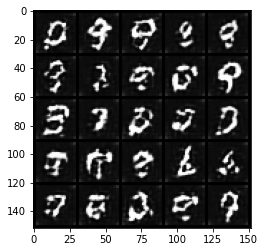

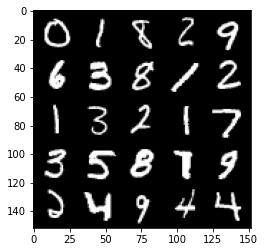

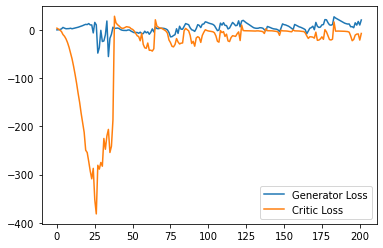

Step 4100: Generator loss: 11.803654608726502, critic loss: -15.835590342521671


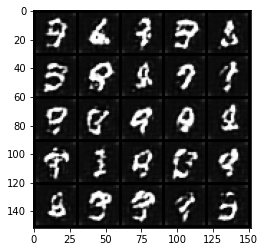

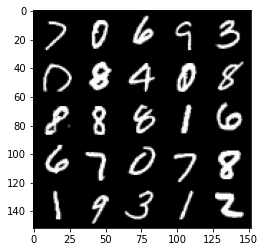

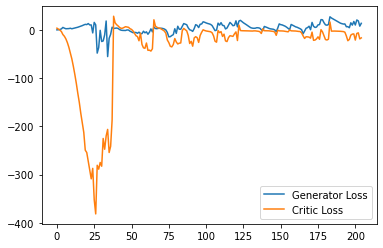

Step 4150: Generator loss: 10.990909543037414, critic loss: -17.57653919601441


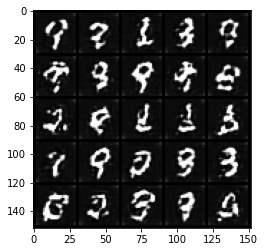

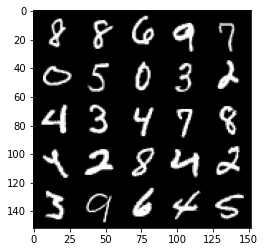

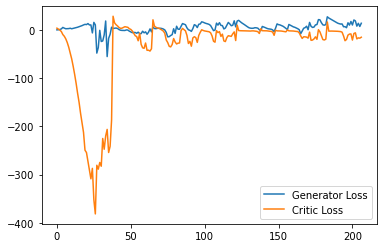

Step 4200: Generator loss: 14.9666081905365, critic loss: -15.638667668342595


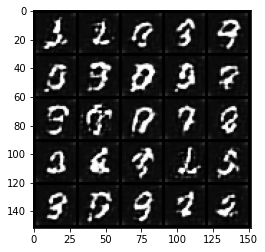

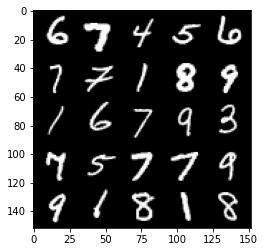

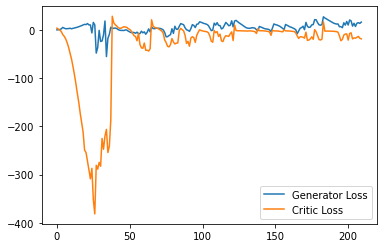

Step 4250: Generator loss: 19.032915287017822, critic loss: -14.826682896614072


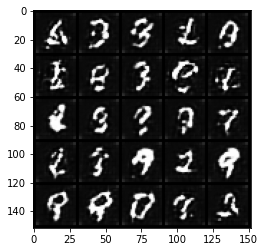

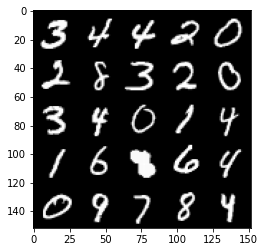

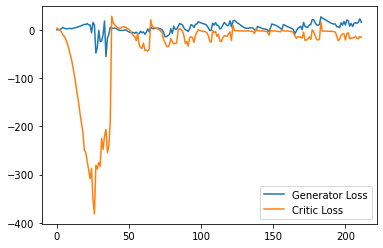

Step 4300: Generator loss: 20.087690114974976, critic loss: -4.667183203697207


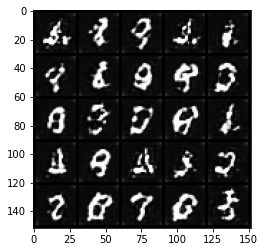

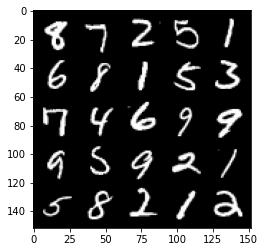

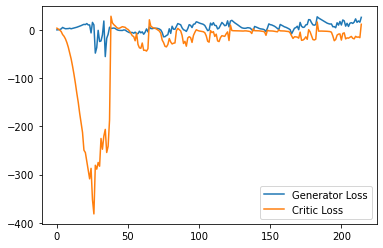

Step 4350: Generator loss: 29.176253814697265, critic loss: -2.756809858322143


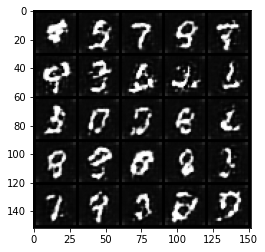

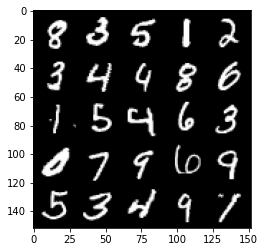

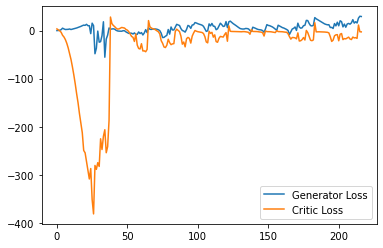

Step 4400: Generator loss: 26.40000259399414, critic loss: -2.7699857692718513


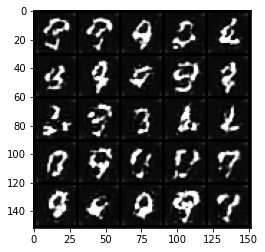

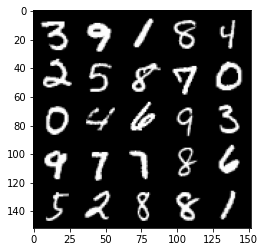

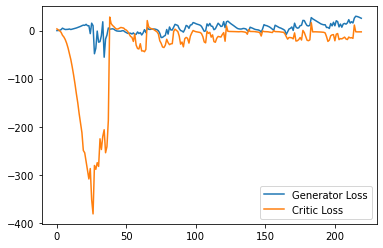

Step 4450: Generator loss: 22.930481491088866, critic loss: -2.9234979715347293


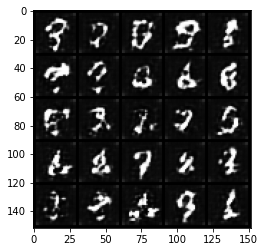

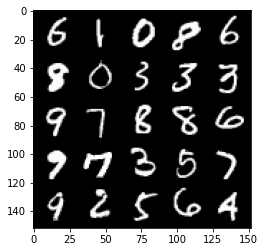

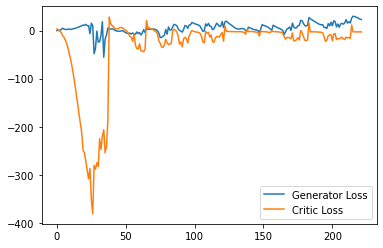

Step 4500: Generator loss: 20.852805824279784, critic loss: -3.0855343065261844


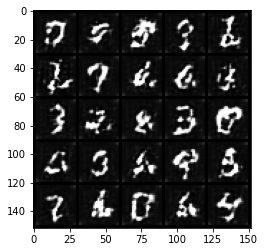

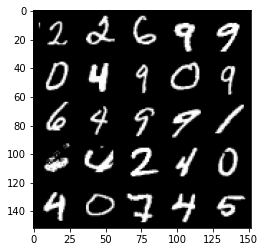

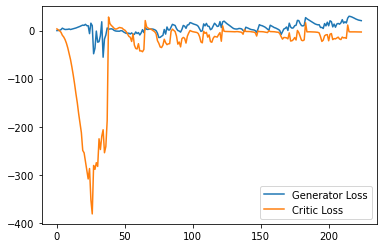

Step 4550: Generator loss: 19.590802955627442, critic loss: -3.325684367179871


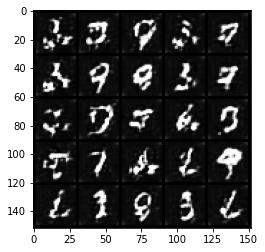

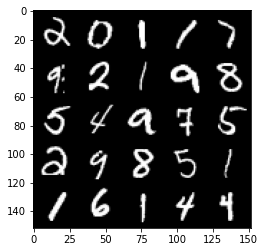

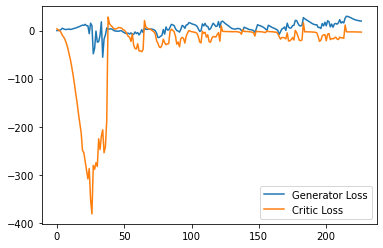

Step 4600: Generator loss: 18.09681037902832, critic loss: -4.214863858222962


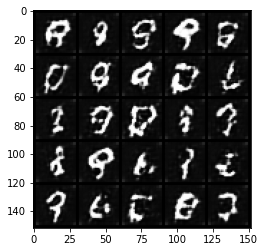

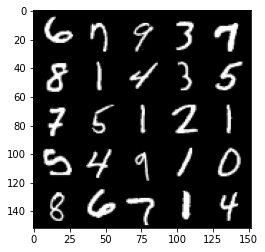

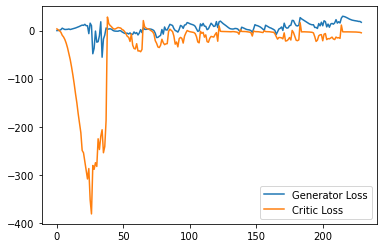

Step 4650: Generator loss: 11.604620269536973, critic loss: -10.525368728160862


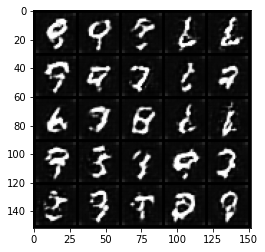

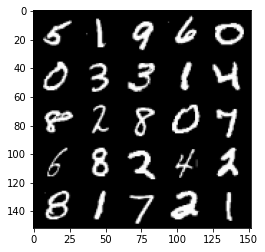

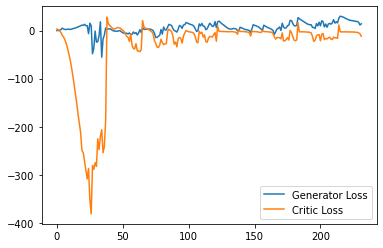

Step 4700: Generator loss: 11.938443245887756, critic loss: -11.781439690589902


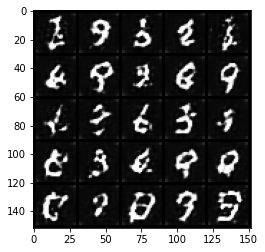

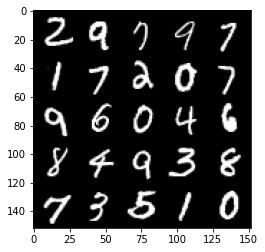

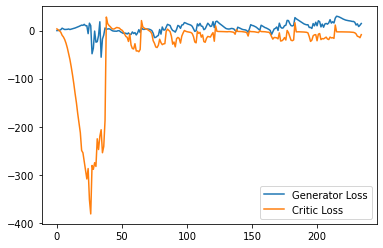

Step 4750: Generator loss: 15.94059053659439, critic loss: -15.031478611946103


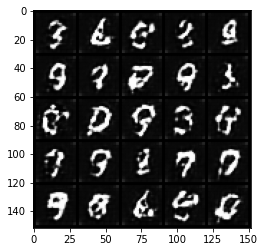

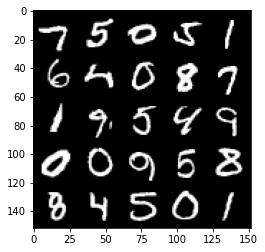

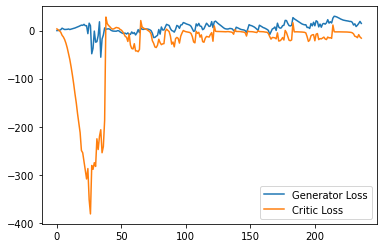

Step 4800: Generator loss: 18.323715373277665, critic loss: -7.974201259613037


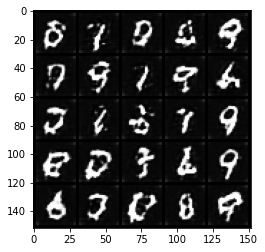

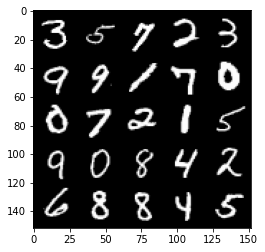

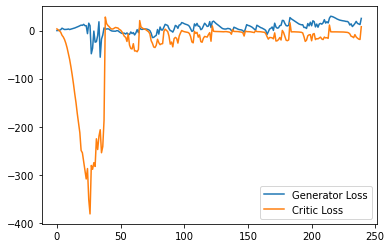

Step 4850: Generator loss: 24.57114318847656, critic loss: -3.0459630575180063


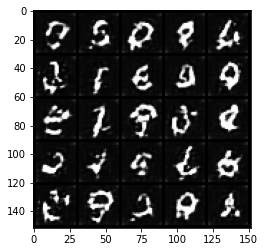

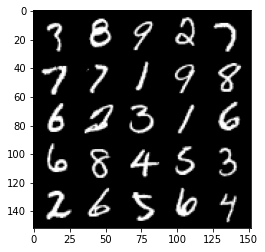

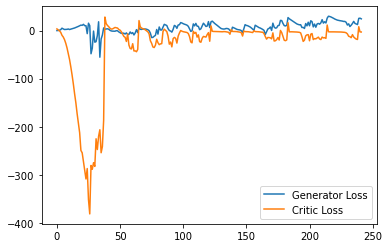

Step 4900: Generator loss: 19.917750358581543, critic loss: -3.0782411584854117


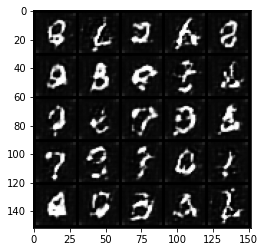

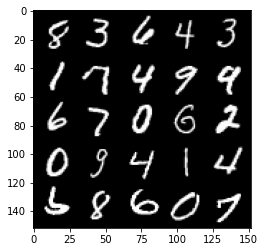

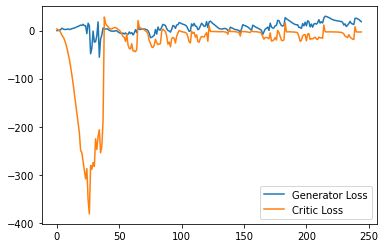

Step 4950: Generator loss: 17.645316390991212, critic loss: -3.7989825839996336


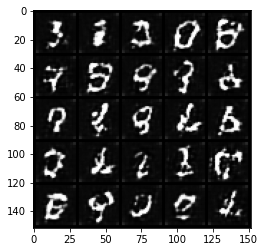

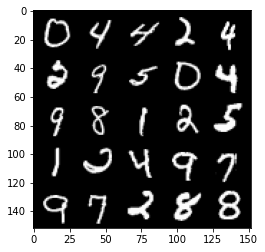

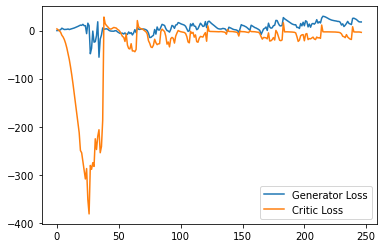

Step 5000: Generator loss: 9.56886090874672, critic loss: -14.94470169830322


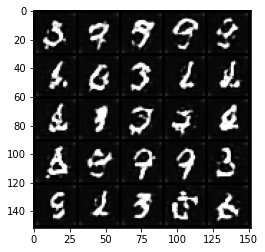

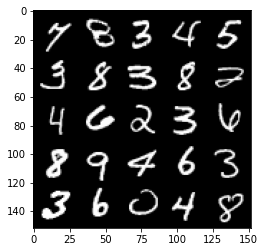

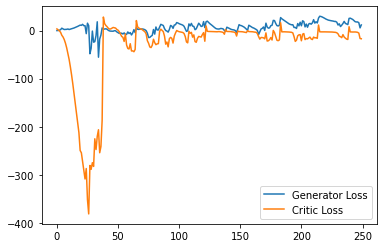

Step 5050: Generator loss: 21.06272668838501, critic loss: -2.962882054328918


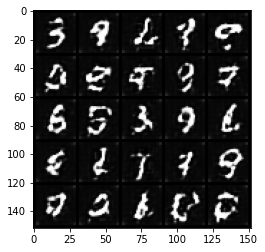

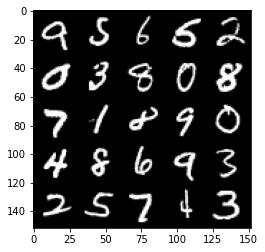

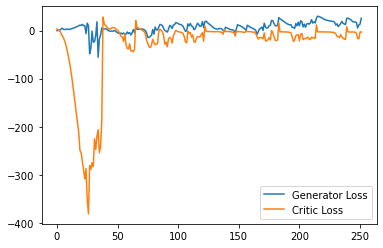

Step 5100: Generator loss: 23.21939598083496, critic loss: -3.4963461990356426


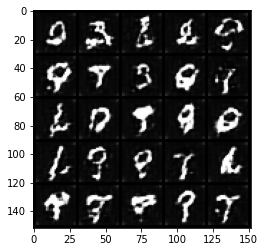

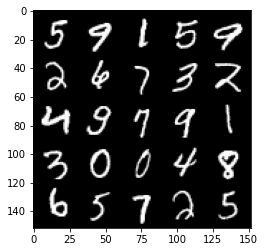

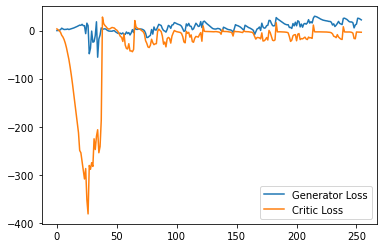

Step 5150: Generator loss: 14.925270731449126, critic loss: -8.76223925495148


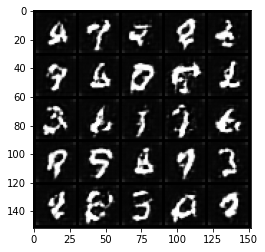

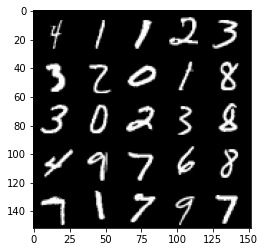

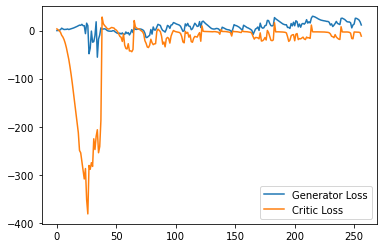

Step 5200: Generator loss: 9.885899411439896, critic loss: -17.91601882648468


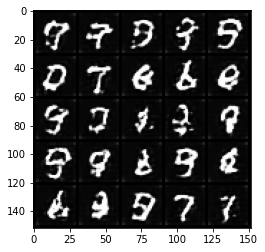

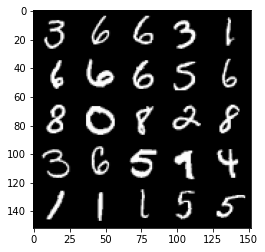

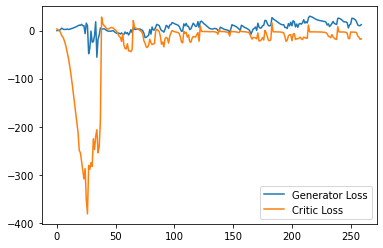

Step 5250: Generator loss: 17.22037253379822, critic loss: -12.73573614120484


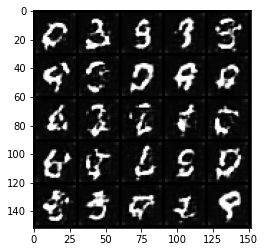

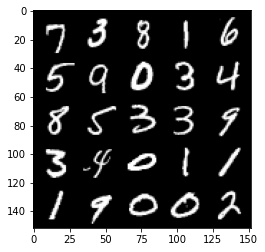

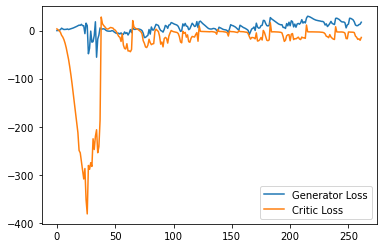

Step 5300: Generator loss: 11.95144637018442, critic loss: -15.545949872970578


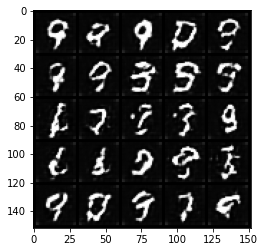

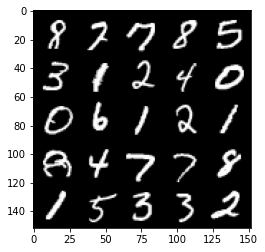

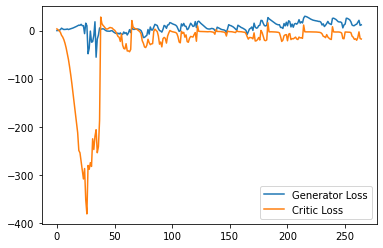

Step 5350: Generator loss: 14.484052534103393, critic loss: -18.14308233833313


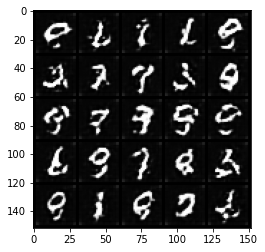

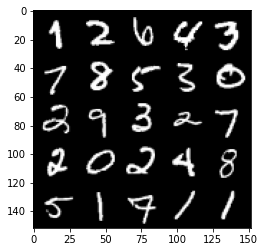

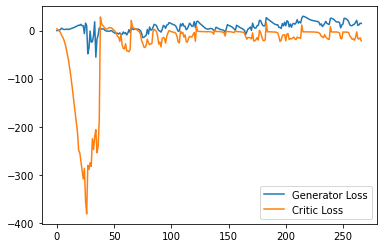

Step 5400: Generator loss: 18.78495478630066, critic loss: -8.436163354873655


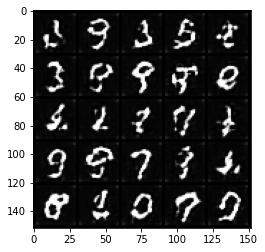

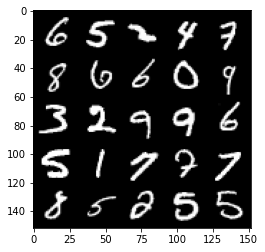

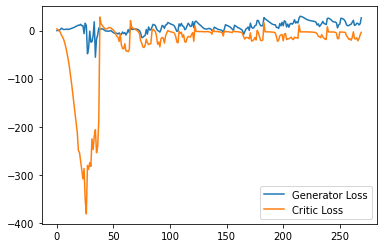

Step 5450: Generator loss: 15.889093008041382, critic loss: -10.499851550102235


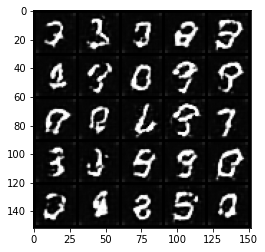

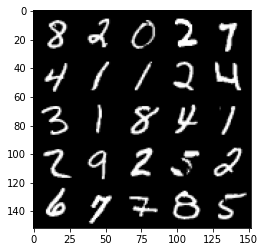

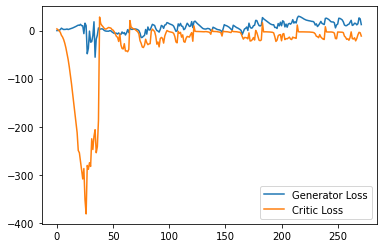

Step 5500: Generator loss: 16.875378766059875, critic loss: -13.19168650531769


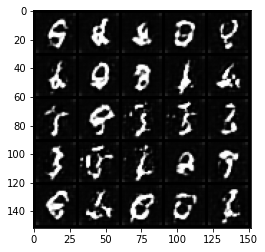

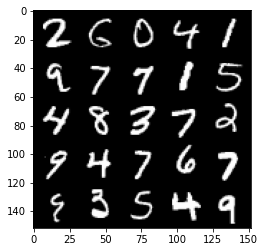

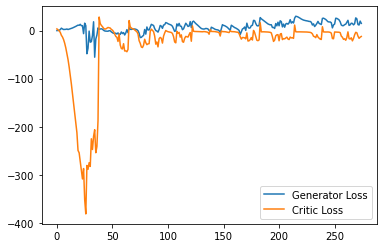

Step 5550: Generator loss: 10.42338812828064, critic loss: -16.025884857654567


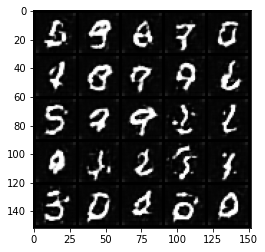

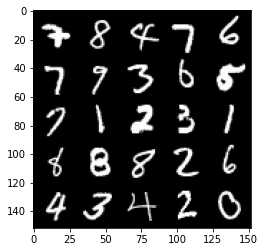

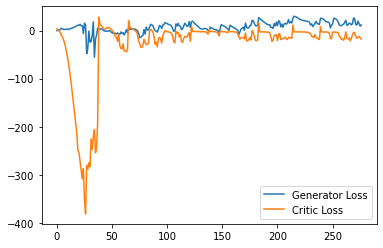

Step 5600: Generator loss: 19.579932113885878, critic loss: -7.239381851196288


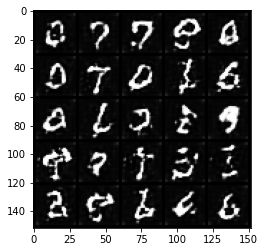

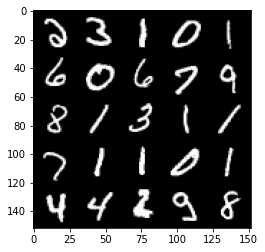

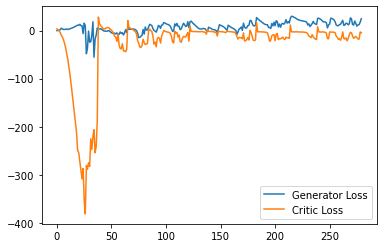

Step 5650: Generator loss: 18.98302095890045, critic loss: -9.096102227687837


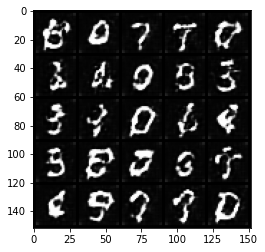

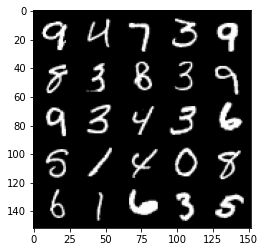

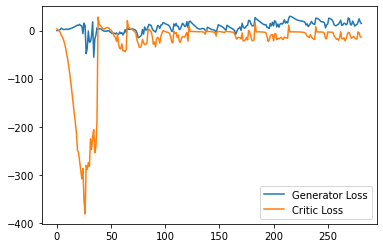

Step 5700: Generator loss: 12.431947059631348, critic loss: -1.958335912704468


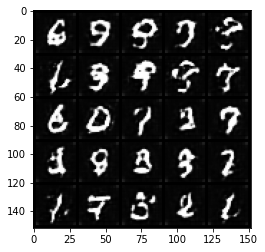

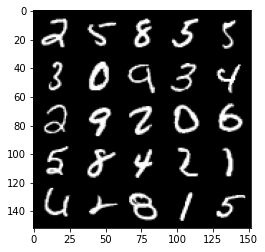

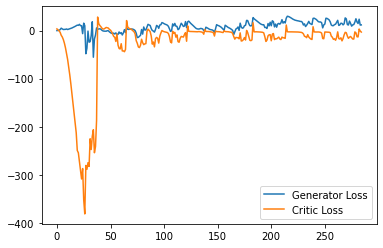

Step 5750: Generator loss: 14.440637272596359, critic loss: -10.616981276035308


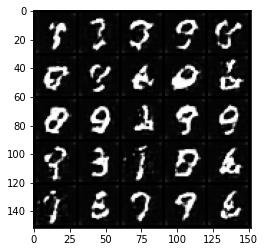

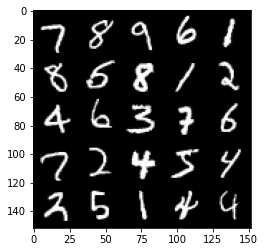

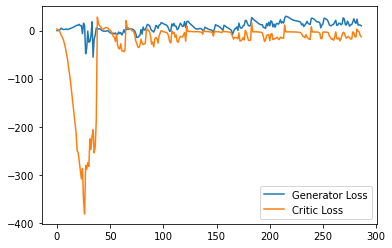

Step 5800: Generator loss: 15.351715211868287, critic loss: -5.767178576469421


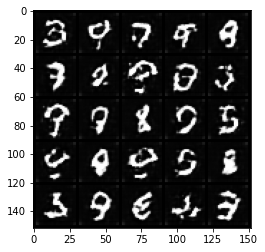

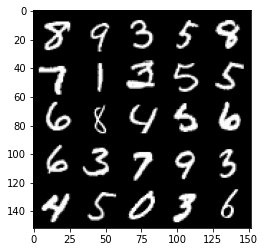

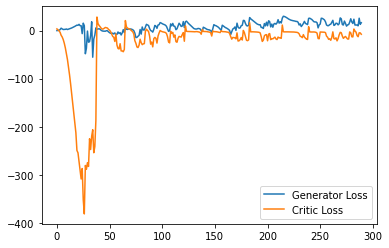

Step 5850: Generator loss: 10.055662987232209, critic loss: -14.39506961345673


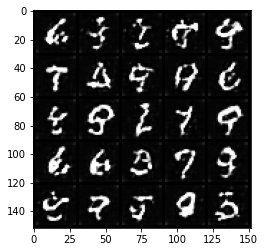

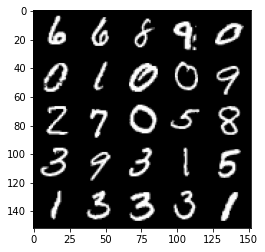

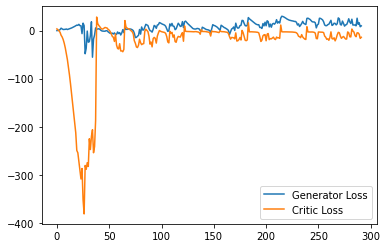

Step 5900: Generator loss: 11.962557131052018, critic loss: -13.57720318222046


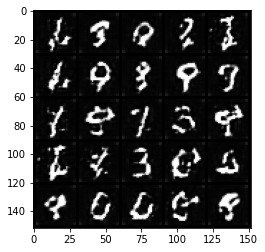

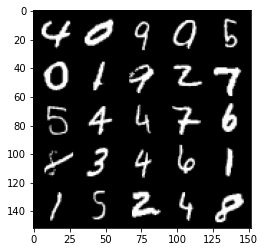

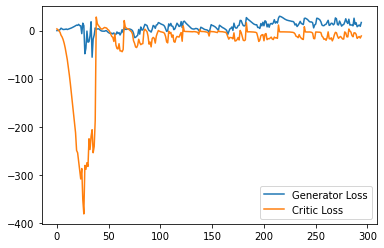

Step 5950: Generator loss: 14.960009949207306, critic loss: 1.7387069468498217


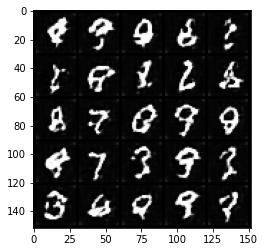

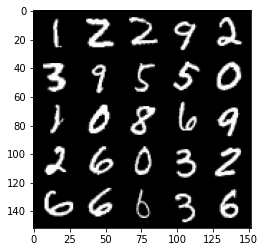

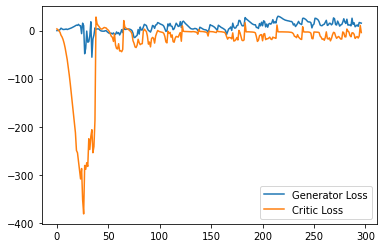

Step 6000: Generator loss: 18.497719593048096, critic loss: -5.102936128616333


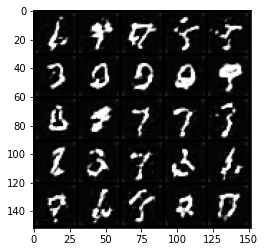

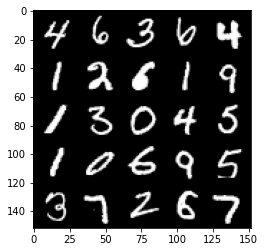

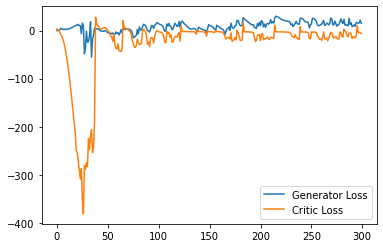

Step 6050: Generator loss: 11.514992752671242, critic loss: -14.623057549953453


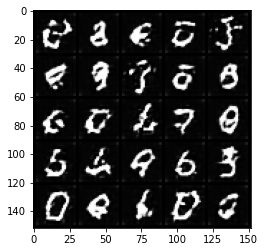

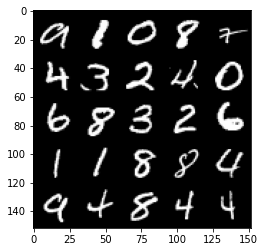

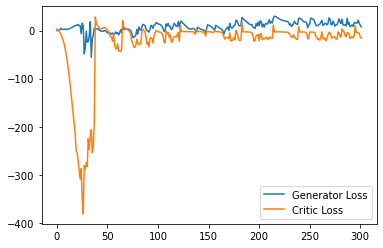

Step 6100: Generator loss: 8.827217657864093, critic loss: -14.917748267173767


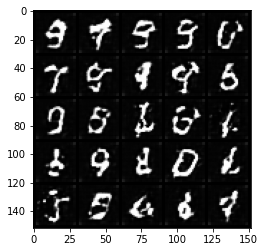

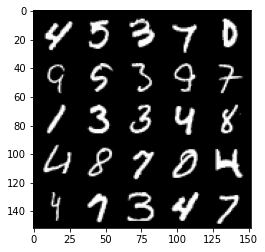

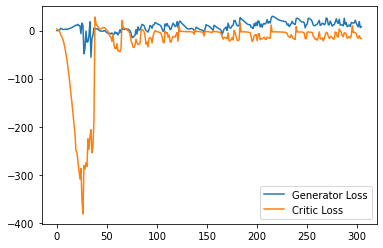

Step 6150: Generator loss: 14.18620604634285, critic loss: -13.178716849327088


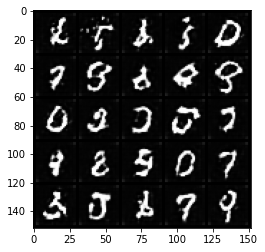

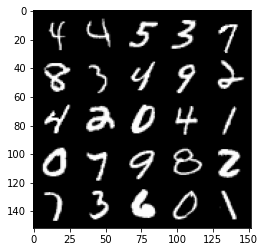

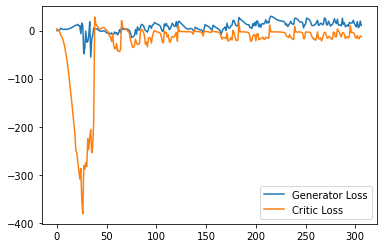

Step 6200: Generator loss: 18.836831931471824, critic loss: -3.01806323623657


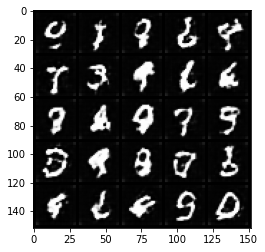

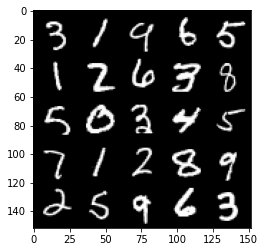

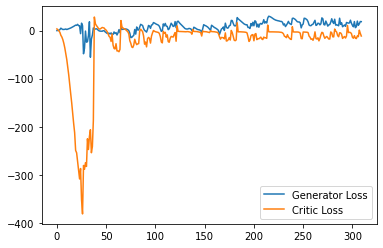

Step 6250: Generator loss: 14.130162773132325, critic loss: -1.76021360874176


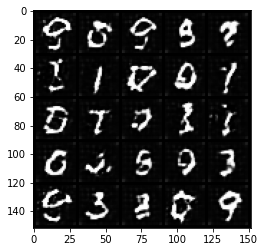

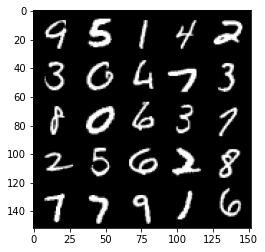

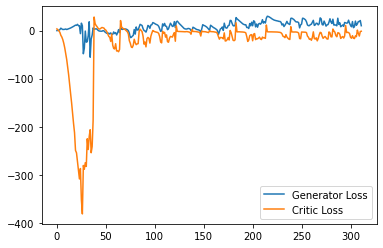

Step 6300: Generator loss: 11.735132484436035, critic loss: -10.254330625534058


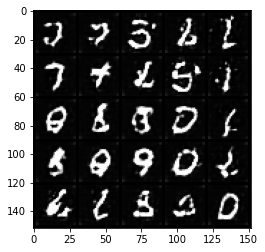

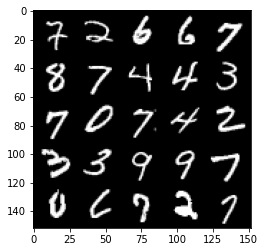

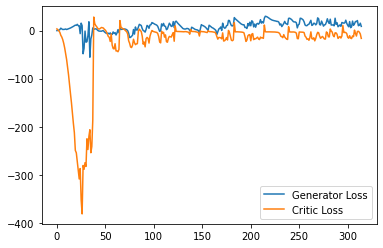

Step 6350: Generator loss: 12.79575653553009, critic loss: -11.163681114196775


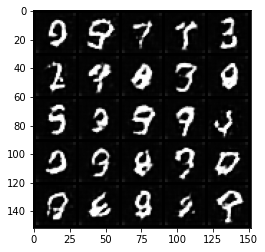

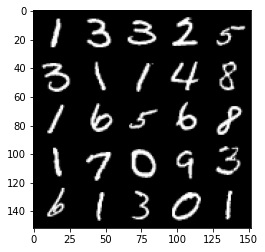

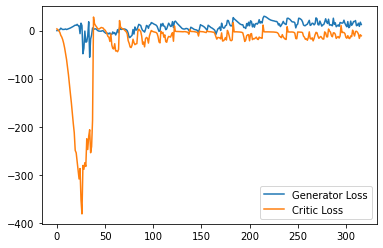

Step 6400: Generator loss: 13.941694966554643, critic loss: -14.538260534763335


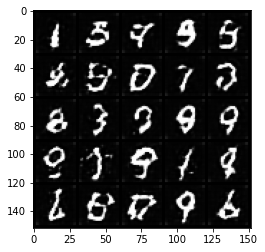

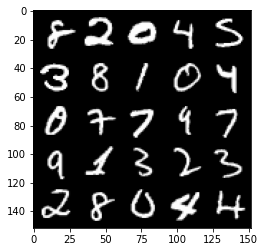

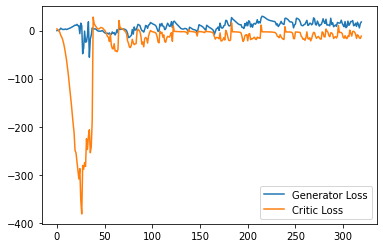

Step 6450: Generator loss: 15.375453033447265, critic loss: -10.586846291065218


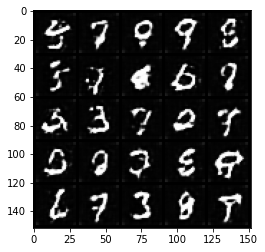

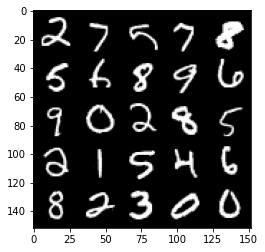

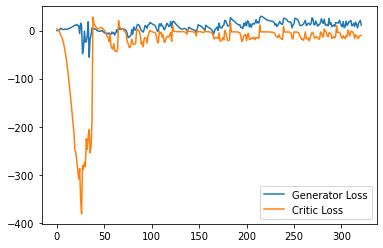

Step 6500: Generator loss: 11.016211856007576, critic loss: -13.457941397666932


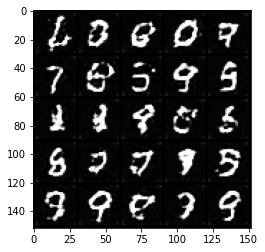

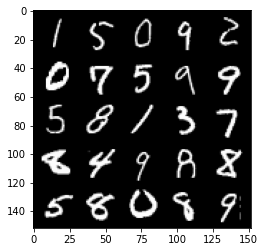

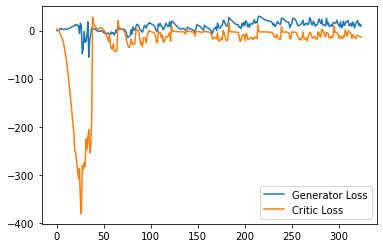

Step 6550: Generator loss: 12.514799988269806, critic loss: -12.368443325996404


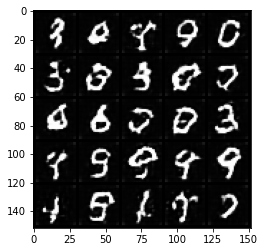

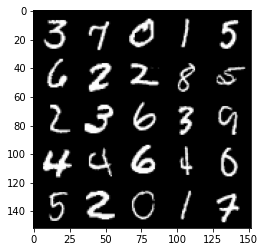

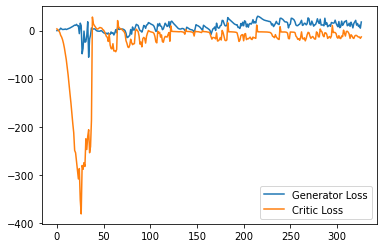

Step 6600: Generator loss: 13.376794290542602, critic loss: -15.407899931907655


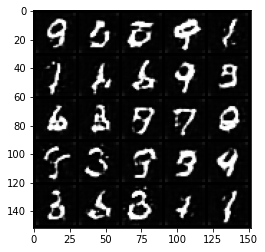

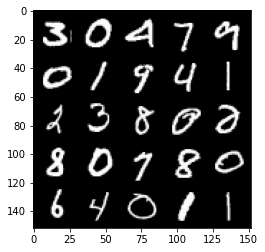

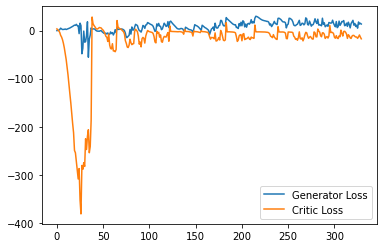

Step 6650: Generator loss: 15.16313628733158, critic loss: -12.496458698272702


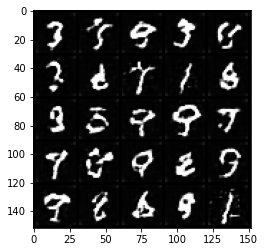

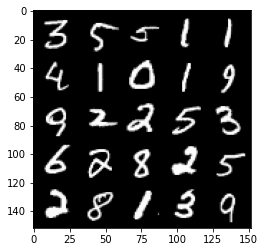

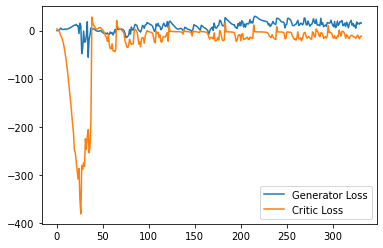

Step 6700: Generator loss: 15.191784884929657, critic loss: -13.511610860824588


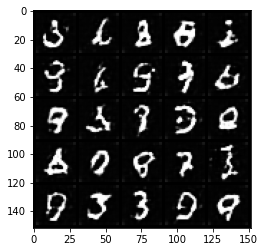

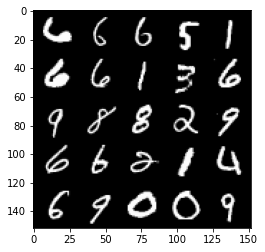

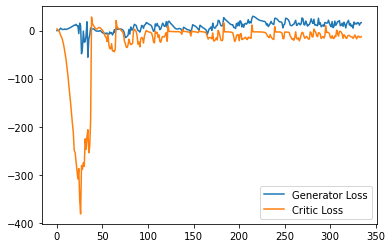

Step 6750: Generator loss: 14.366731157898903, critic loss: -14.1164374923706


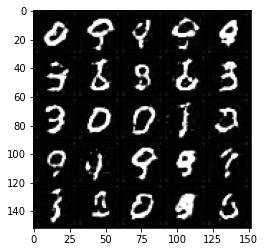

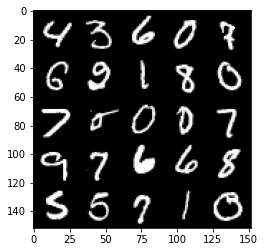

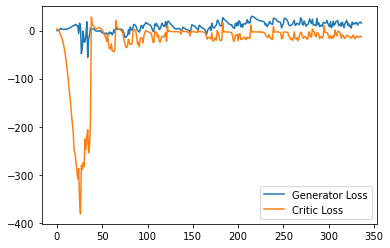

Step 6800: Generator loss: 18.895187046825885, critic loss: -7.478187704563143


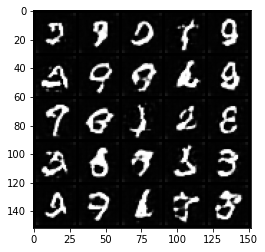

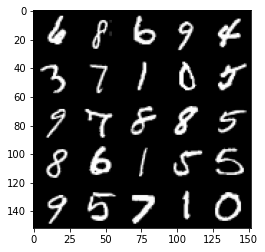

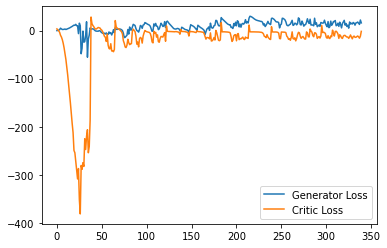

Step 6850: Generator loss: 14.679232060909271, critic loss: -13.332681188583372


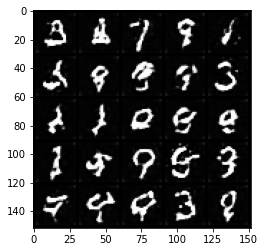

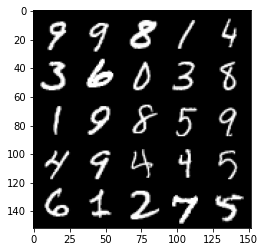

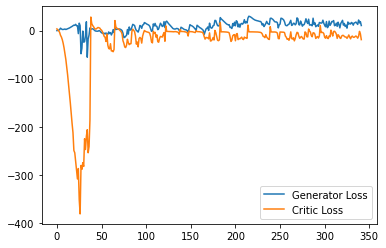

Step 6900: Generator loss: 15.299610233306884, critic loss: -16.41222899198532


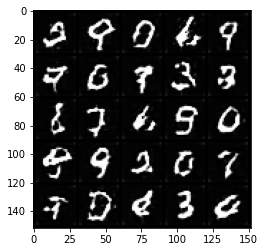

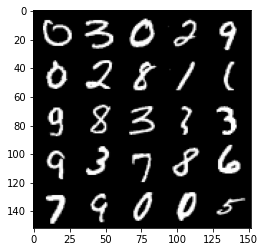

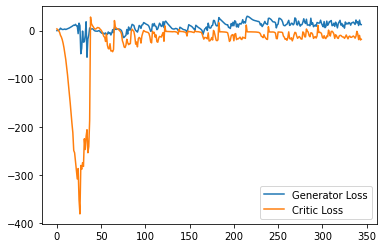

Step 6950: Generator loss: 18.567801436185835, critic loss: -11.858574454307554


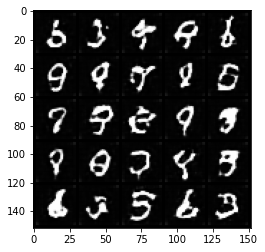

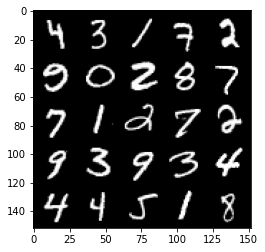

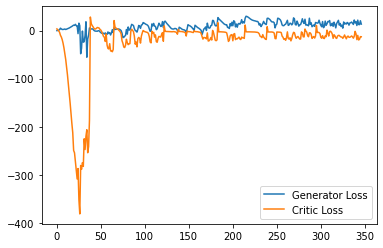

Step 7000: Generator loss: 16.005826106369497, critic loss: -15.777655816078184


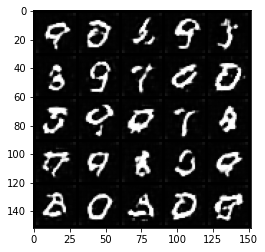

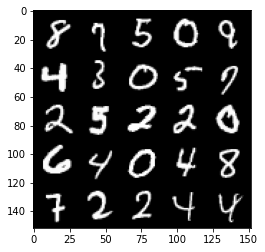

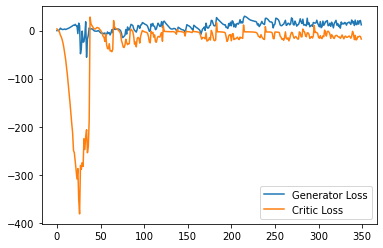

Step 7050: Generator loss: 18.651811017990113, critic loss: -9.830296526432036


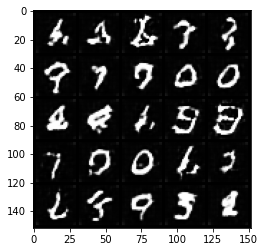

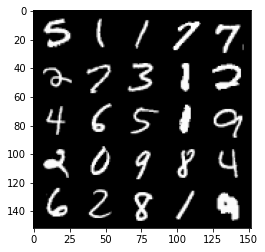

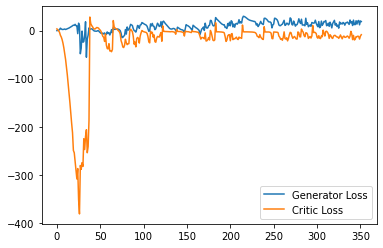

Step 7100: Generator loss: 14.852039365768432, critic loss: -13.00826793718338


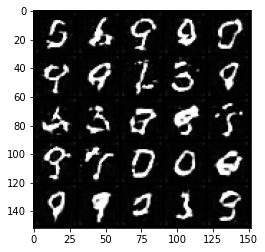

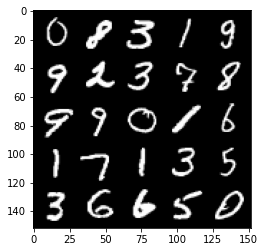

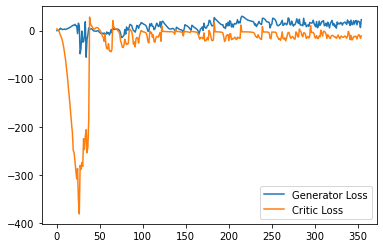

Step 7150: Generator loss: 12.958618484735489, critic loss: -12.954189791202541


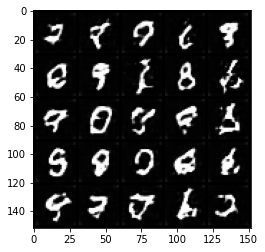

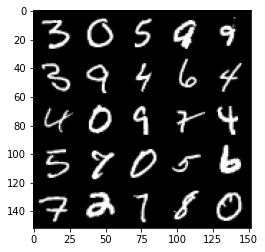

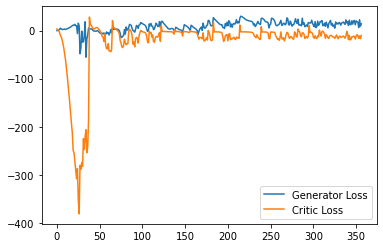

Step 7200: Generator loss: 15.968027949333191, critic loss: -5.555736018657684


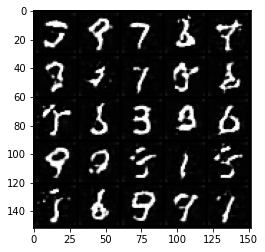

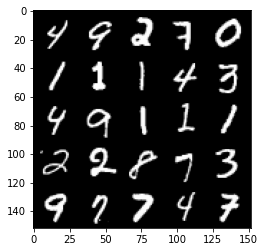

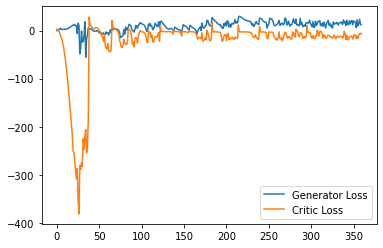

Step 7250: Generator loss: 17.56065029114485, critic loss: -11.77696684741974


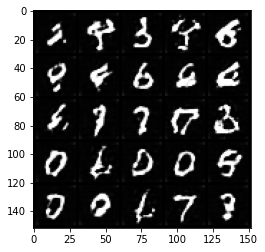

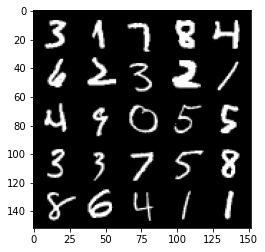

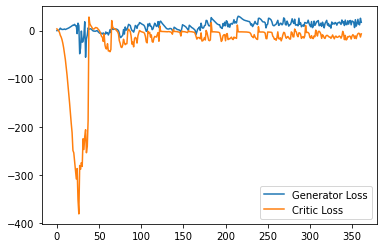

Step 7300: Generator loss: 14.014896515011788, critic loss: -11.653596471786502


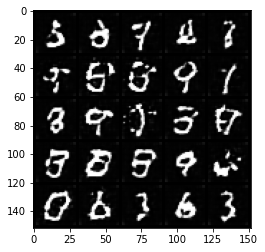

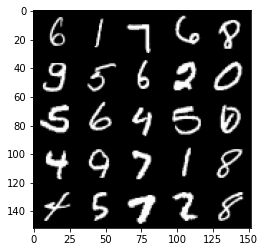

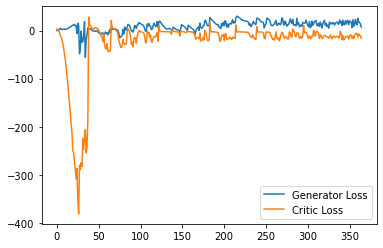

Step 7350: Generator loss: 15.900219264030456, critic loss: -9.631099434375763


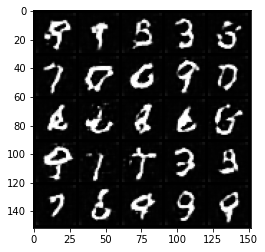

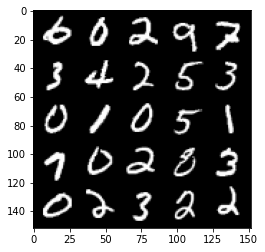

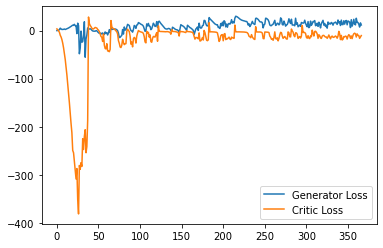

Step 7400: Generator loss: 24.701460933685304, critic loss: -5.620673237800597


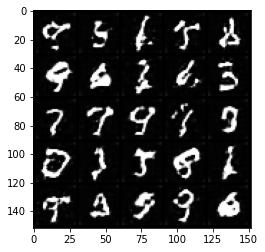

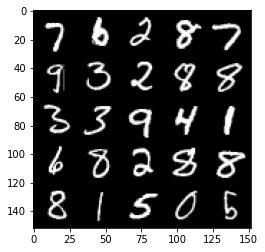

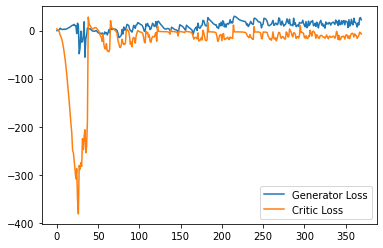

Step 7450: Generator loss: 17.991961534023286, critic loss: -14.0662175321579


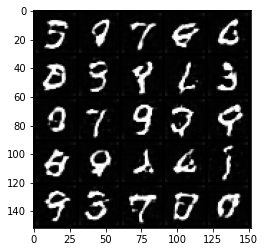

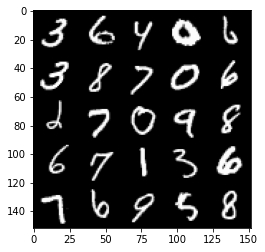

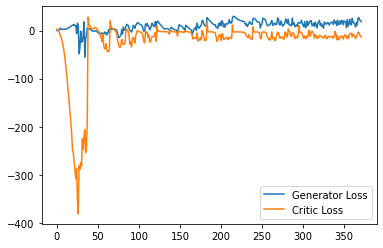

Step 7500: Generator loss: 12.673099438250064, critic loss: -12.714317544937137


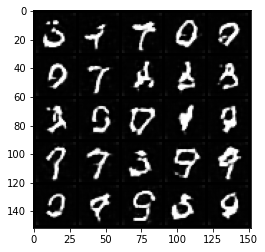

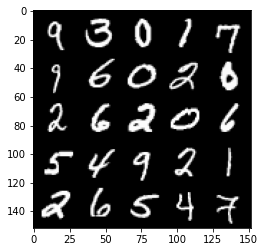

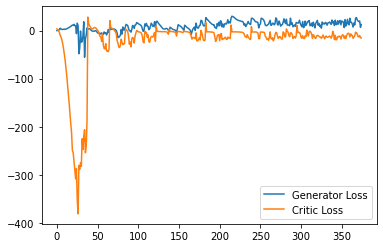

Step 7550: Generator loss: 17.98186006784439, critic loss: -15.94743560314179


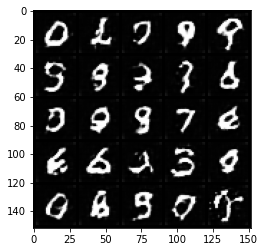

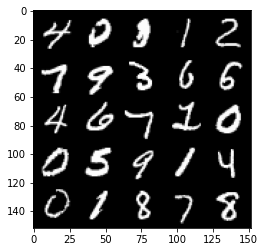

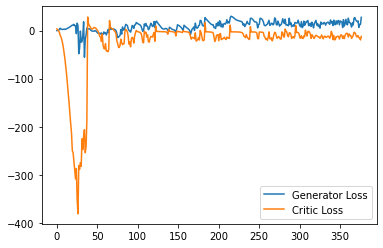

Step 7600: Generator loss: 19.49489977478981, critic loss: -14.31184733057022


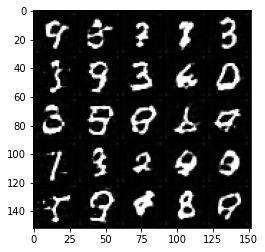

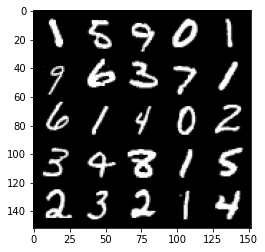

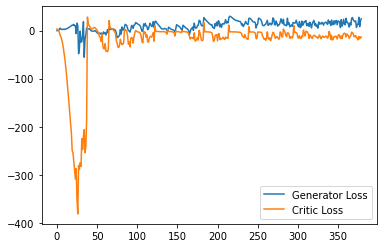

Step 7650: Generator loss: 14.249439458847046, critic loss: -16.813250197410586


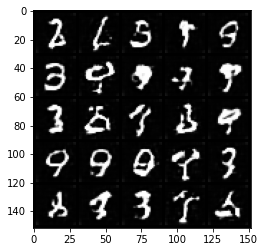

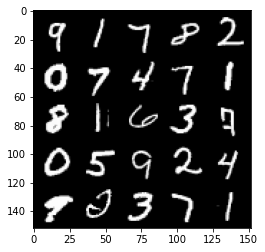

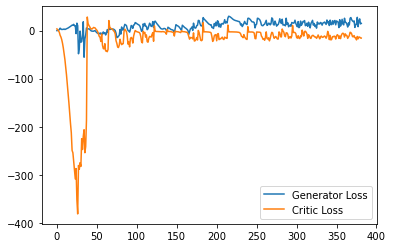

Step 7700: Generator loss: 15.48607640862465, critic loss: -16.310175411224364


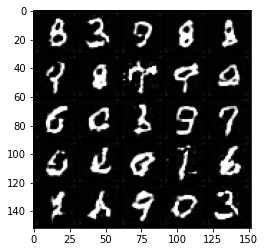

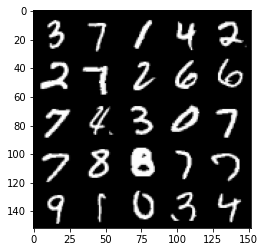

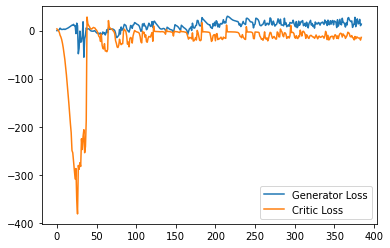

Step 7750: Generator loss: 19.592246750593187, critic loss: -8.776652190208432


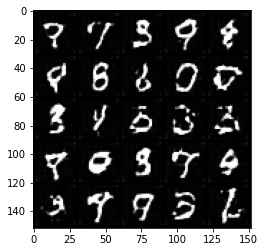

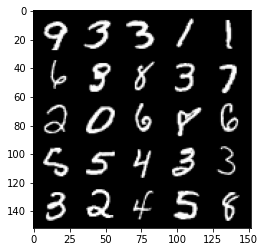

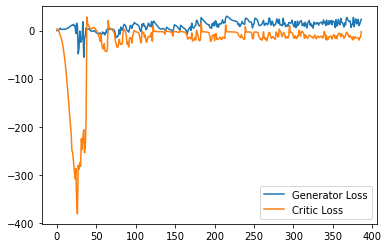

Step 7800: Generator loss: 16.08743236541748, critic loss: -11.669533064365387


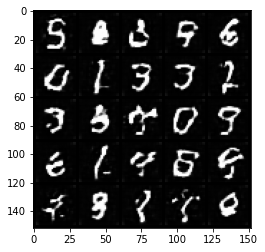

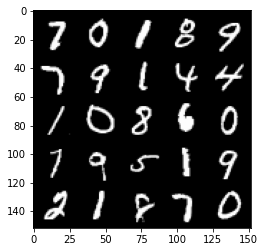

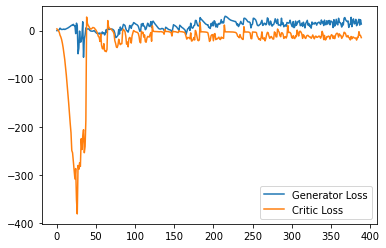

Step 7850: Generator loss: 15.937923115789891, critic loss: -15.706819402694697


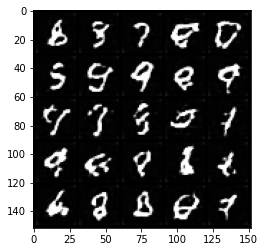

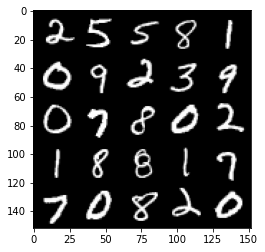

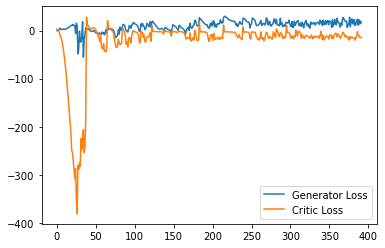

Step 7900: Generator loss: 20.333989844322204, critic loss: -9.905707644462582


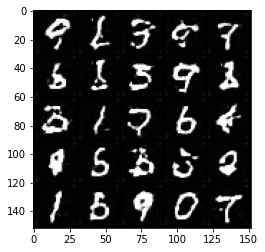

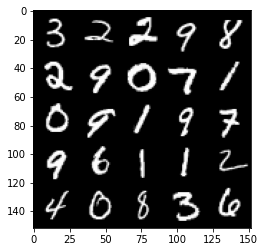

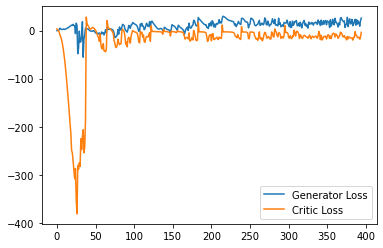

Step 7950: Generator loss: 21.89642409324646, critic loss: -13.669639304161073


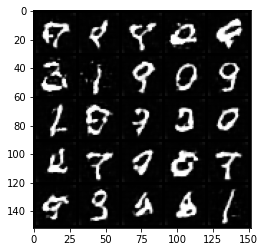

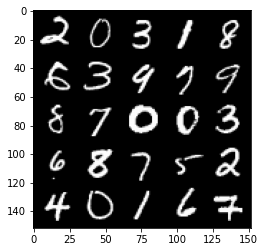

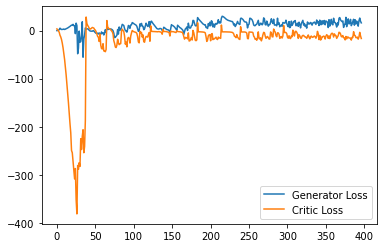

Step 8000: Generator loss: 16.367226536273957, critic loss: -16.998579051971436


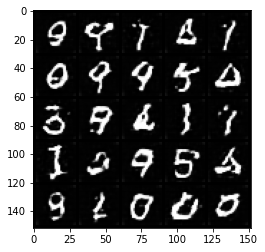

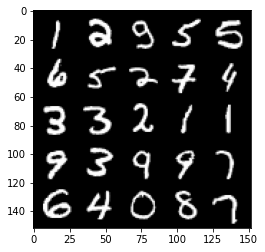

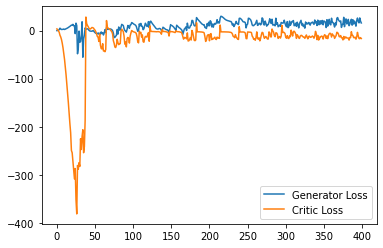

Step 8050: Generator loss: 15.553232086896896, critic loss: -8.742762336730957


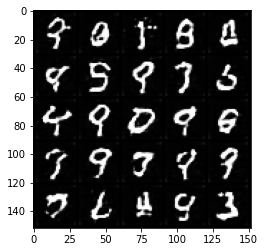

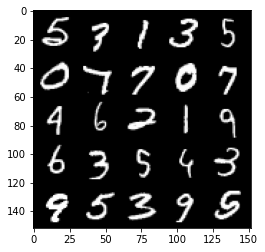

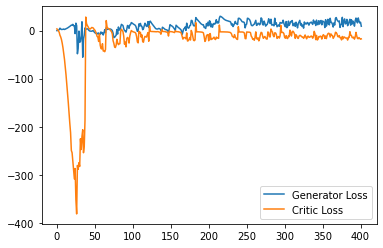

Step 8100: Generator loss: 26.002695541381836, critic loss: -4.605635760307311


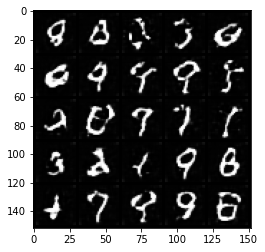

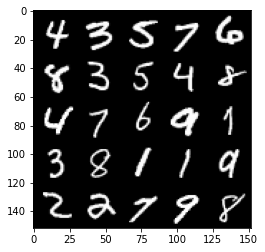

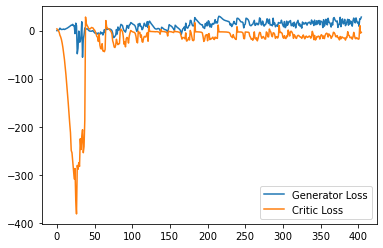

Step 8150: Generator loss: 17.415384839177133, critic loss: -11.620790191173551


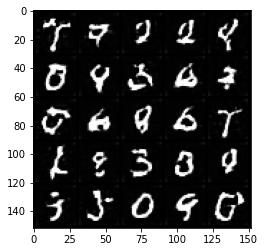

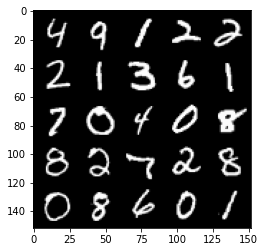

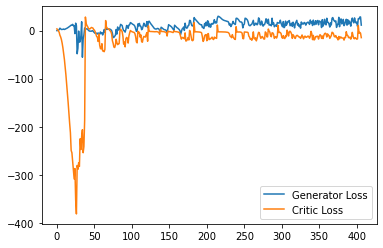

Step 8200: Generator loss: 24.48146195948124, critic loss: -9.254765949726105


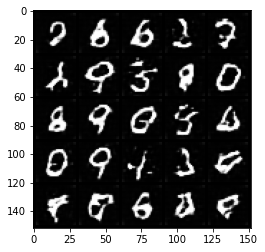

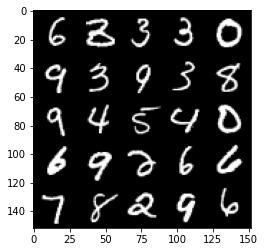

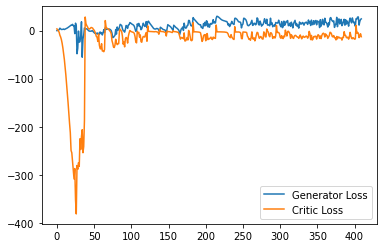

Step 8250: Generator loss: 18.22912317574024, critic loss: -13.762314230918882


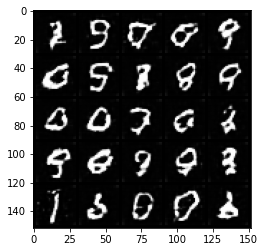

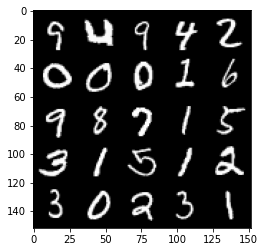

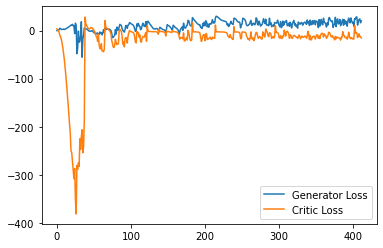

Step 8300: Generator loss: 20.843233022093774, critic loss: -12.602190824508666


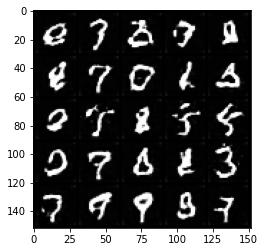

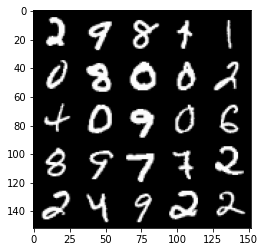

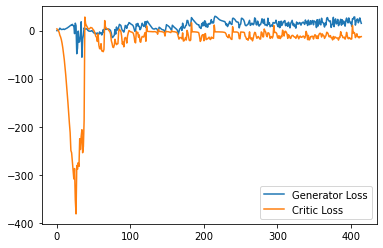

Step 8350: Generator loss: 21.665091683864592, critic loss: -9.907524163246155


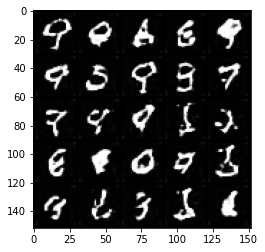

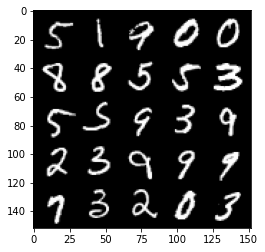

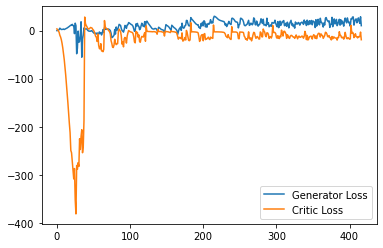

Step 8400: Generator loss: 13.932129157185555, critic loss: -14.900796619653704


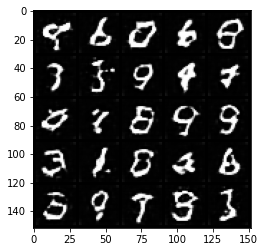

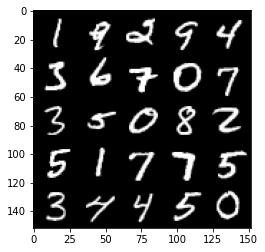

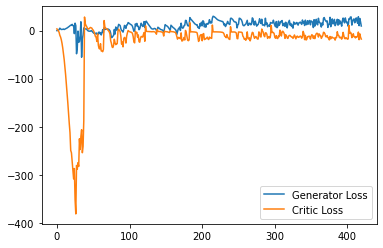

Step 8450: Generator loss: 15.577968559265138, critic loss: -15.528868315696718


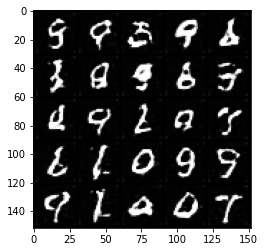

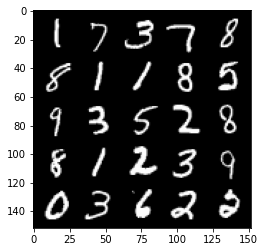

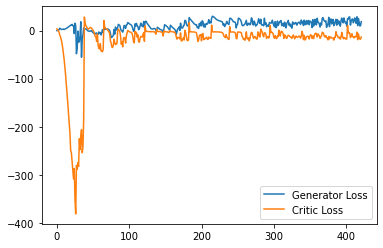

Step 8500: Generator loss: 15.793511381149292, critic loss: -16.963480578422544


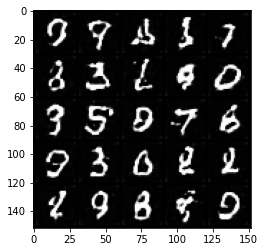

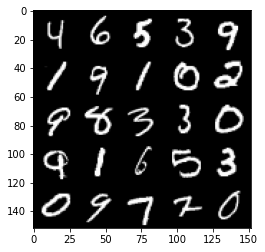

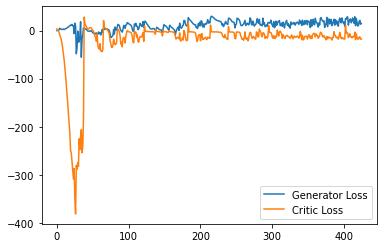

Step 8550: Generator loss: 22.53289772748947, critic loss: -8.819030886173246


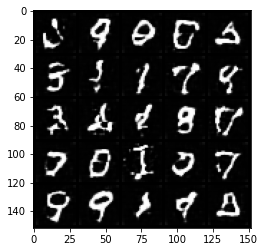

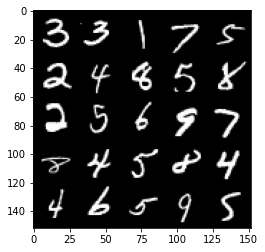

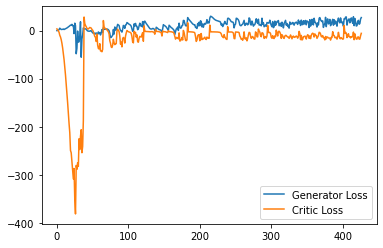

Step 8600: Generator loss: 13.816449049860239, critic loss: -16.472412050247193


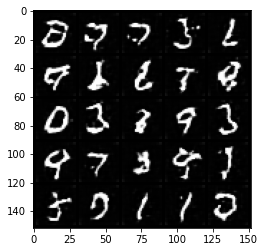

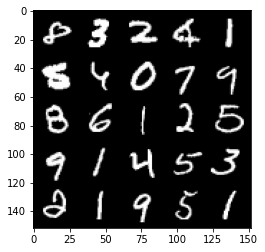

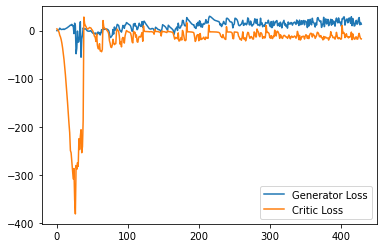

Step 8650: Generator loss: 19.173991962969303, critic loss: -12.075637292861941


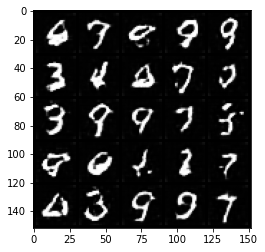

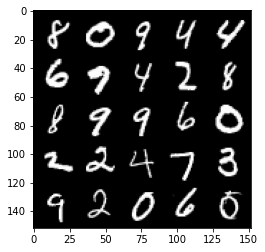

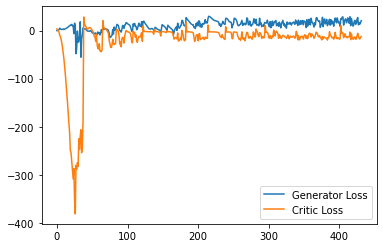

Step 8700: Generator loss: 16.503891460895538, critic loss: -17.733909958839416


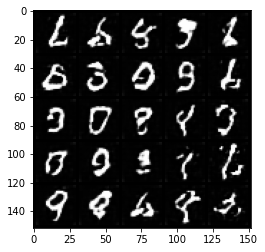

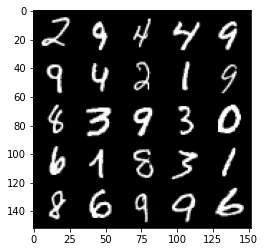

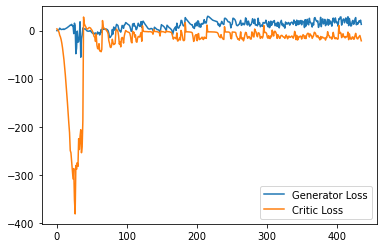

Step 8750: Generator loss: 13.47760125592351, critic loss: -12.856193877696992


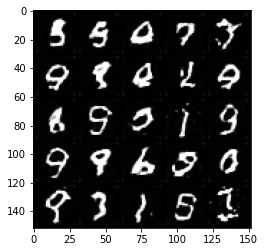

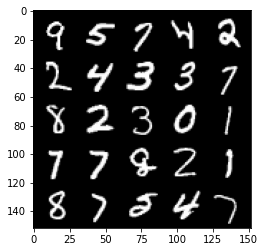

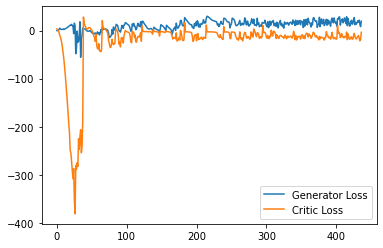

Step 8800: Generator loss: 15.062357275485992, critic loss: -16.585470013141638


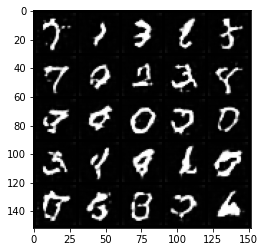

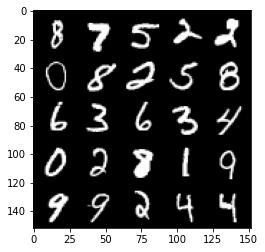

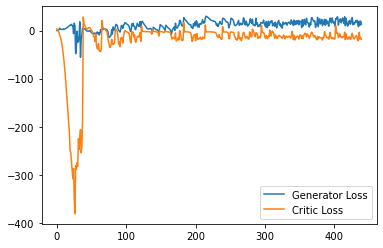

Step 8850: Generator loss: 18.23171716094017, critic loss: -14.42461933422089


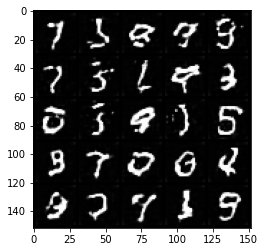

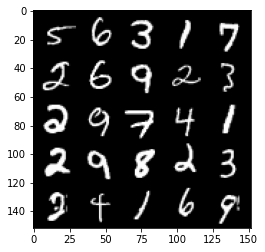

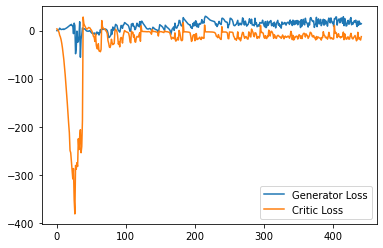

Step 8900: Generator loss: 22.893525295257568, critic loss: -12.392392760276795


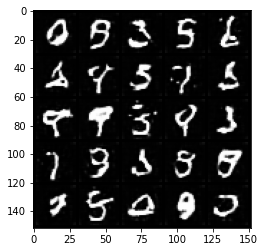

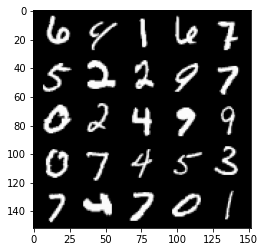

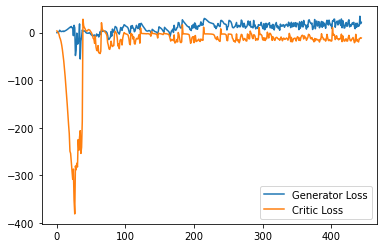

Step 8950: Generator loss: 19.25113226801157, critic loss: -10.714884639739992


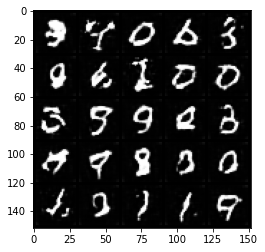

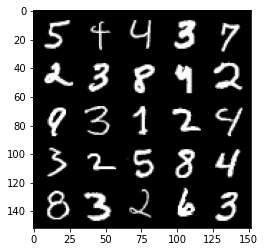

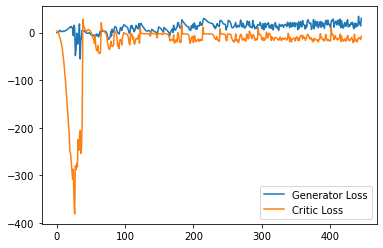

Step 9000: Generator loss: 19.73879521548748, critic loss: -7.611838184356688


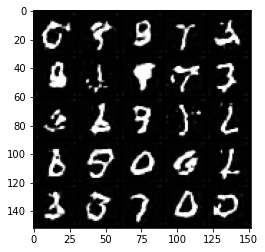

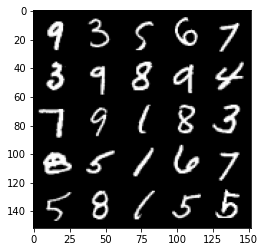

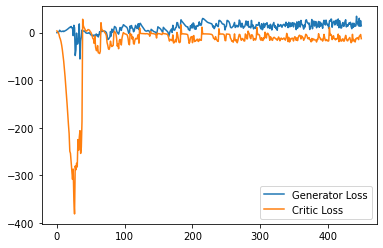

Step 9050: Generator loss: 21.926120543479918, critic loss: -9.207847681522368


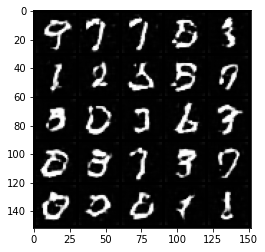

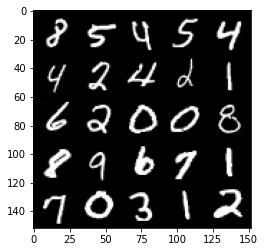

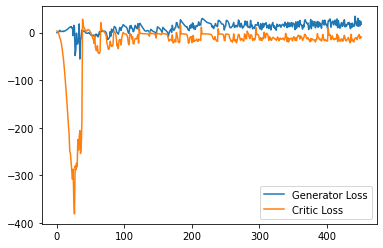

Step 9100: Generator loss: 15.927154812812805, critic loss: -13.23934917497635


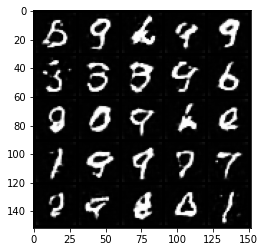

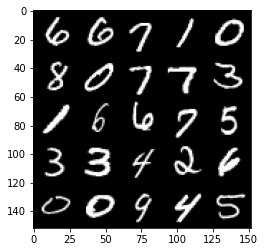

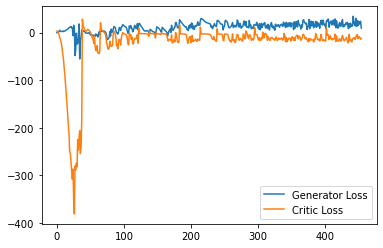

Step 9150: Generator loss: 11.481645672321319, critic loss: -14.217003506183621


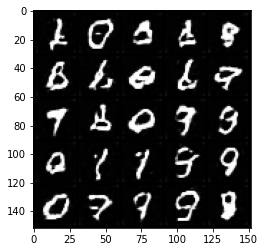

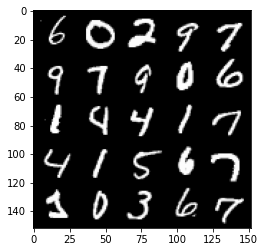

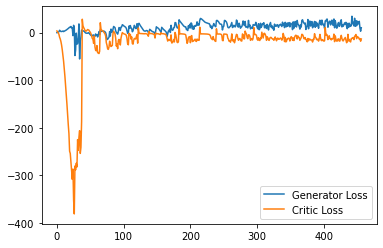

Step 9200: Generator loss: 11.631377292722464, critic loss: -14.792027567386626


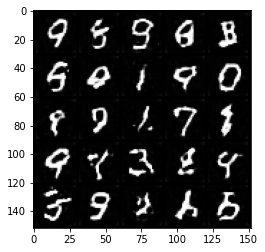

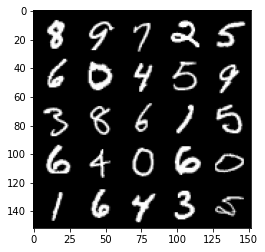

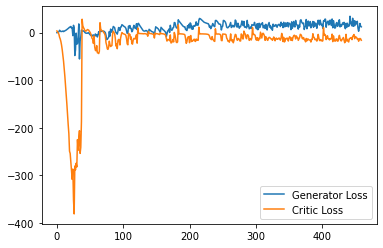

Step 9250: Generator loss: 19.032101444602013, critic loss: -14.475560947418215


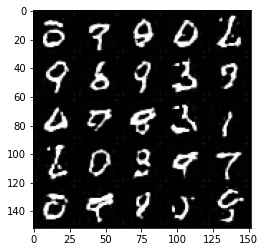

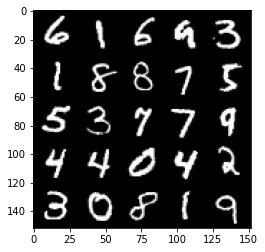

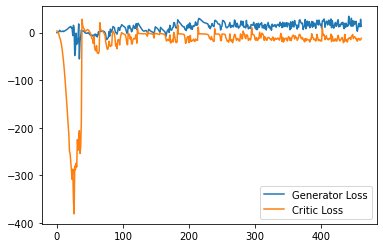

Step 9300: Generator loss: 13.99715413093567, critic loss: -17.402645104408265


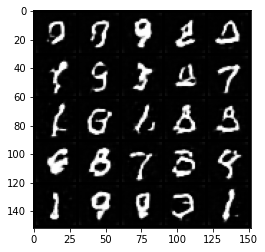

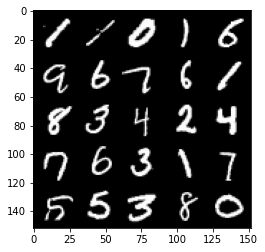

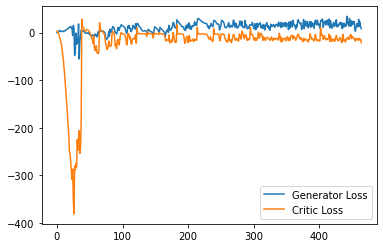

Step 9350: Generator loss: 12.7294617035985, critic loss: -13.856258309841156


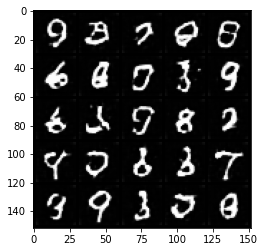

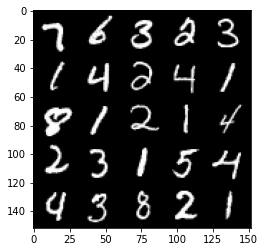

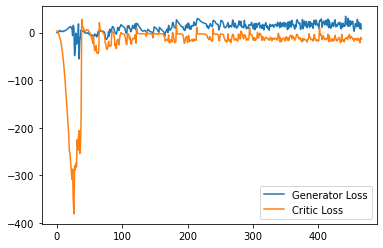

Step 9400: Generator loss: 15.80585462808609, critic loss: -15.692825872898101


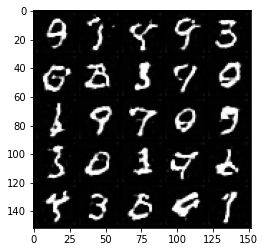

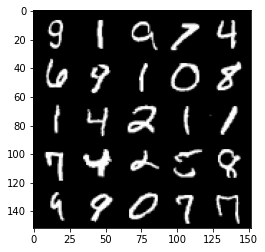

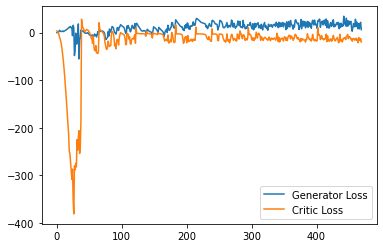

Step 9450: Generator loss: 22.219858798980713, critic loss: -9.899823166847229


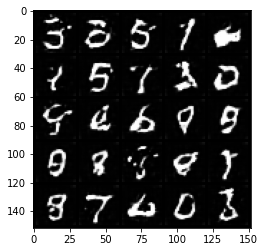

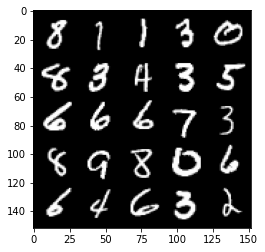

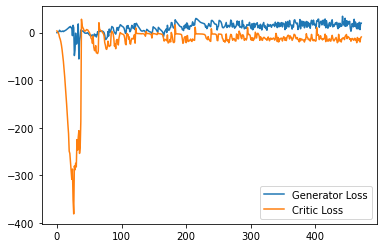

Step 9500: Generator loss: 11.809397473335267, critic loss: -17.56853022766113


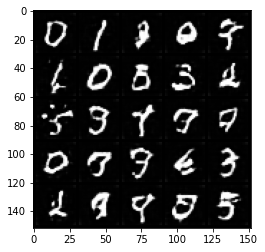

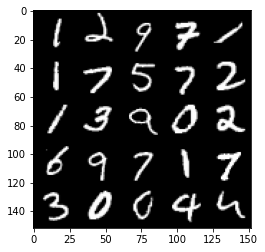

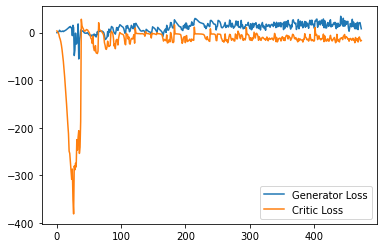

Step 9550: Generator loss: 20.21790677905083, critic loss: -13.093862149238587


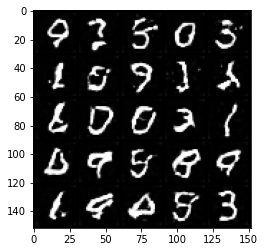

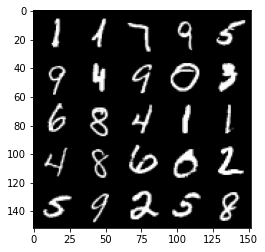

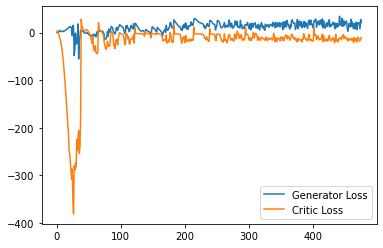

Step 9600: Generator loss: 9.467629562616349, critic loss: -20.35912425327301


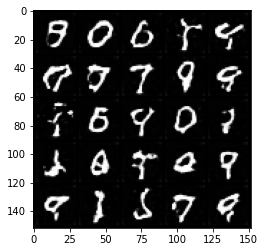

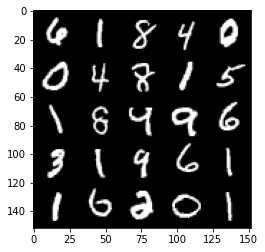

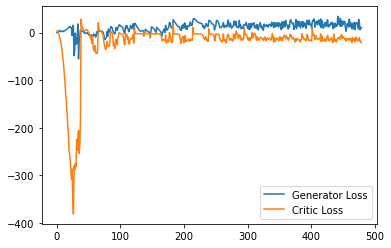

Step 9650: Generator loss: 23.954178161621094, critic loss: -9.26439872264862


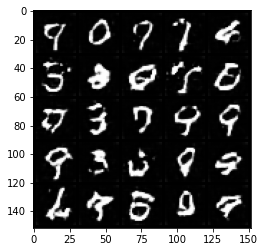

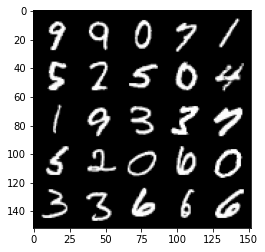

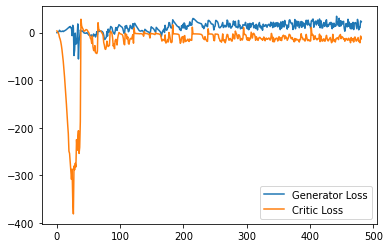

Step 9700: Generator loss: 12.168141118884087, critic loss: -13.665905305147174


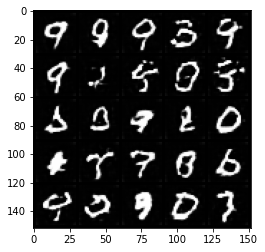

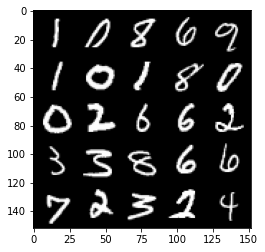

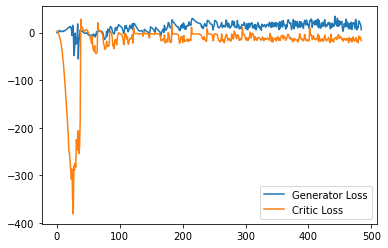

Step 9750: Generator loss: 17.71062534570694, critic loss: -5.147158207893373


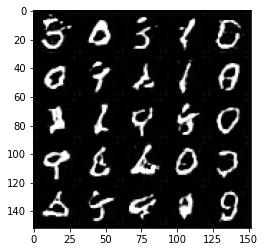

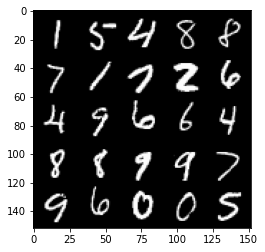

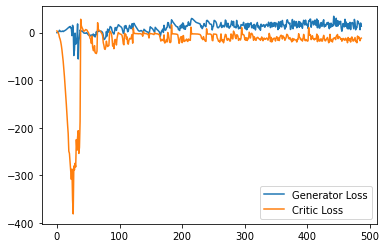

Step 9800: Generator loss: 12.032567397654056, critic loss: -15.882323373317718


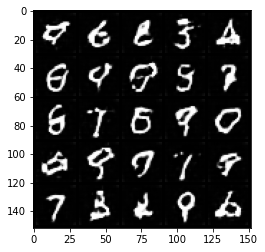

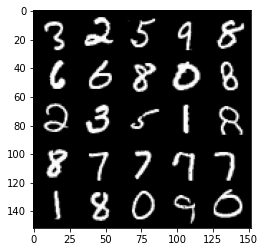

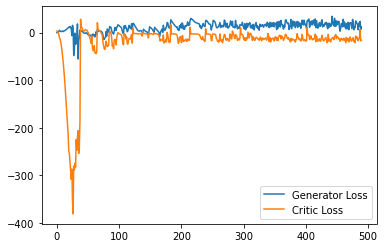

Step 9850: Generator loss: 20.804055714607237, critic loss: -13.322718482971196


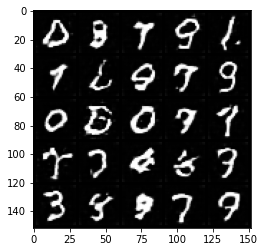

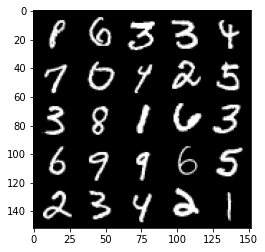

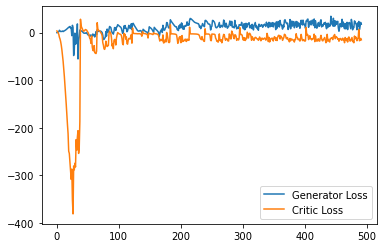

Step 9900: Generator loss: 14.488495932221413, critic loss: -16.42891749167443


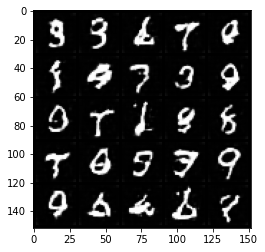

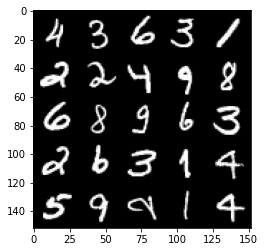

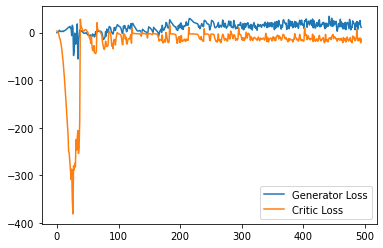

Step 9950: Generator loss: 25.30589199066162, critic loss: -8.016828411579134


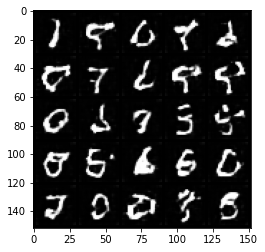

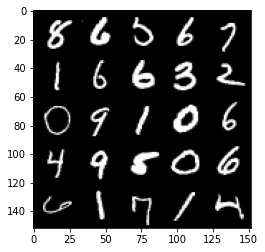

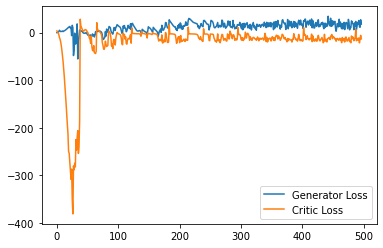

Step 10000: Generator loss: 14.105697069168091, critic loss: -14.395317160129546


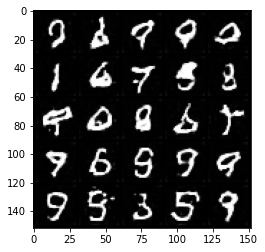

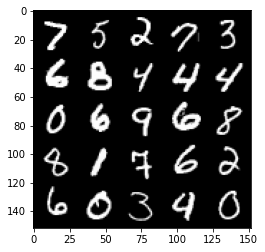

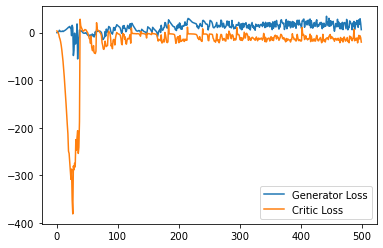

Step 10050: Generator loss: 23.224661712646483, critic loss: -11.856342984199522


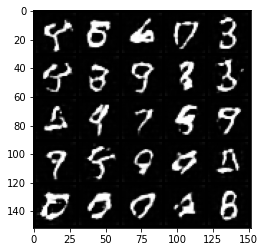

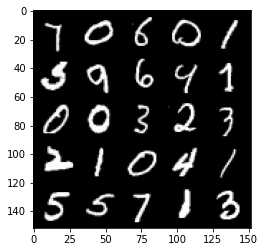

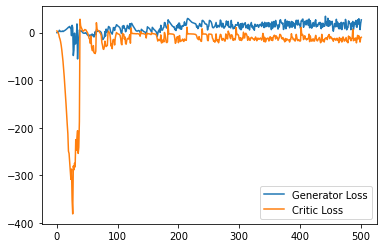

Step 10100: Generator loss: 20.19054814338684, critic loss: -6.934392229557037


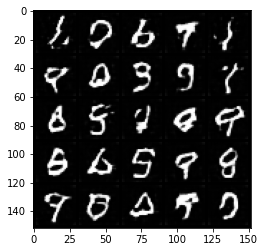

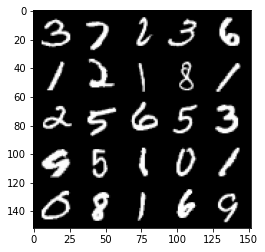

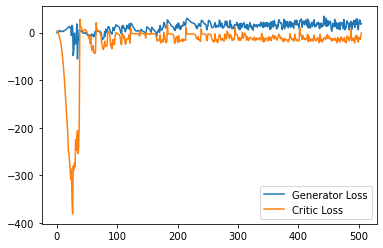

Step 10150: Generator loss: 21.476298248171805, critic loss: -9.040080739021304


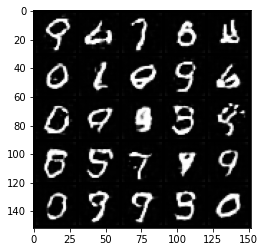

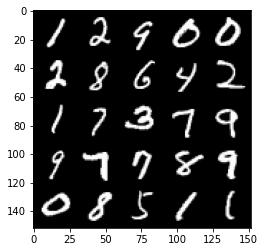

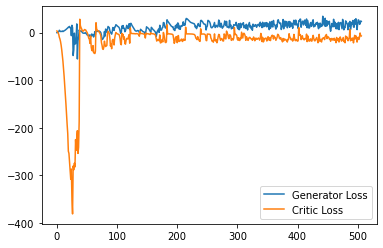

Step 10200: Generator loss: 24.682768087387085, critic loss: -12.747593418121337


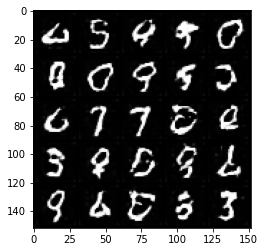

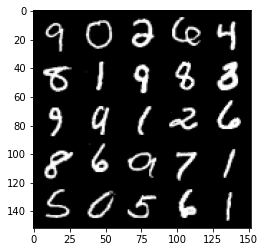

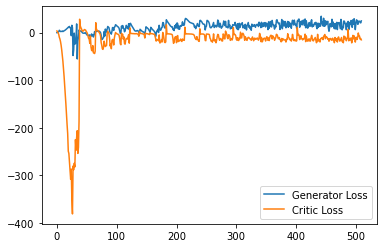

Step 10250: Generator loss: 20.2810608959198, critic loss: -11.948130939960478


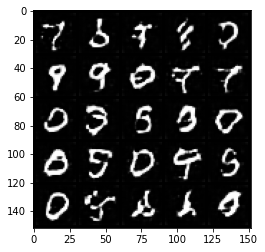

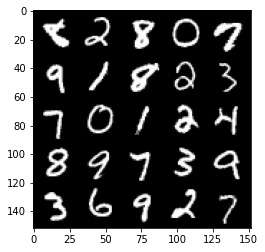

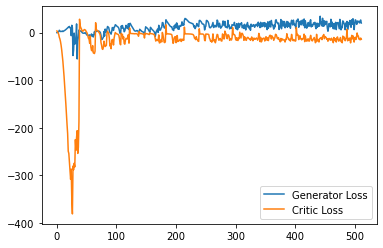

Step 10300: Generator loss: 20.53683026611805, critic loss: -11.867569596052165


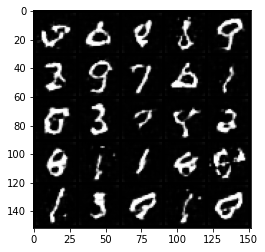

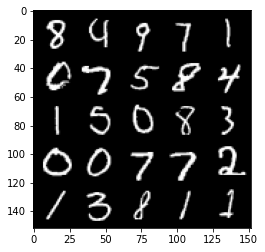

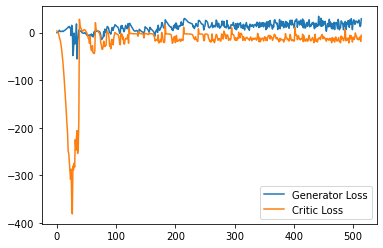

Step 10350: Generator loss: 18.196933335065843, critic loss: -11.265771796226499


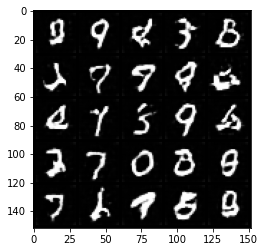

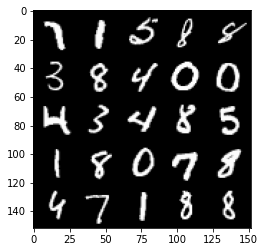

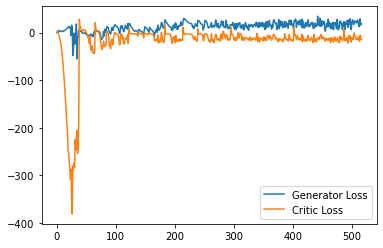

Step 10400: Generator loss: 20.020558380931615, critic loss: -8.736022459983825


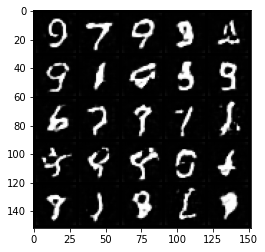

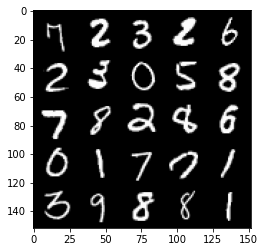

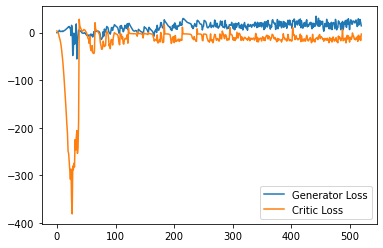

Step 10450: Generator loss: 19.437273211479187, critic loss: -9.859340245246887


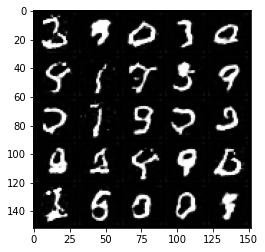

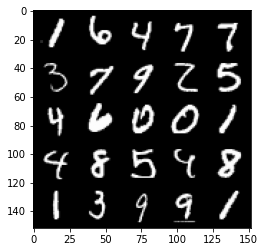

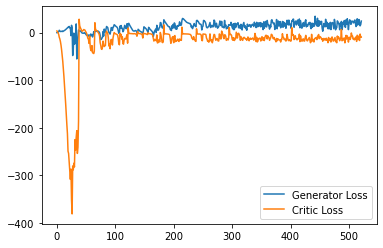

Step 10500: Generator loss: 21.054104380607605, critic loss: -8.7849425675869


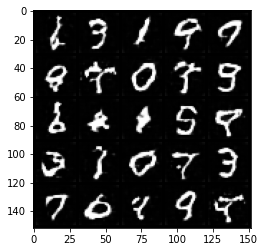

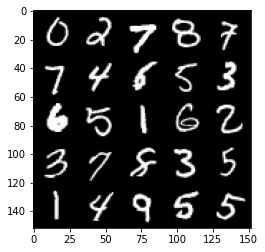

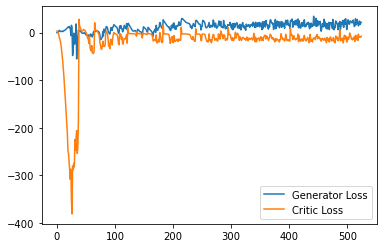

Step 10550: Generator loss: 17.359023637771607, critic loss: -6.150558300018313


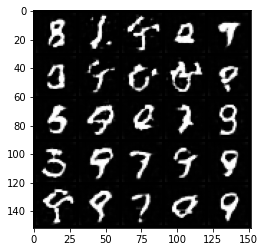

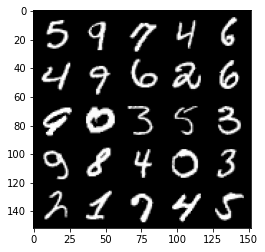

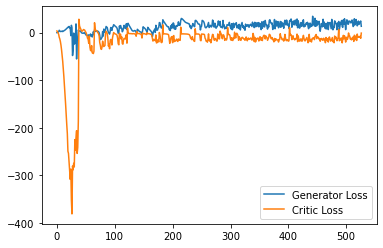

Step 10600: Generator loss: 22.443486366271973, critic loss: -11.595904984951016


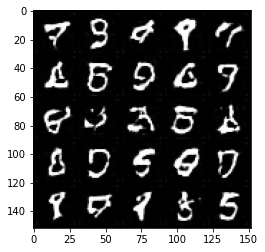

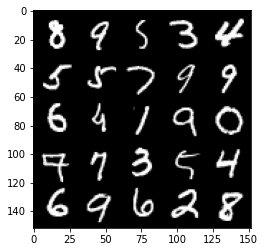

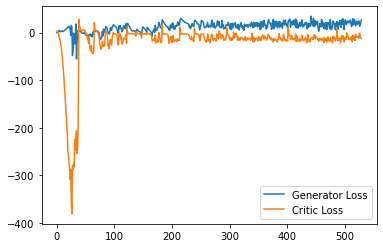

Step 10650: Generator loss: 12.403125265836715, critic loss: -14.734169090747828


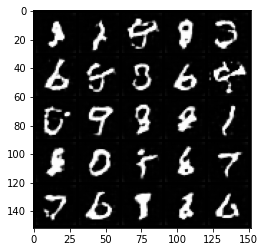

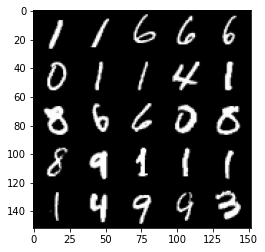

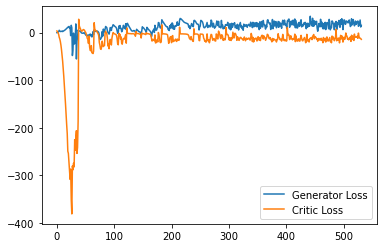

Step 10700: Generator loss: 12.149151901006698, critic loss: -25.158498900413505


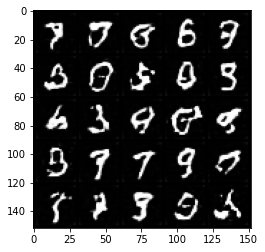

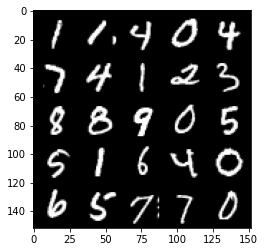

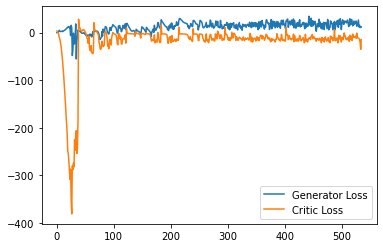

Step 10750: Generator loss: 20.779687056541444, critic loss: -6.527344022989272


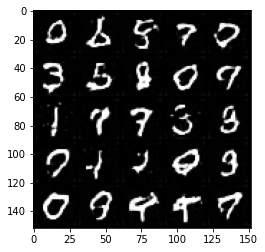

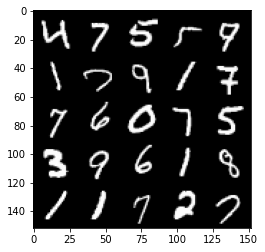

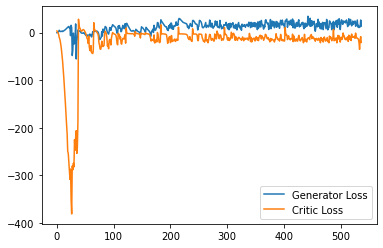

Step 10800: Generator loss: 13.933804916143417, critic loss: -16.327227543354038


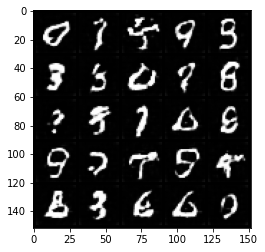

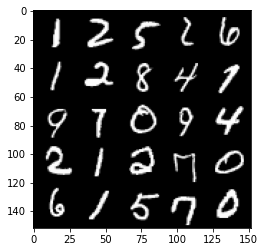

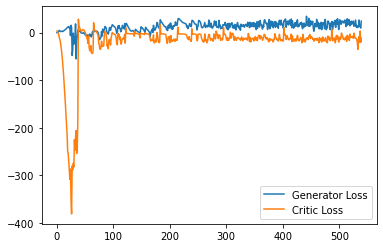

Step 10850: Generator loss: 22.27715593069792, critic loss: -9.113643744945527


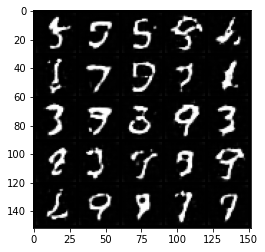

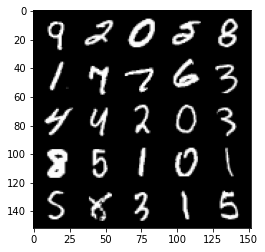

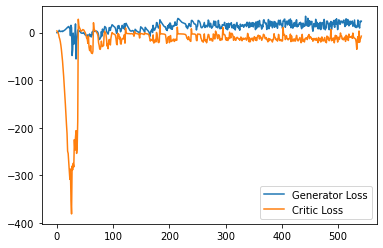

Step 10900: Generator loss: 23.71717710137367, critic loss: -13.106776210308077


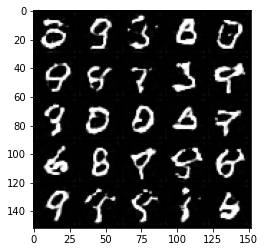

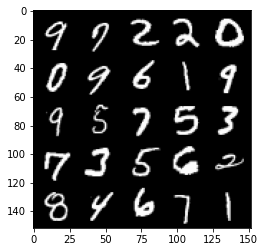

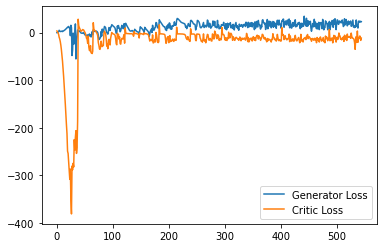

Step 10950: Generator loss: 16.43613207027316, critic loss: -11.752322708129885


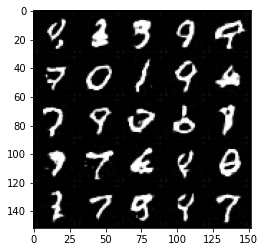

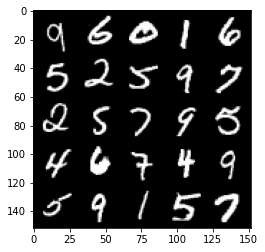

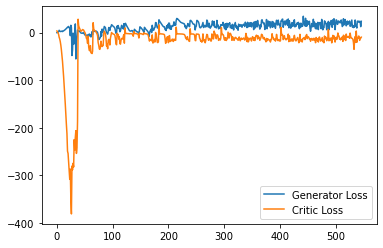

Step 11000: Generator loss: 19.198225932121275, critic loss: -15.740065914869309


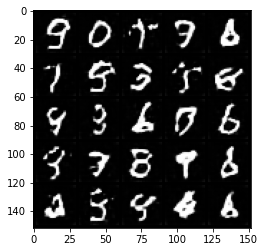

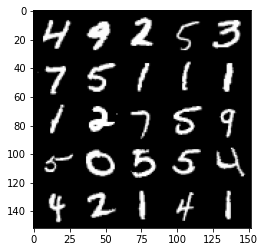

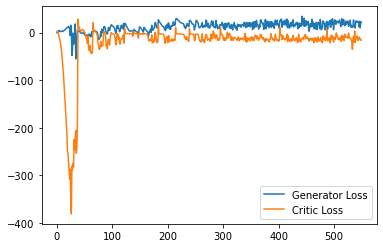

Step 11050: Generator loss: 19.33782800078392, critic loss: -3.3890101304054245


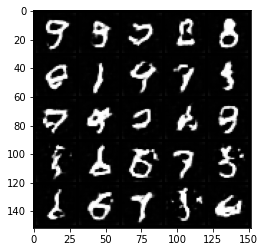

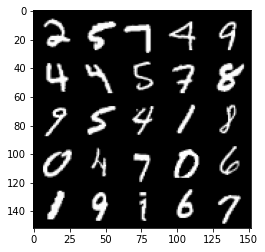

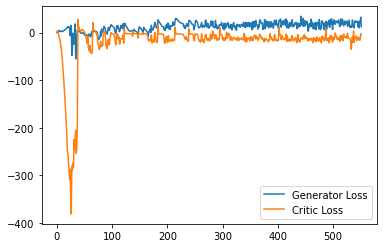

Step 11100: Generator loss: 15.725470821857453, critic loss: -13.435383574962618


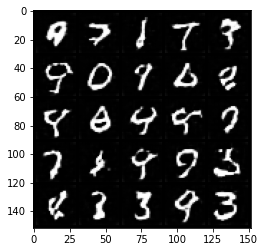

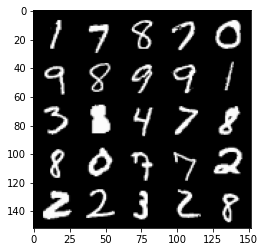

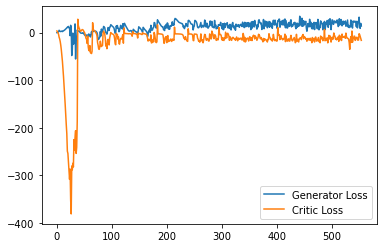

Step 11150: Generator loss: 24.34725187063217, critic loss: -11.828599415779111


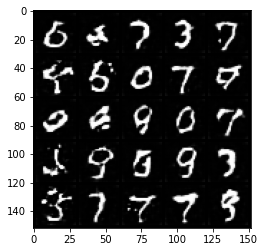

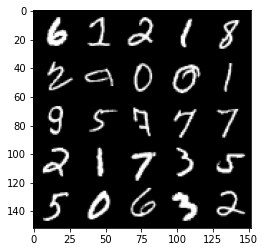

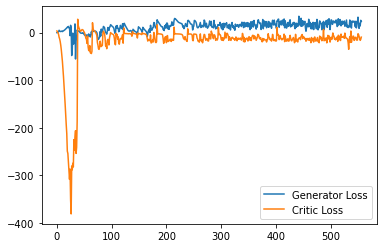

Step 11200: Generator loss: 16.766841447353364, critic loss: -14.765674237251288


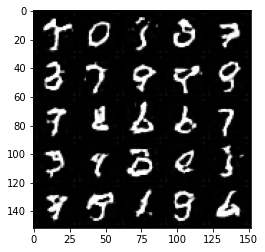

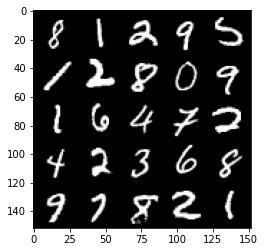

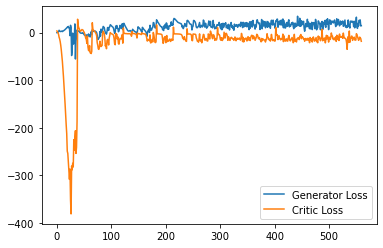

Step 11250: Generator loss: 20.12795394718647, critic loss: -15.022923993587494


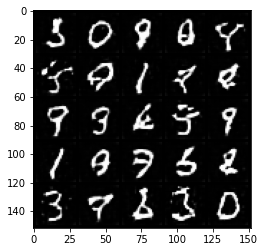

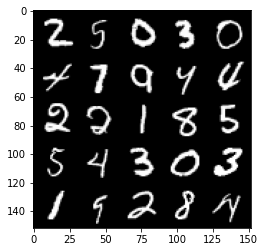

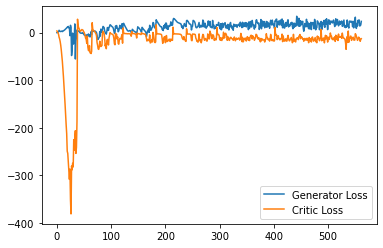

Step 11300: Generator loss: 21.01133203625679, critic loss: -8.217191555023195


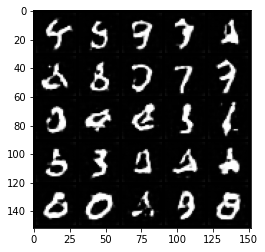

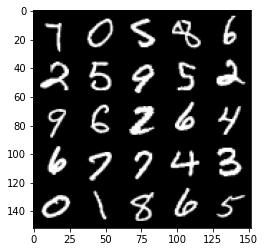

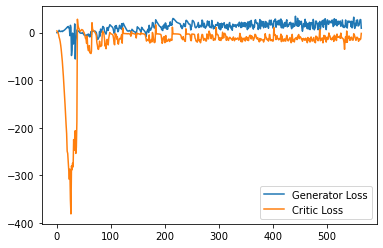

Step 11350: Generator loss: 20.120267884135245, critic loss: -10.697455387592315


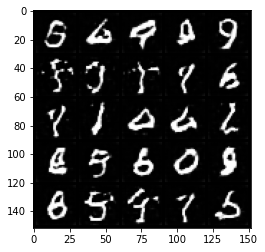

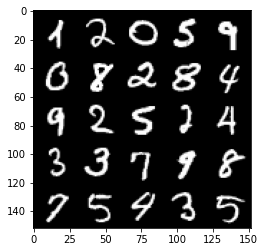

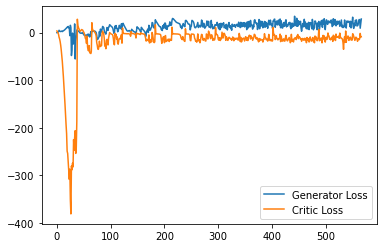

Step 11400: Generator loss: 19.893358075618742, critic loss: -12.31929157733917


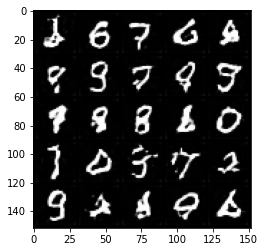

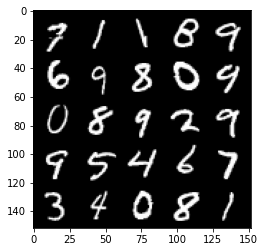

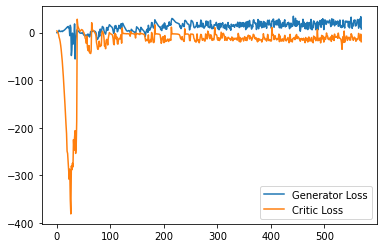

Step 11450: Generator loss: 24.32246716976166, critic loss: -15.169204815387735


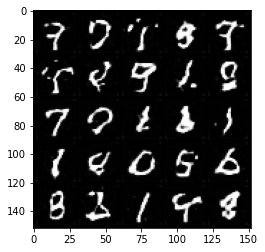

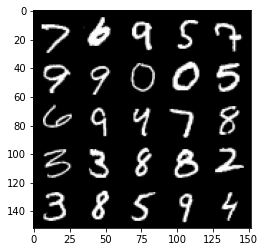

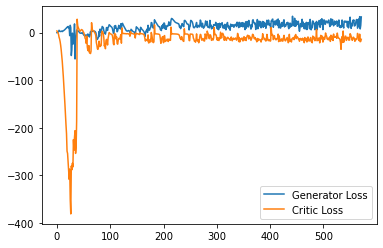

Step 11500: Generator loss: 23.359604206085205, critic loss: -10.825412304878238


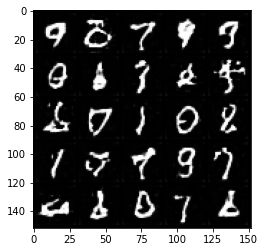

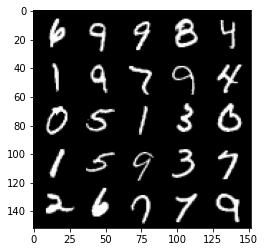

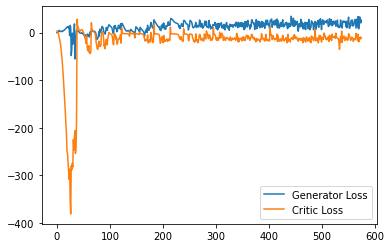

Step 11550: Generator loss: 12.699899438619614, critic loss: -20.43581404542923


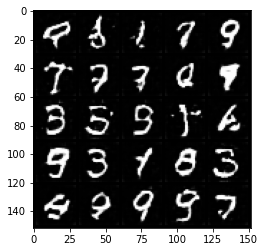

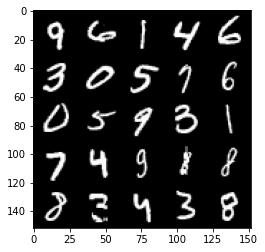

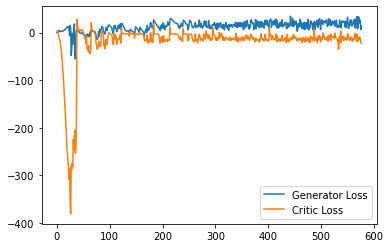

Step 11600: Generator loss: 15.8684534573555, critic loss: -17.510642534494398


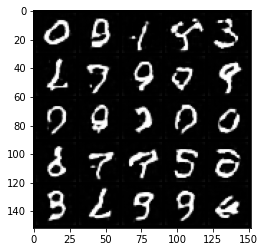

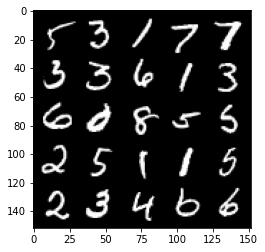

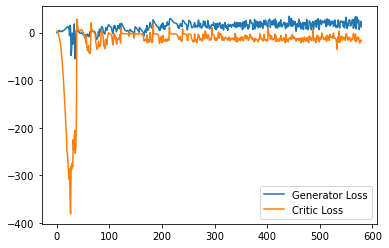

Step 11650: Generator loss: 23.516867023706435, critic loss: -6.196446231842042


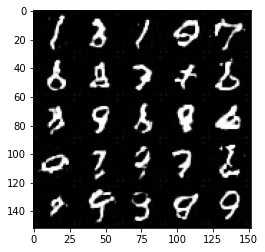

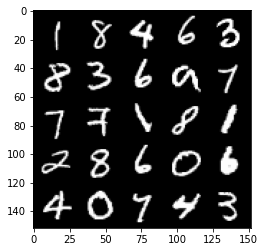

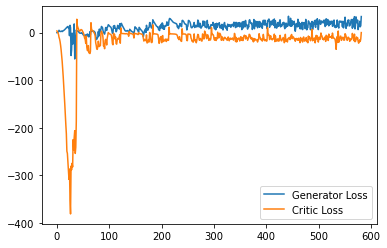

Step 11700: Generator loss: 26.098242435455322, critic loss: -12.998325574874876


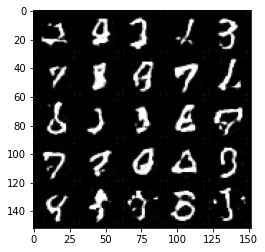

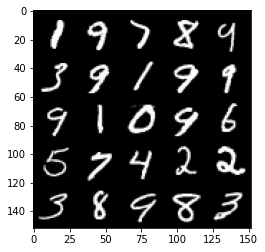

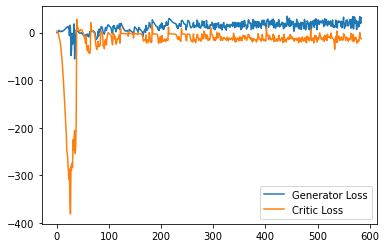

Step 11750: Generator loss: 19.644035658836366, critic loss: -12.334580991268156


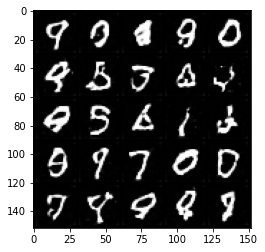

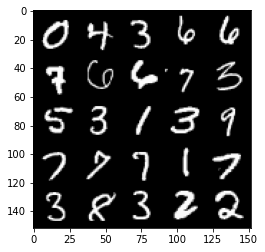

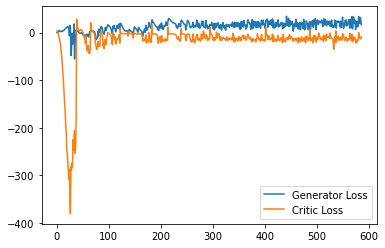

Step 11800: Generator loss: 19.95263054549694, critic loss: -13.585259047508238


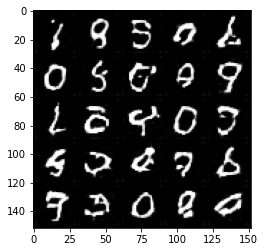

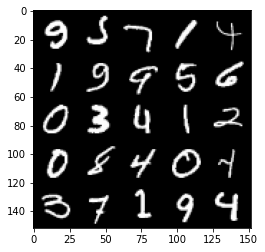

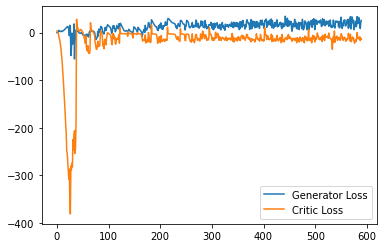

Step 11850: Generator loss: 22.004062271118165, critic loss: -12.262851005554198


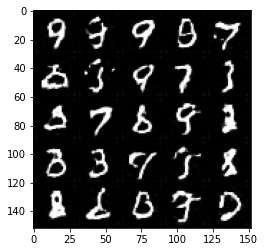

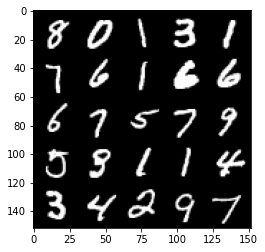

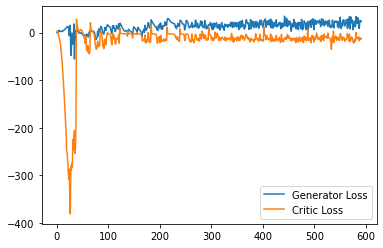

Step 11900: Generator loss: 24.354061212539673, critic loss: -15.192737287998197


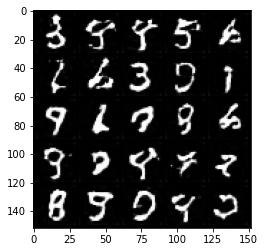

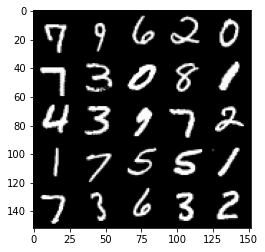

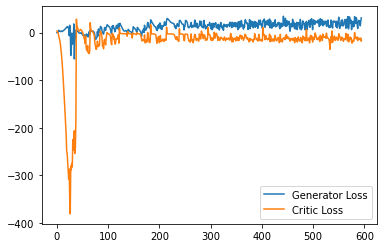

Step 11950: Generator loss: 18.658115379810333, critic loss: -10.471578610897065


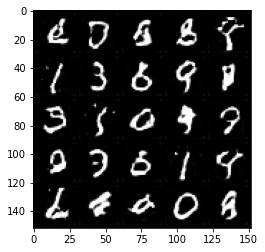

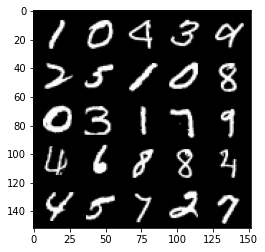

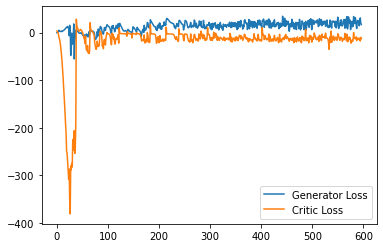

Step 12000: Generator loss: 20.884290792942046, critic loss: -6.621847640037537


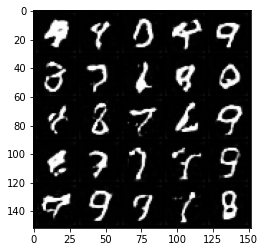

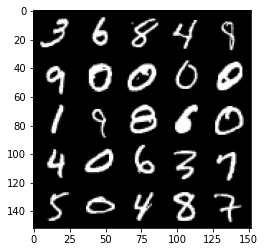

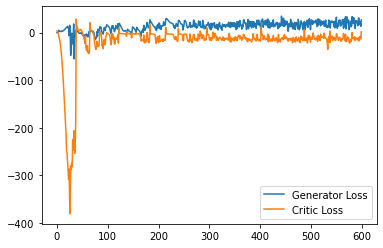

Step 12050: Generator loss: 20.654099411964417, critic loss: -13.92484321928024


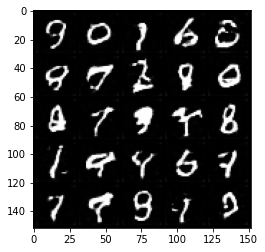

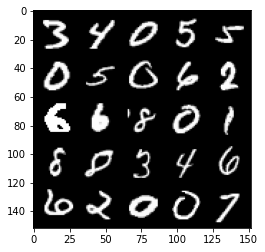

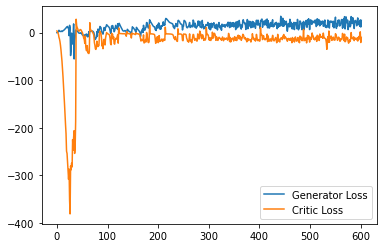

Step 12100: Generator loss: 23.46300129413605, critic loss: -14.934718442440039


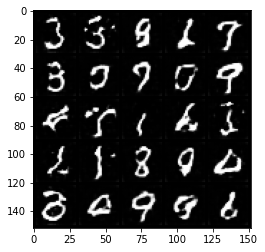

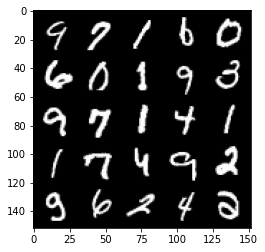

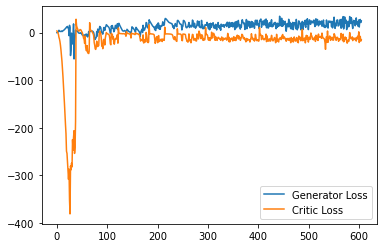

Step 12150: Generator loss: 27.091659412384033, critic loss: -11.858273473501203


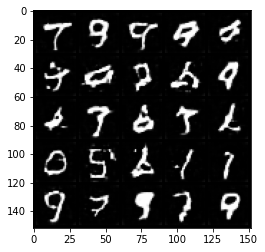

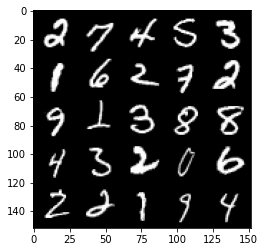

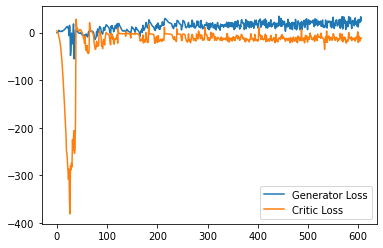

Step 12200: Generator loss: 21.499257345199585, critic loss: -10.97352041983605


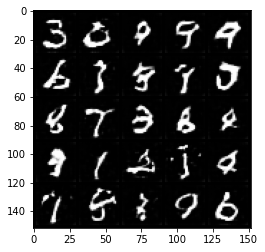

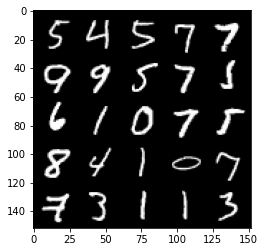

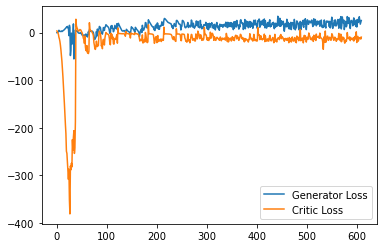

Step 12250: Generator loss: 18.617037127017976, critic loss: -13.806860633373265


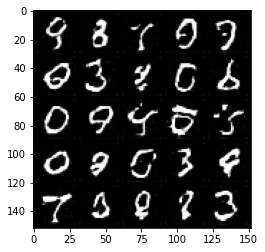

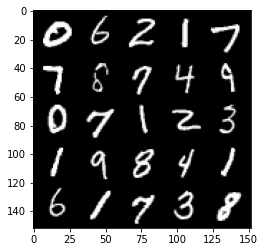

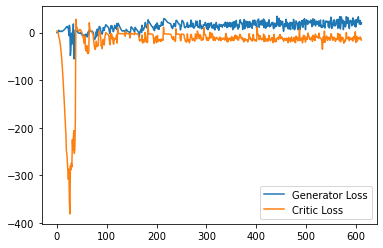

Step 12300: Generator loss: 24.735259120464324, critic loss: -2.9076170196533235


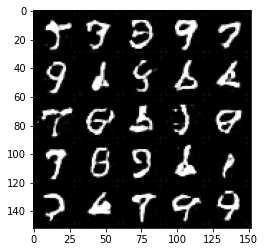

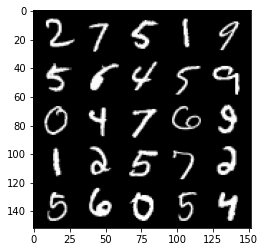

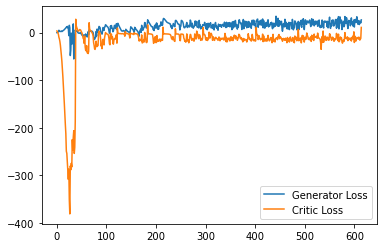

Step 12350: Generator loss: 18.875731619372964, critic loss: -13.265079029560091


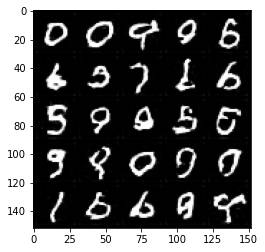

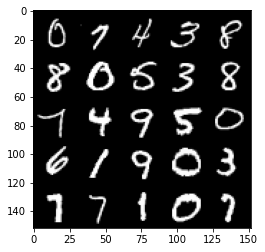

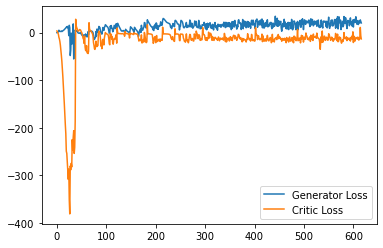

Step 12400: Generator loss: 23.52562216758728, critic loss: -11.361537028312682


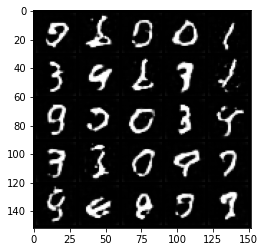

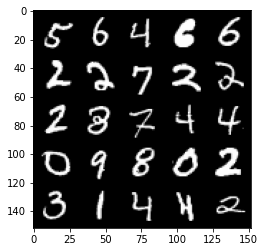

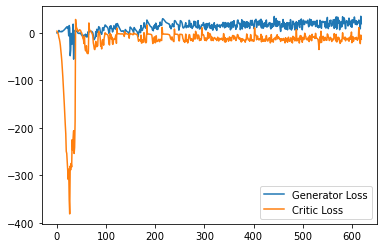

Step 12450: Generator loss: 22.608672928214073, critic loss: -12.613276699066159


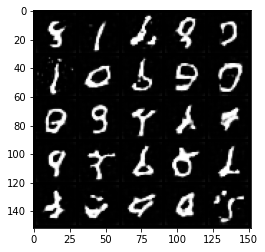

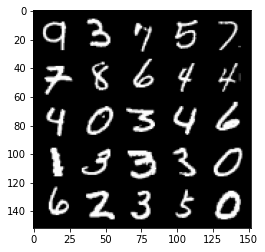

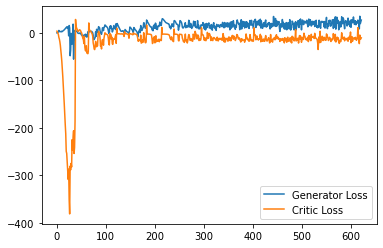

Step 12500: Generator loss: 30.54257873535156, critic loss: -11.128941781520842


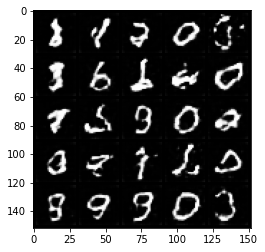

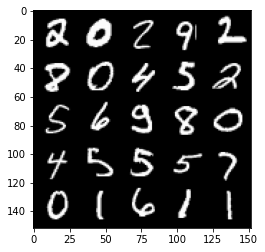

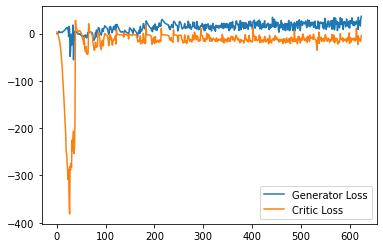

Step 12550: Generator loss: 18.777524409294127, critic loss: -15.362494236946107


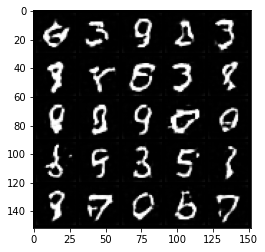

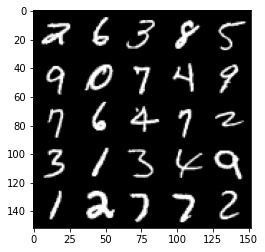

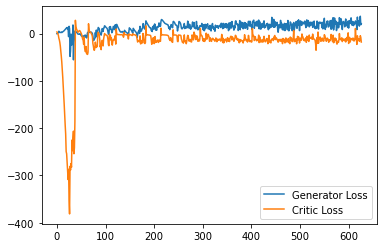

Step 12600: Generator loss: 27.358462460041046, critic loss: -14.129285958290104


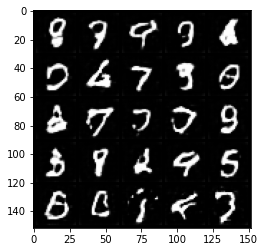

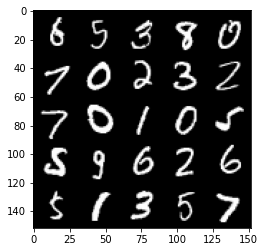

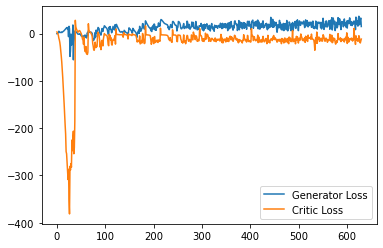

Step 12650: Generator loss: 27.804146480560302, critic loss: -14.079880200147628


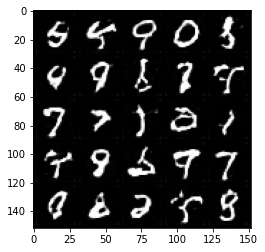

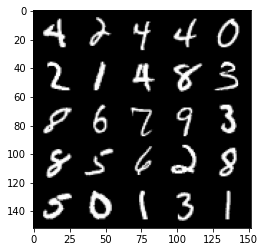

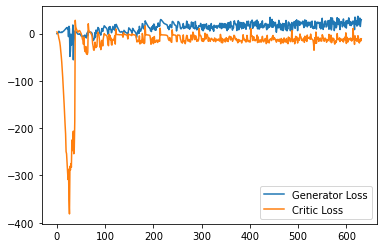

Step 12700: Generator loss: 22.756719653606414, critic loss: -16.04968571424484


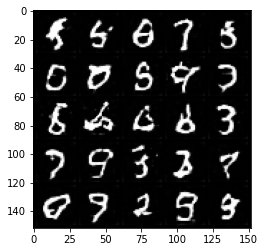

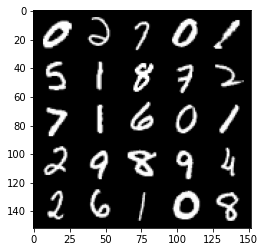

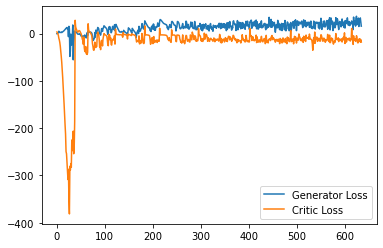

Step 12750: Generator loss: 30.305689783096312, critic loss: -0.5435746932029724


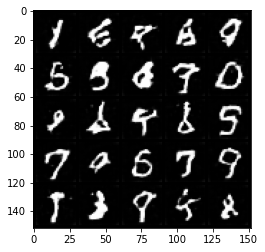

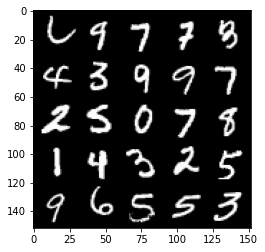

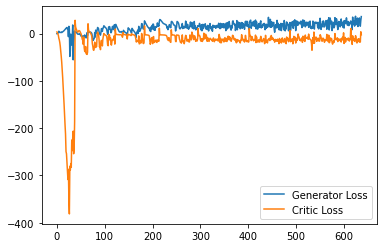

Step 12800: Generator loss: 15.857261770516635, critic loss: -14.327963713884358


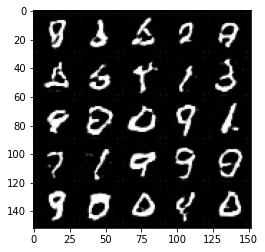

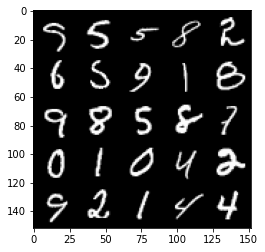

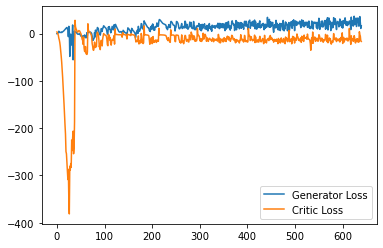

Step 12850: Generator loss: 29.21398150444031, critic loss: -11.201153985500333


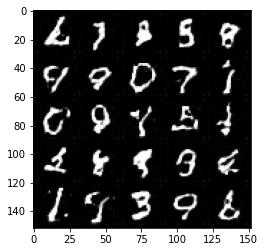

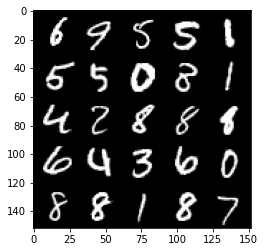

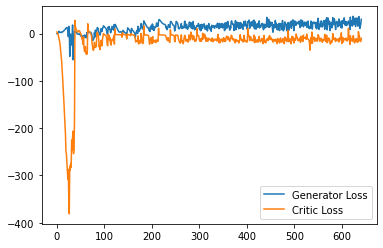

Step 12900: Generator loss: 24.055863037109376, critic loss: -11.364578059673311


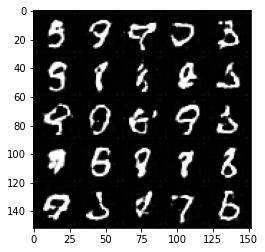

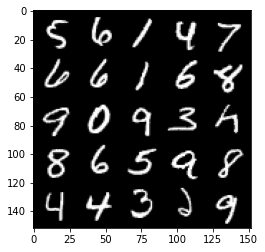

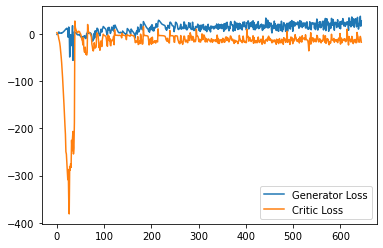

Step 12950: Generator loss: 29.507592606544495, critic loss: -10.138418108463288


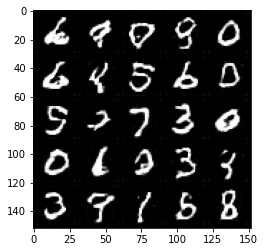

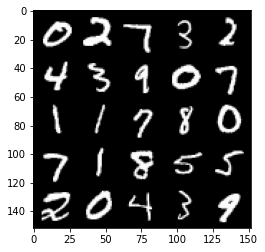

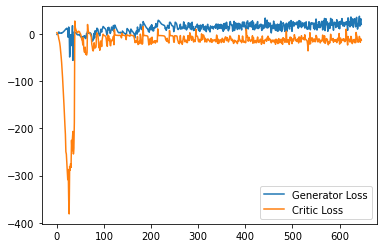

Step 13000: Generator loss: 24.67420643091202, critic loss: -6.6611067149639105


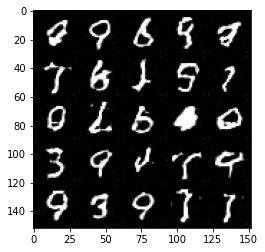

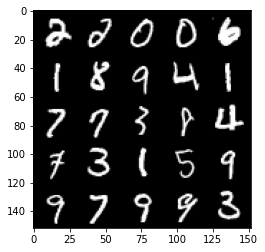

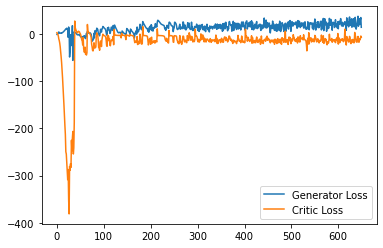

Step 13050: Generator loss: 18.9312731218338, critic loss: -18.746907855987548


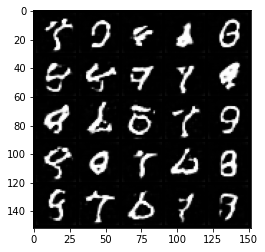

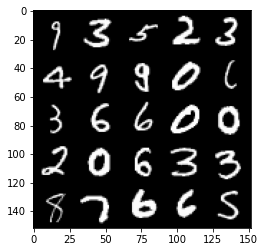

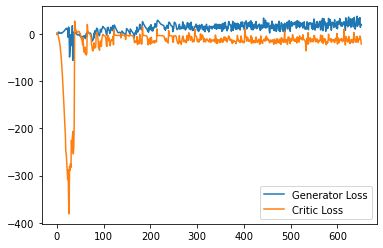

Step 13100: Generator loss: 30.91862787246704, critic loss: -12.852074532508855


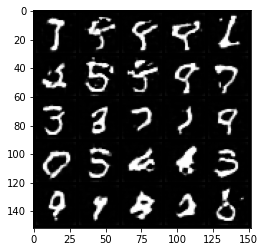

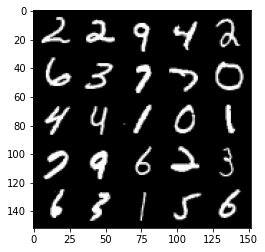

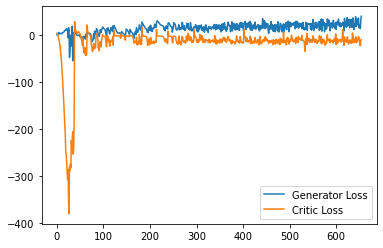

Step 13150: Generator loss: 21.60370413661003, critic loss: -17.4024139175415


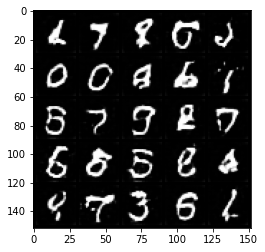

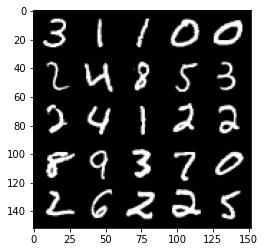

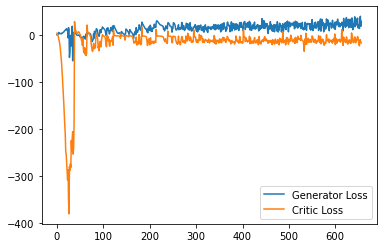

Step 13200: Generator loss: 24.355632363557817, critic loss: -16.15969272661209


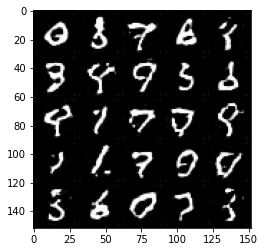

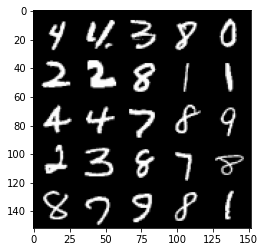

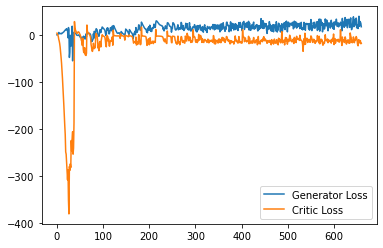

Step 13250: Generator loss: 25.846150078773498, critic loss: -16.794090028762813


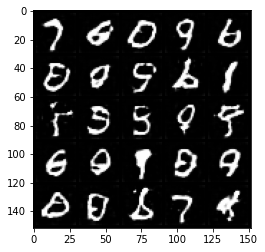

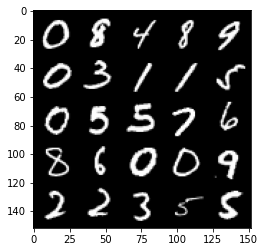

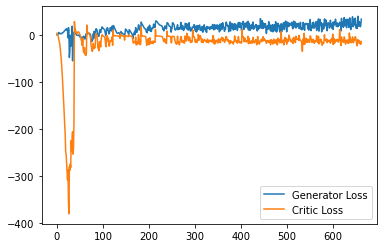

Step 13300: Generator loss: 25.323356383442878, critic loss: -16.8845684850216


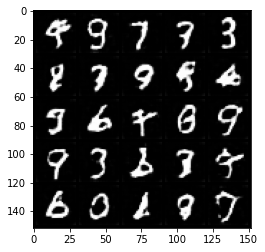

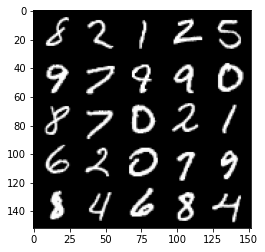

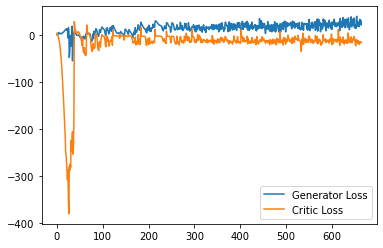

Step 13350: Generator loss: 26.685026113986968, critic loss: -11.259197461128235


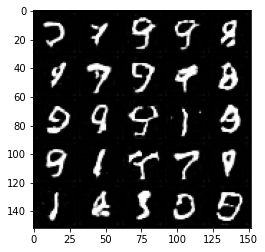

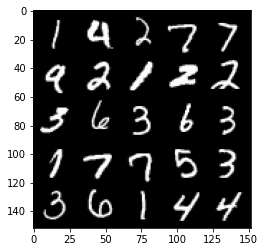

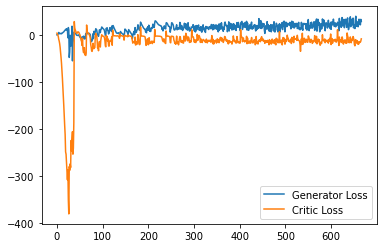

Step 13400: Generator loss: 31.784980549812317, critic loss: -13.060610098838808


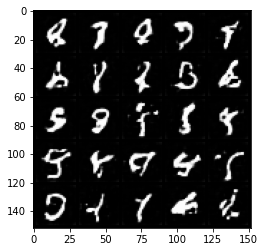

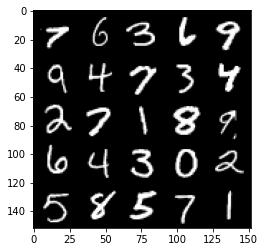

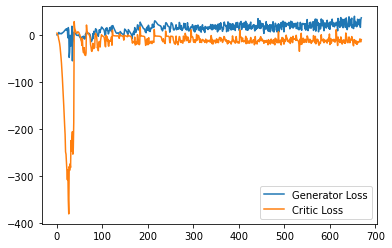

Step 13450: Generator loss: 30.425340557098387, critic loss: -13.56521017408371


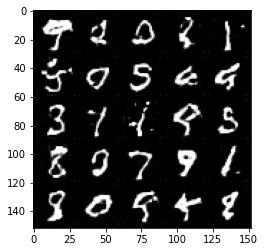

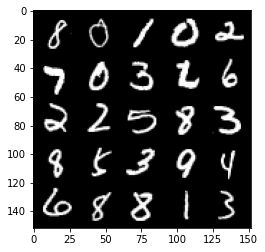

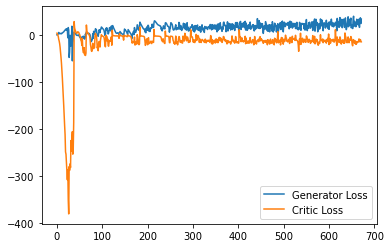

Step 13500: Generator loss: 30.44315164446831, critic loss: -15.836947267055512


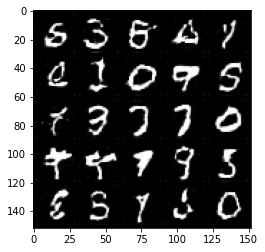

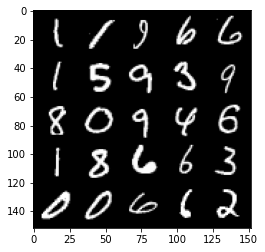

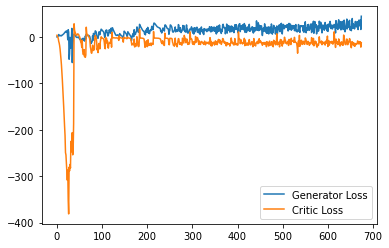

Step 13550: Generator loss: 26.409065685272218, critic loss: -10.524232202768326


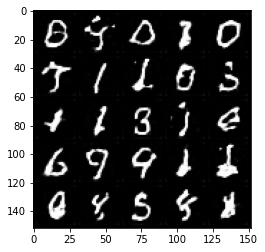

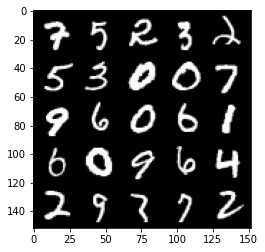

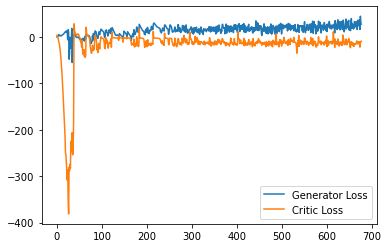

Step 13600: Generator loss: 33.37758825778961, critic loss: -12.487640687465666


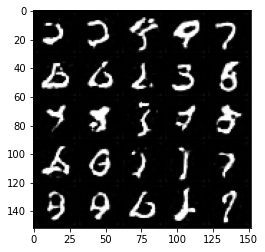

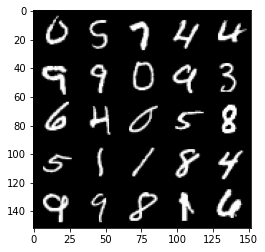

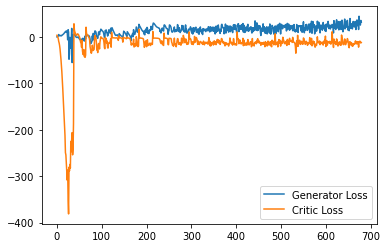

Step 13650: Generator loss: 28.409542996883392, critic loss: -6.5280718657970445


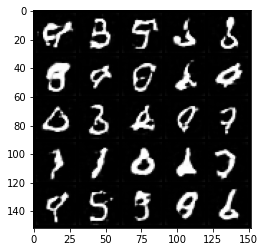

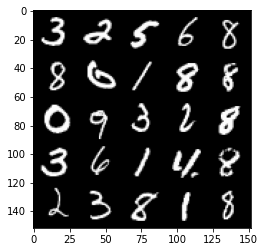

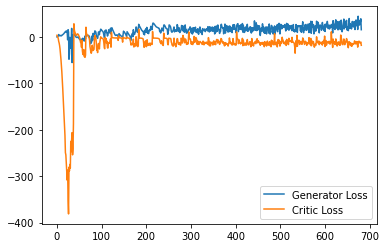

Step 13700: Generator loss: 22.212269399166107, critic loss: -11.362884878158571


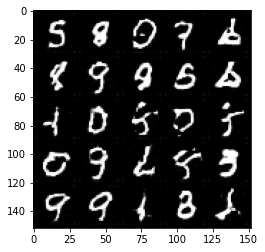

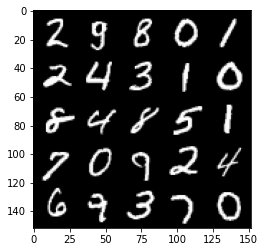

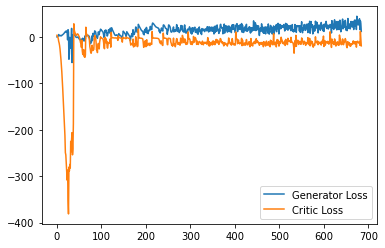

Step 13750: Generator loss: 26.878619570732116, critic loss: -12.335956958293917


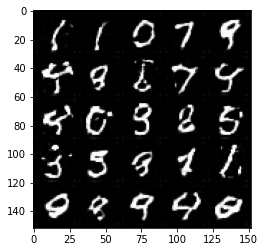

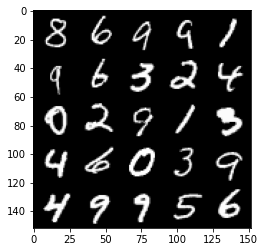

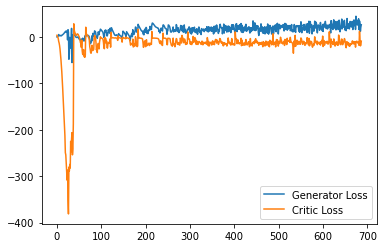

Step 13800: Generator loss: 30.782265051007272, critic loss: -10.54670633745193


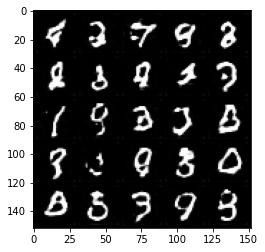

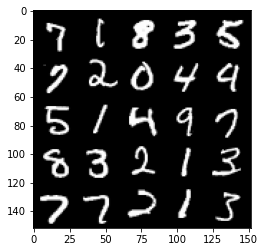

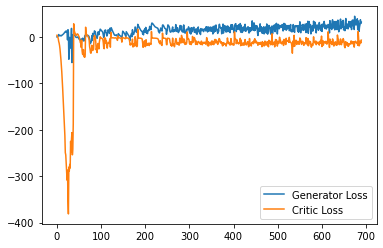

Step 13850: Generator loss: 25.668456214666367, critic loss: -16.36765025663376


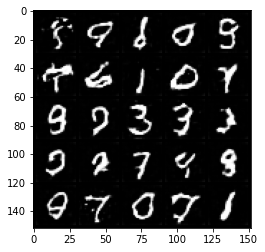

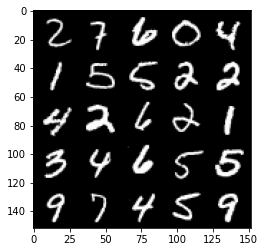

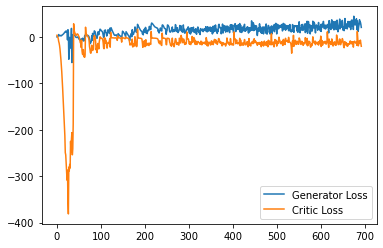

Step 13900: Generator loss: 30.853860872983933, critic loss: -10.001121312618256


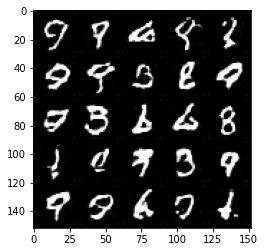

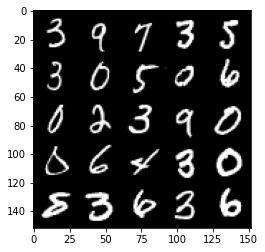

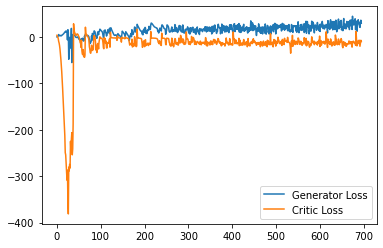

Step 13950: Generator loss: 33.15366632461548, critic loss: -11.564320137500763


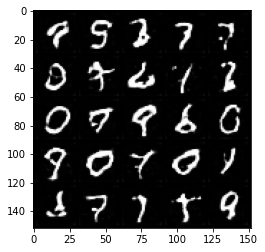

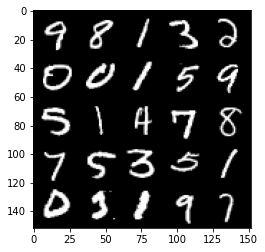

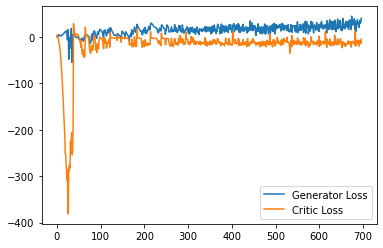

Step 14000: Generator loss: 33.493707575798034, critic loss: -7.806052047252657


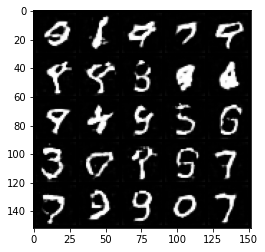

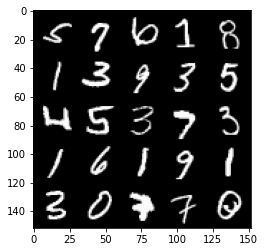

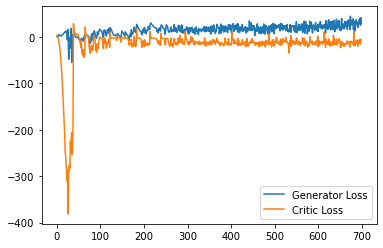

Step 14050: Generator loss: 28.070036664009095, critic loss: -14.095165397167204


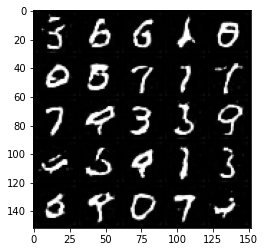

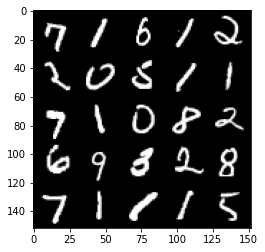

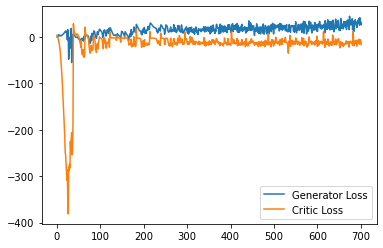

Step 14100: Generator loss: 38.48179549217224, critic loss: -14.534039821147921


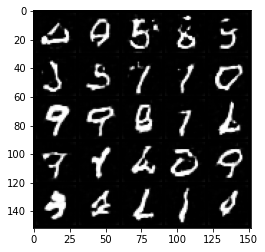

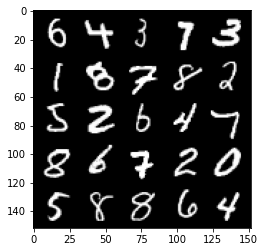

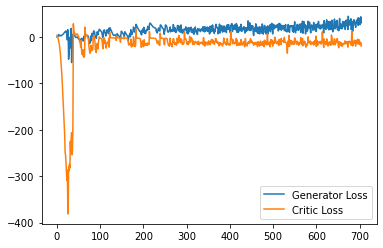

Step 14150: Generator loss: 34.97017175078392, critic loss: -12.237858672142027


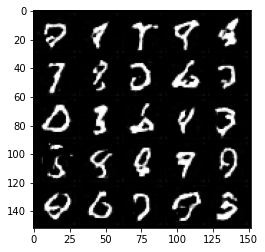

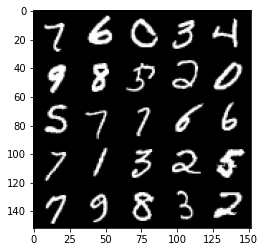

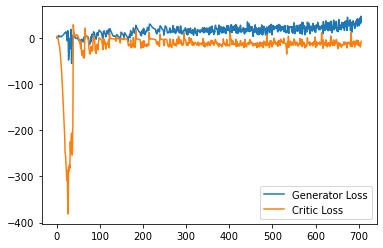

Step 14200: Generator loss: 30.794527009129524, critic loss: -12.43969437980652


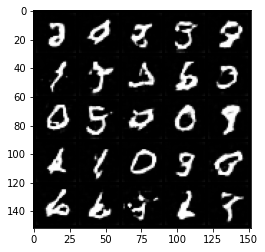

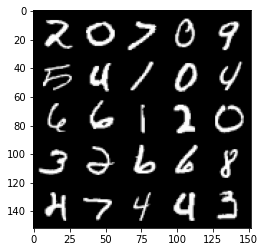

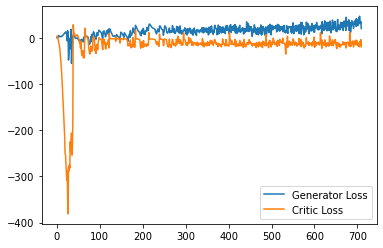

Step 14250: Generator loss: 31.004407069683076, critic loss: -13.148938550353046


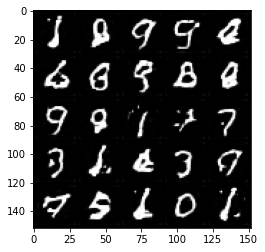

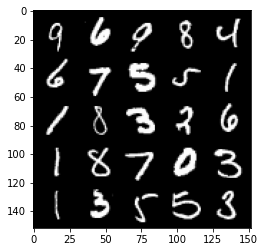

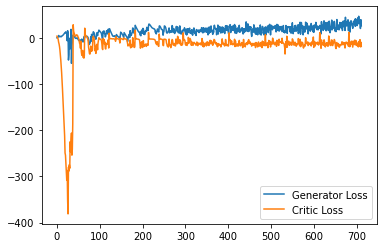

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1


In [ ]:
!pip freeze